# Germinal center:  
---
This notebook is based on the code from "https://github.com/GVS-Lab/germinal_center/" by Daniel Paysan and Saradha Venkatachalapathy (2023) 

## Part1: Dataset generation


Data DeepMel 2X1 slide: 
ROIs from this slide with respect to TLS location, stained for DAPI, CD3 and CD20. 

Aims:

The first step is to generate the dataset that we will use for downstream modelling and analysis. 

1. preprocess the images such that we have 8bit tiff files
2. perform nuclear segmentation using pretrained stardist model
3. measure nuclear morphology and chromatin organization features (chrommetrics) of each nucleus
4. identify cell boundary by expanding the nuclear border
5. measure cellular levels of each protein 
6. measure the spatial location of each nucleus in an image


In [ ]:
import os
cwd=os.getcwd()
print(cwd)

### Setting up the environment 

Read in the libraries and the set up the paths

In [1]:
# import libraries
import sys

sys.path.append("../..")

from pathlib import Path
from glob import glob
import pandas as pd
import os
from tqdm.notebook import tqdm

from src.batch.nuclear_segmentation import segment_objects_stardist2d
from src.batch.extract_features import (
    extract_nmco_feats_batch,
    measure_intensity_batch,
    extract_spatial_coordinates_batch,
)
from src.batch.cell_segmentation import cell_seg_dilation_batch
from src.utils.preprocess_images import (
    extract_channel_save_image,
    quantile_normalize_and_save_images,
)
from src.utils.cell_type_detection import assign_cell_status
from src.utils.data_viz import visualize_segmentation_results


# libraries from dataset3 notebook data_preprocessing
from src.utils.base import get_file_list

import numpy as np
from skimage.io import imread
from skimage.color import label2rgb
import matplotlib.pyplot as plt

import copy
import tifffile

#%load_ext nb_black

2025-01-17 18:45:47.379614: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-01-17 18:45:47.381743: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2025-01-17 18:45:47.381751: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [2]:
# Set up directories
root_dir = "../../DeepMel_data/stitched"
merged_image_dir = os.path.join(root_dir, "Merged")
#gc_mask_dir = os.path.join(root_dir, "mask")

#merged_image_dir = os.path.join(root_dir, "merged") #input raw image
analysis_dir = os.path.join(root_dir, "DeepMel_2X1_ROI2.4.5.6.7_InOutTLS_feature_generation_notebook_Results_20250117")

# The stitched 32-bit images have reverse index for channels
dapi_image_dir = os.path.join(analysis_dir, "dapi_raw")
cd3_image_dir = os.path.join(analysis_dir, "cd3_raw")
cd20_image_dir = os.path.join(analysis_dir, "cd20_raw")

scaled_dapi_image_dir = os.path.join(analysis_dir, "dapi_scaled")
scaled_cd3_image_dir = os.path.join(analysis_dir, "cd3_scaled")
scaled_cd20_image_dir = os.path.join(analysis_dir, "cd20_scaled")

segmented_nuclei_dir = os.path.join(analysis_dir, "segmented_nucleus")
nuclei_rois_dir = os.path.join(analysis_dir, "segmented_nuclei_ijroi")
nuclear_features_dir = os.path.join(analysis_dir, "chrometric_features")
segmented_cells_dir = os.path.join(analysis_dir, "segmented_cells")

raw_dapi_levels_dir = os.path.join(analysis_dir, "dapi_rawlevel")
raw_cd3_levels_dir = os.path.join(analysis_dir, "cd3_rawlevel")
raw_cd20_levels_dir = os.path.join(analysis_dir, "cd20_rawlevel")

cellular_cd3_levels_dir = os.path.join(analysis_dir, "cd3_scaledlevel")
cellular_cd20_levels_dir = os.path.join(analysis_dir, "cd20_scaledlevel")
cellular_sox10_levels_dir = os.path.join(analysis_dir, "sox10_scaledlevel")

germinal_center_loc_dir = os.path.join(analysis_dir, "position_wrt_germinal_center")

spatial_cordiates_dir = os.path.join(analysis_dir, "spatial_cordiates")
consolidated_features_dir = os.path.join(analysis_dir, "consolidated_features")



### Compute features

We process the channels, segment nuclei using a pretrained stardist model, extract nmco features and segment cells by expanding nuclear boundary and then measure cellular levels of CD3, CD20 and location within the germinal center. 

In [ ]:
# NOT RUN !!!
# Preprocess the 8-bit Fiji-extracted 3-channel image to single channel tiff
print("Preprocessing image to make single channel tiff images......")
extract_channel_save_image(merged_image_dir, dapi_image_dir, 2) # index 2
extract_channel_save_image(merged_image_dir, cd3_image_dir, 1) # index 1
extract_channel_save_image(merged_image_dir, cd20_image_dir, 0) # index 0


In [ ]:
# Then, in Fiji, change each channel of DAPI, CD3 & CD20 to 8bit after AUTO brightness/contrast
#and merge them to 1 multichannel image.

In [ ]:
# Run below 3 code chunks to extract only DAPI channel, then quantile-normalize & scale it to 8bit.

In [3]:

# Extract DAPI channel from stitched 8bit images
img_locs = get_file_list(merged_image_dir)
file_names = []
dapi_imgs = []
cd3_imgs = []
cd20_imgs = []

for loc in img_locs:
    file_name = os.path.split(loc)[1]
    file_name = file_name[: file_name.index(".")]
    file_names.append(file_name)
    img = imread(loc)
    dapi_img = img[:, :, 2]
    dapi_imgs.append(imread(loc)[:, :, 2])
    cd3_img = img[:, :, 1]
    cd3_imgs.append(imread(loc)[:, :, 1])
    cd20_img = img[:, :, 0]
    cd20_imgs.append(imread(loc)[:, :, 0])   
    
# MemoryError: Unable to allocate 108. GiB for an array with shape (1, 1, 73904, 49253, 8) 
#and data type float32 (This is for 2X1_ROI0.stitched.ome.tif of size 22Gb)


In [4]:
# Quantile-normalize DAPI image & scale it to 8bit
scaled_dapi_imgs = []
for dapi_img in dapi_imgs:
    # Scale to 8bit each image in cropped region
    masked_dapi_img = np.ma.array(dapi_img, mask=~(dapi_img > 0)).astype(float)
    min_masked_dapi_img = np.quantile(masked_dapi_img, 0.01)
    max_masked_dapi_img = np.quantile(masked_dapi_img, 0.998)
    masked_dapi_img = (masked_dapi_img - min_masked_dapi_img) / (
        max_masked_dapi_img - min_masked_dapi_img
    )
    scaled_dapi_img = masked_dapi_img.filled(fill_value=0)
    scaled_dapi_img = np.clip(scaled_dapi_img * 255, 0, 255).astype(np.uint8)
    scaled_dapi_imgs.append(scaled_dapi_img)


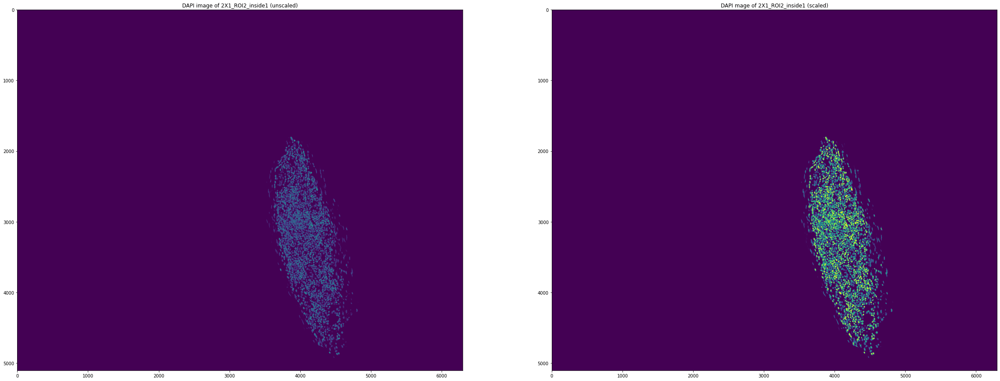

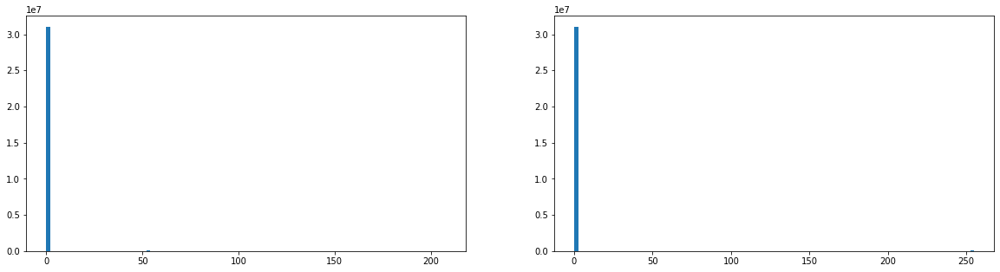

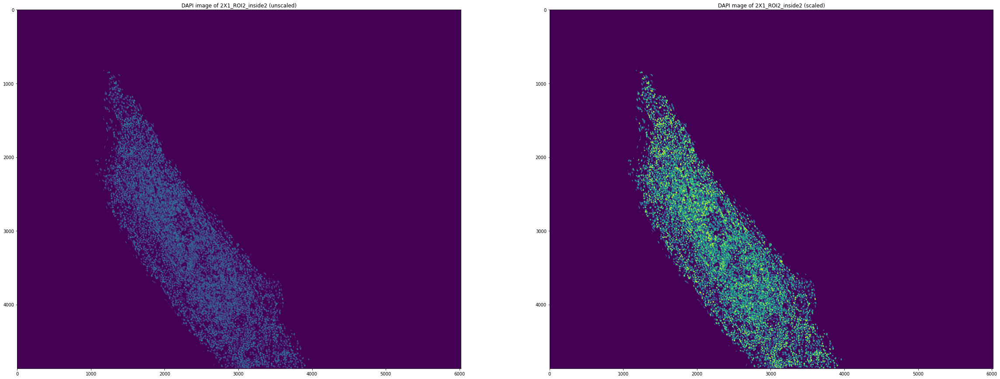

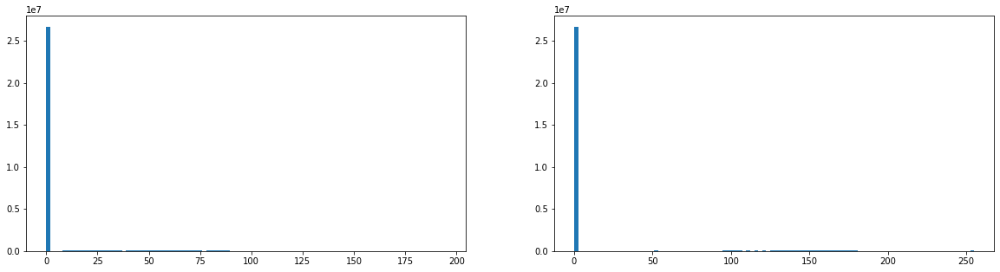

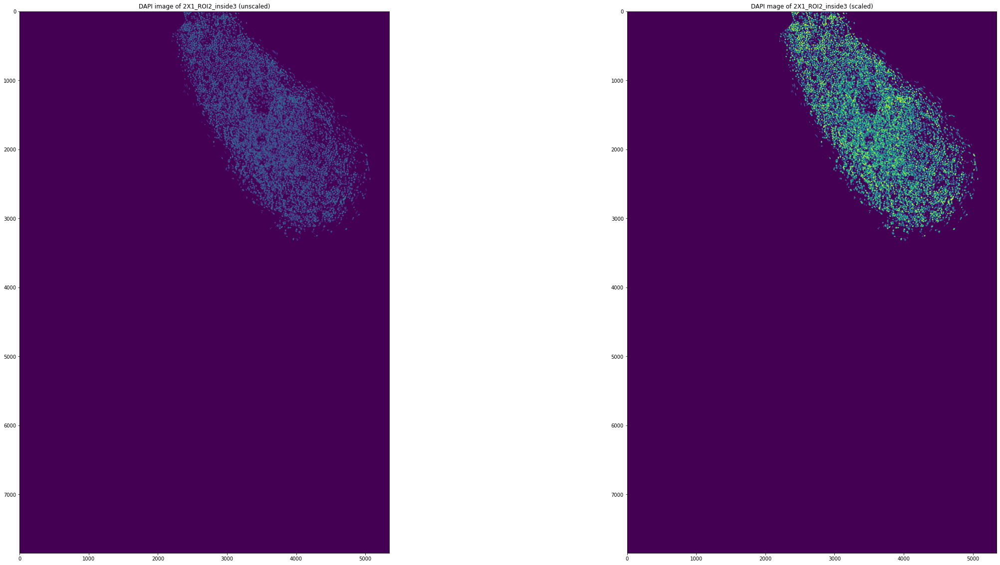

...

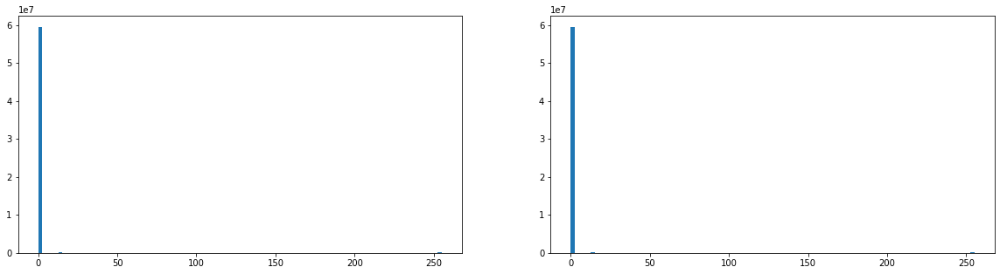

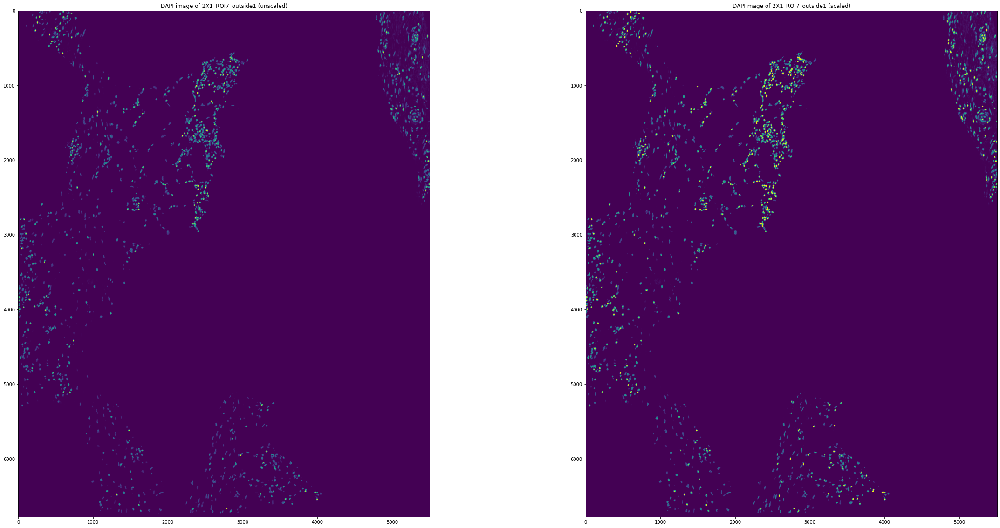

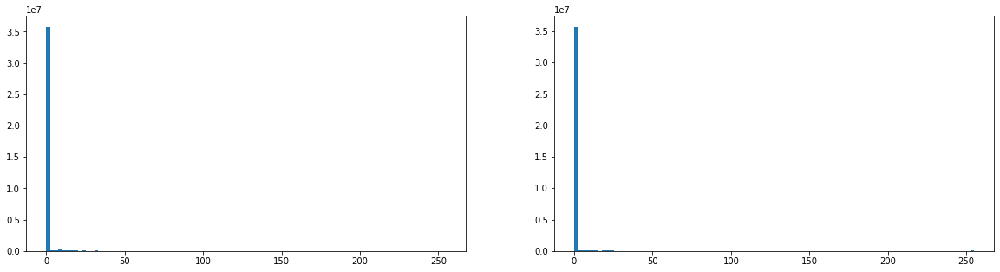

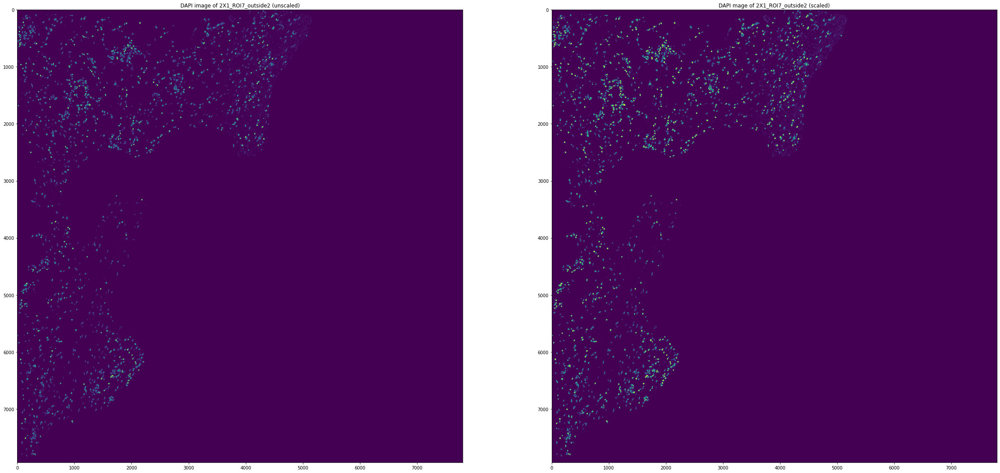

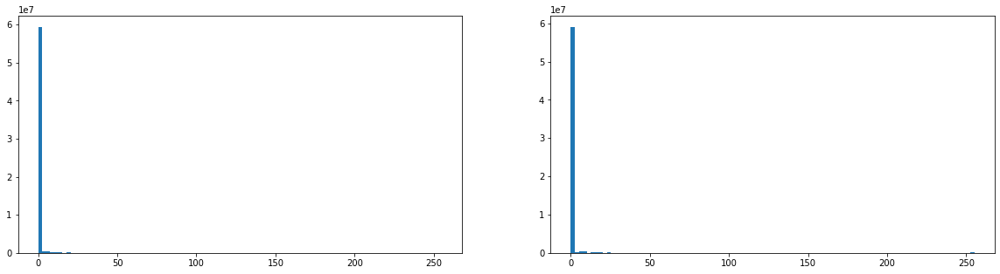

In [5]:
# Visualized raw & normalized scaled DAPI images
for i in range(len(dapi_imgs)):
    fig, ax = plt.subplots(figsize=[40, 20], ncols=2)
    ax = ax.flatten()
    ax[0].imshow(dapi_imgs[i], vmin=0, vmax=255)
    ax[0].set_title("DAPI image of {} (unscaled)".format(file_names[i]))
    ax[1].imshow(scaled_dapi_imgs[i], vmin=0, vmax=255)
    ax[1].set_title("DAPI mage of {} (scaled)".format(file_names[i]))
    plt.show()
    plt.close()

    fig, ax = plt.subplots(figsize=[20, 5], ncols=2)
    ax = ax.flatten()
    ax[0].hist(dapi_imgs[i].ravel(), bins=100)
    ax[1].hist(scaled_dapi_imgs[i].ravel(), bins=100)
    plt.show()
    plt.close()

In [6]:
# Quantile-normalize CD3 image & scale it to 8bit
scaled_cd3_imgs = []
for cd3_img in cd3_imgs:
    # Scale to 8bit each image in cropped region
    masked_cd3_img = np.ma.array(cd3_img, mask=~(cd3_img > 0)).astype(float)
    min_masked_cd3_img = np.quantile(masked_cd3_img, 0.01)
    max_masked_cd3_img = np.quantile(masked_cd3_img, 0.998)
    masked_cd3_img = (masked_cd3_img - min_masked_cd3_img) / (
        max_masked_cd3_img - min_masked_cd3_img
    )
    scaled_cd3_img = masked_cd3_img.filled(fill_value=0)
    scaled_cd3_img = np.clip(scaled_cd3_img * 255, 0, 255).astype(np.uint8)
    scaled_cd3_imgs.append(scaled_cd3_img)


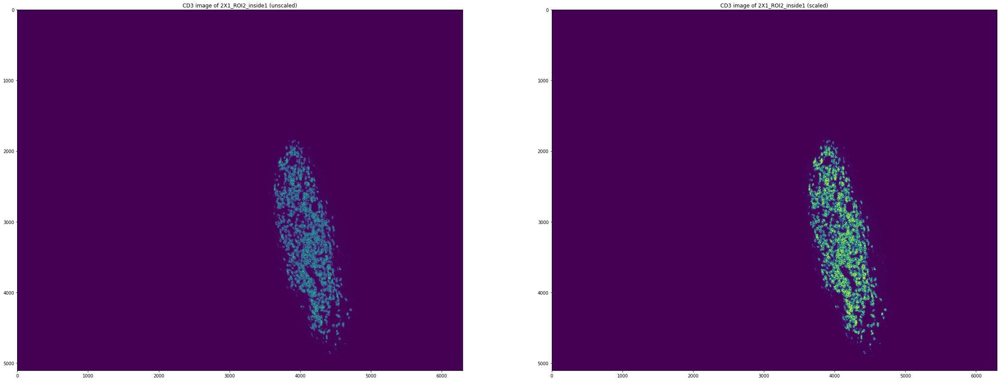

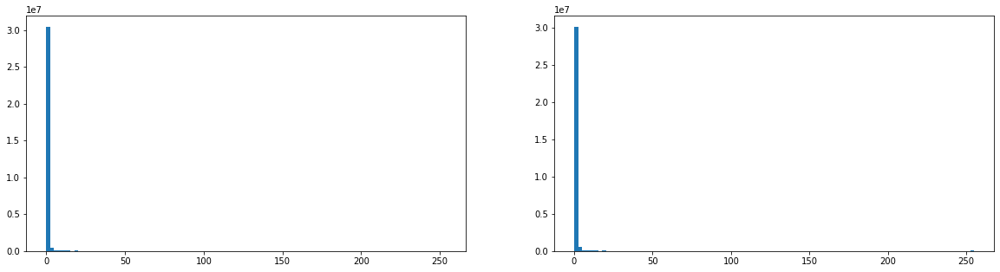

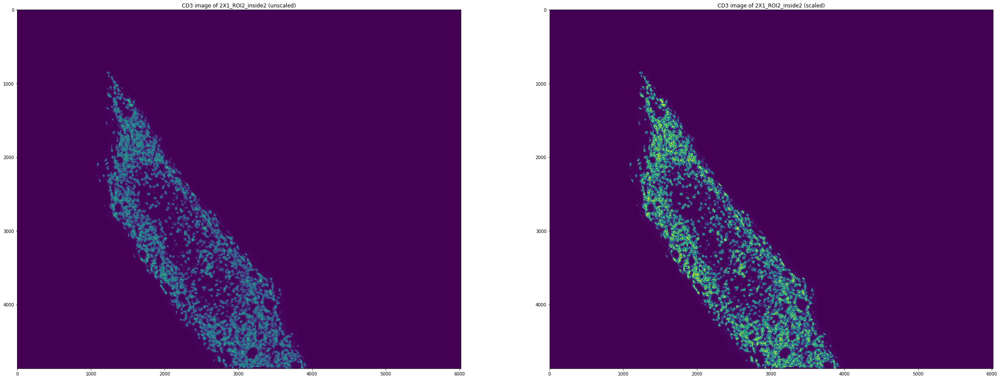

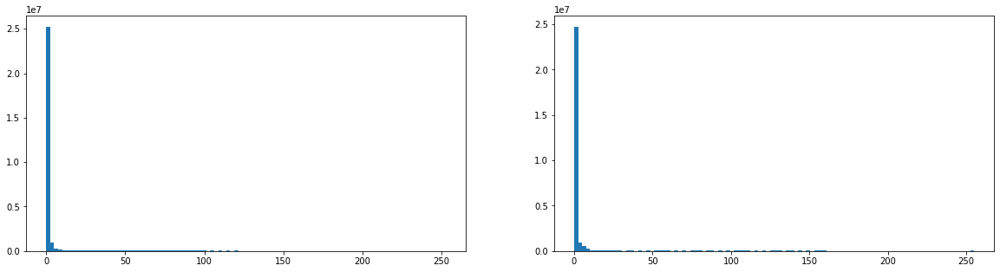

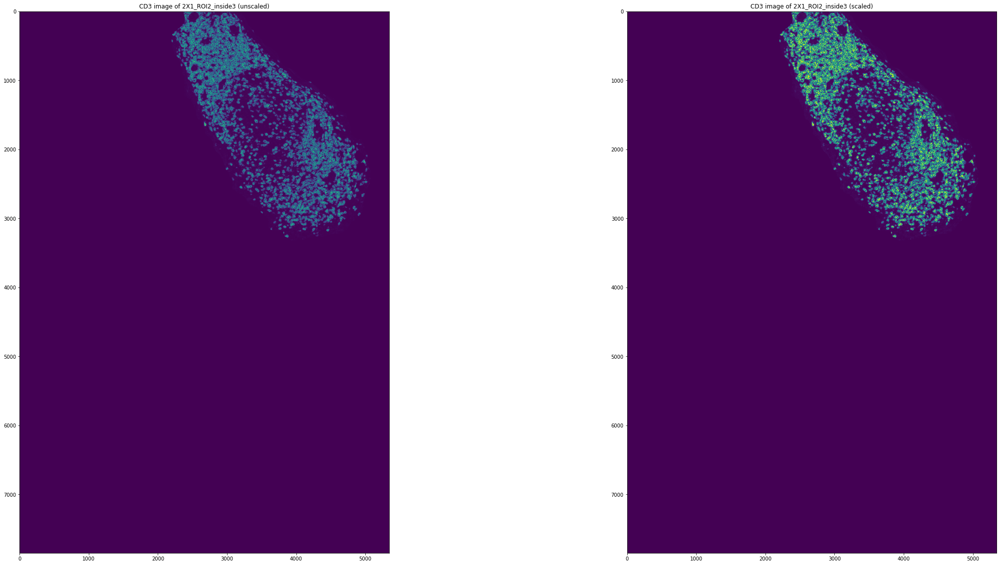

...

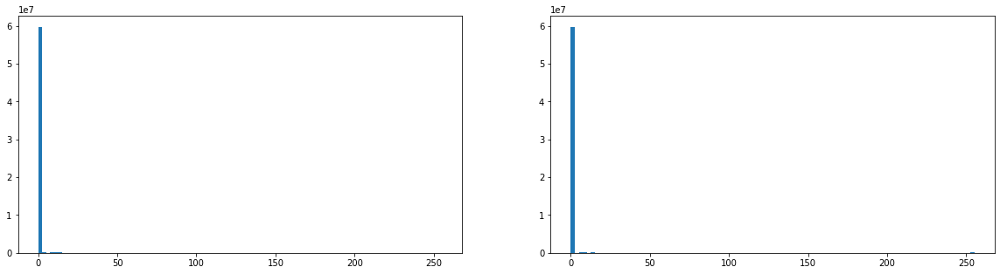

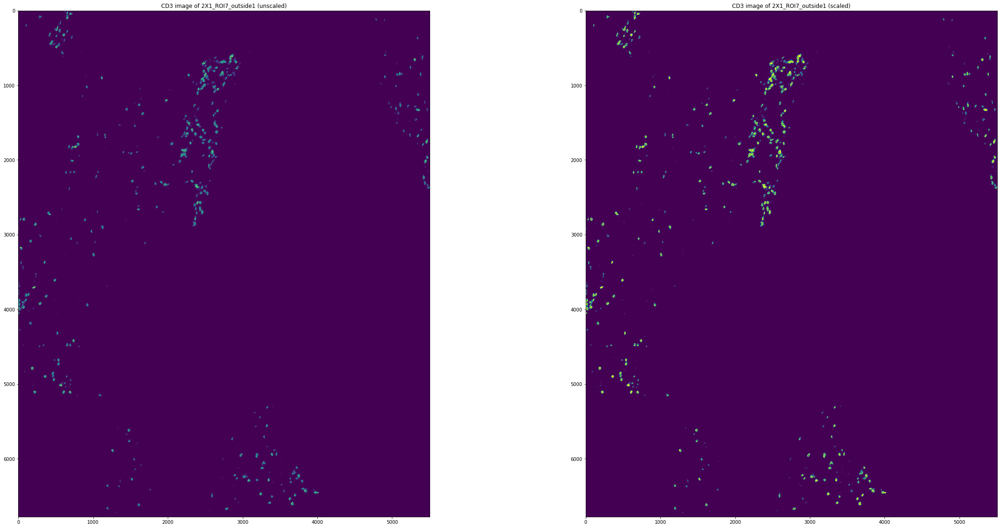

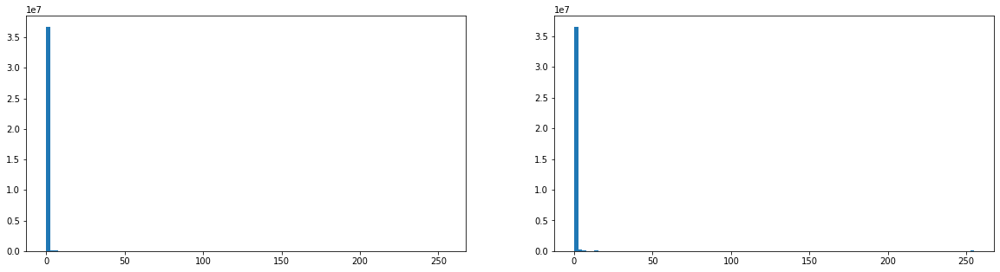

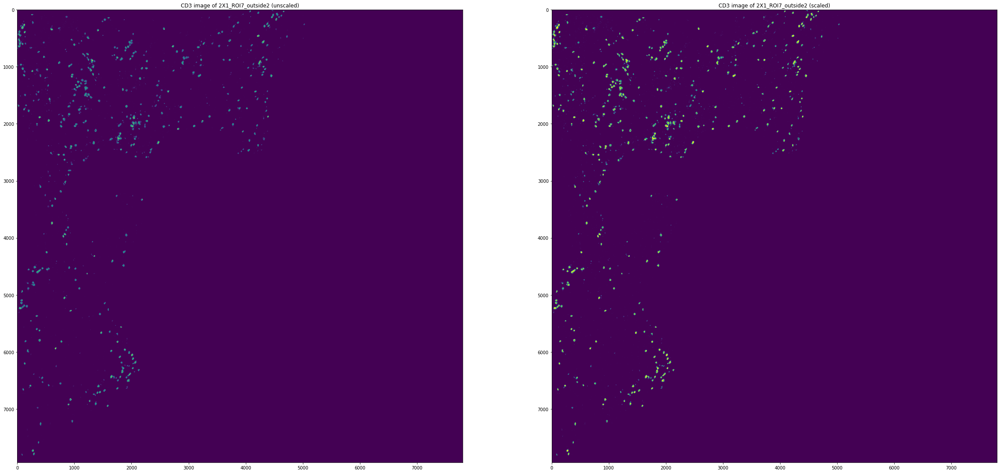

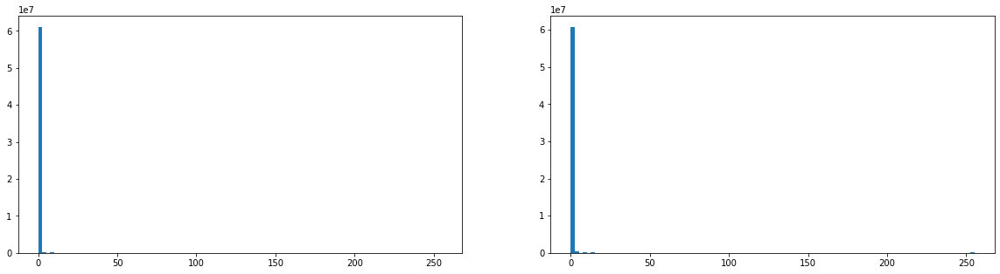

In [7]:
# Visualized raw & normalized scaled CD3 images

for i in range(len(cd3_imgs)):
    fig, ax = plt.subplots(figsize=[40, 20], ncols=2)
    ax = ax.flatten()
    ax[0].imshow(cd3_imgs[i], vmin=0, vmax=255)
    ax[0].set_title("CD3 image of {} (unscaled)".format(file_names[i]))
    ax[1].imshow(scaled_cd3_imgs[i], vmin=0, vmax=255)
    ax[1].set_title("CD3 image of {} (scaled)".format(file_names[i]))
    plt.show()
    plt.close()

    fig, ax = plt.subplots(figsize=[20, 5], ncols=2)
    ax = ax.flatten()
    ax[0].hist(cd3_imgs[i].ravel(), bins=100)
    ax[1].hist(scaled_cd3_imgs[i].ravel(), bins=100)
    plt.show()
    plt.close()

In [8]:
# Quantile-normalize CD20 image & scale it to 8bit
scaled_cd20_imgs = []
for cd20_img in cd20_imgs:
    # Scale to 8bit each image in cropped region
    masked_cd20_img = np.ma.array(cd20_img, mask=~(cd20_img > 0)).astype(float)
    min_masked_cd20_img = np.quantile(masked_cd20_img, 0.01)
    max_masked_cd20_img = np.quantile(masked_cd20_img, 0.998)
    masked_cd20_img = (masked_cd20_img - min_masked_cd20_img) / (
        max_masked_cd20_img - min_masked_cd20_img
    )
    scaled_cd20_img = masked_cd20_img.filled(fill_value=0)
    scaled_cd20_img = np.clip(scaled_cd20_img * 255, 0, 255).astype(np.uint8)
    scaled_cd20_imgs.append(scaled_cd20_img)
    

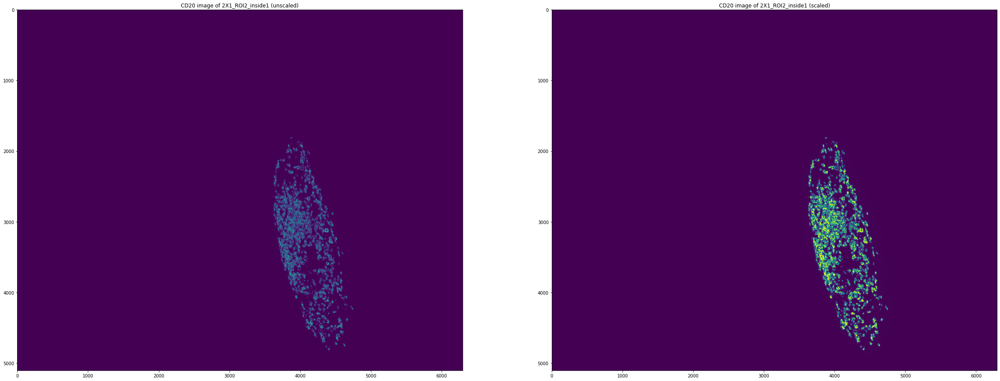

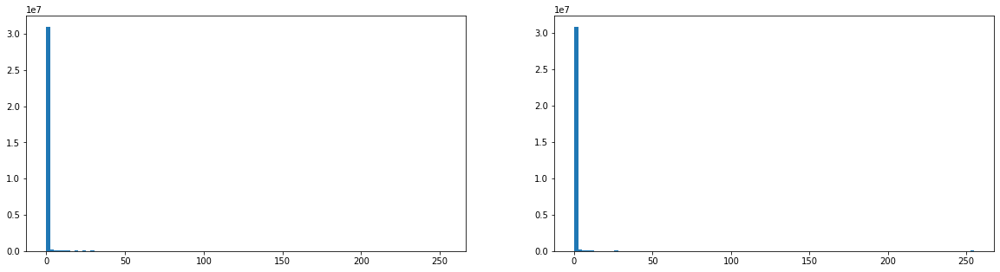

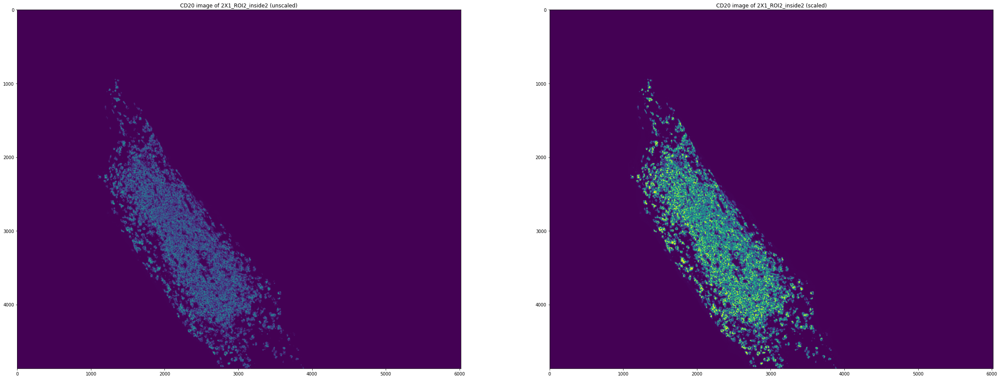

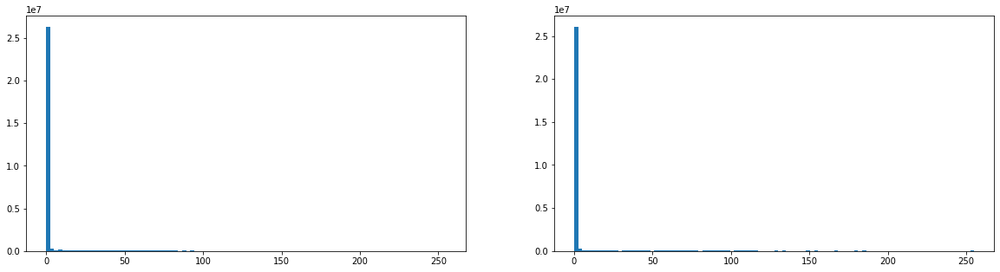

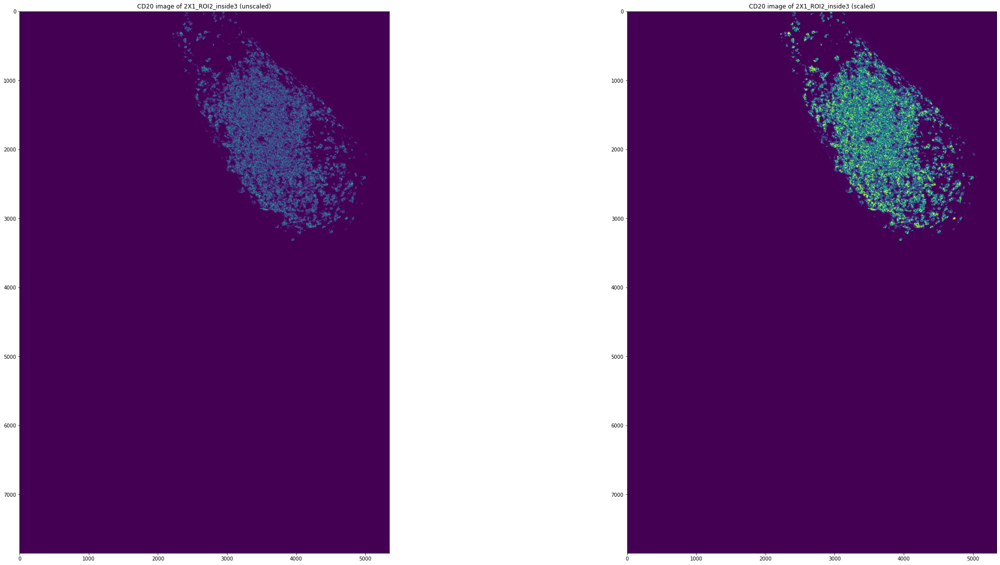

...

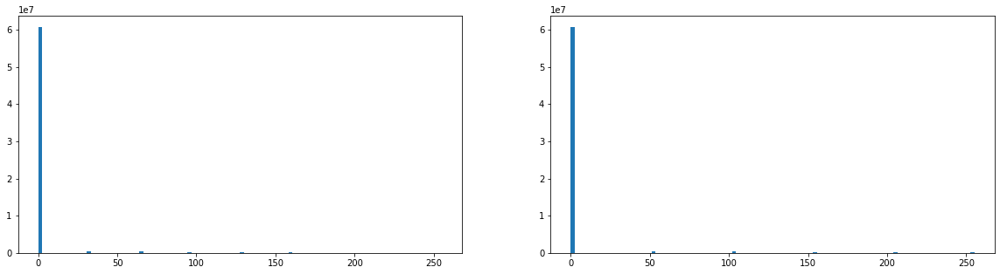

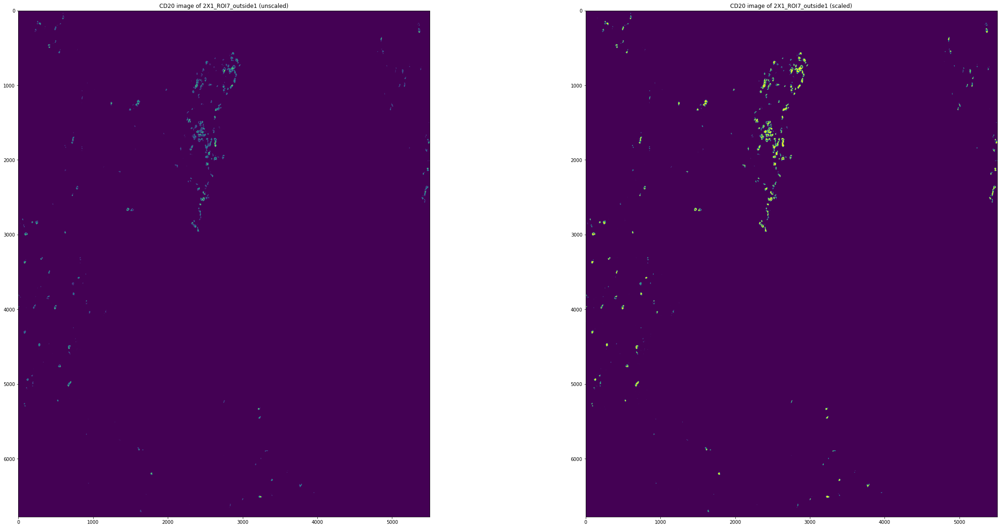

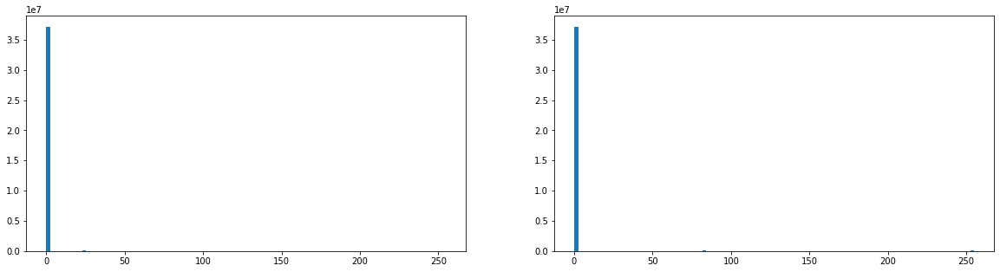

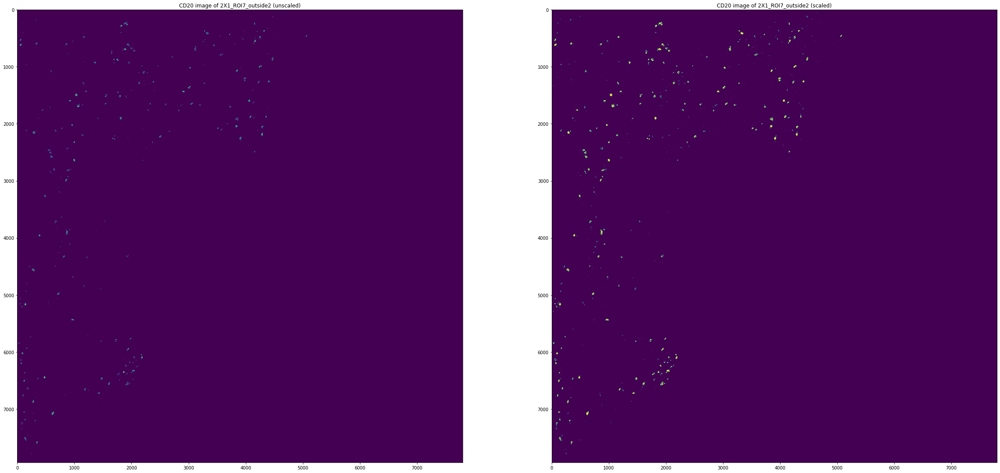

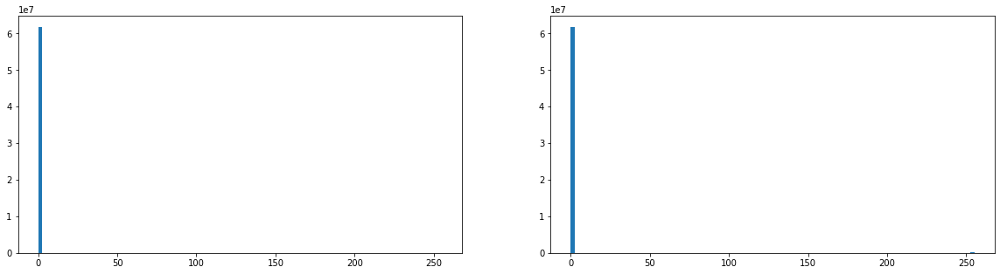

In [9]:
# Visualized raw & normalized scaled CD20 images
for i in range(len(cd20_imgs)):
    fig, ax = plt.subplots(figsize=[40, 20], ncols=2)
    ax = ax.flatten()
    ax[0].imshow(cd20_imgs[i], vmin=0, vmax=255)
    ax[0].set_title("CD20 image of {} (unscaled)".format(file_names[i]))
    ax[1].imshow(scaled_cd20_imgs[i], vmin=0, vmax=255)
    ax[1].set_title("CD20 image of {} (scaled)".format(file_names[i]))
    plt.show()
    plt.close()

    fig, ax = plt.subplots(figsize=[20, 5], ncols=2)
    ax = ax.flatten()
    ax[0].hist(cd20_imgs[i].ravel(), bins=100)
    ax[1].hist(scaled_cd20_imgs[i].ravel(), bins=100)
    plt.show()
    plt.close()

In [10]:

# Save raw images
os.makedirs(dapi_image_dir, exist_ok=True)
for i in range(len(dapi_imgs)):
    img = dapi_imgs[i]
    tifffile.imsave(os.path.join(dapi_image_dir, file_names[i]) + ".tif", img)
    
os.makedirs(cd3_image_dir, exist_ok=True)
for i in range(len(cd3_imgs)):
    img = cd3_imgs[i]
    tifffile.imsave(os.path.join(cd3_image_dir, file_names[i]) + ".tif", img)
    
os.makedirs(cd20_image_dir, exist_ok=True)
for i in range(len(cd20_imgs)):
    img = scaled_cd20_imgs[i]
    tifffile.imsave(os.path.join(cd20_image_dir, file_names[i]) + ".tif", img)
    

In [11]:

# Save normalized & scaled images
os.makedirs(scaled_dapi_image_dir, exist_ok=True)
for i in range(len(scaled_dapi_imgs)):
    img = scaled_dapi_imgs[i]
    tifffile.imsave(os.path.join(scaled_dapi_image_dir, file_names[i]) + ".tif", img)
    
os.makedirs(scaled_cd3_image_dir, exist_ok=True)
for i in range(len(scaled_cd3_imgs)):
    img = scaled_cd3_imgs[i]
    tifffile.imsave(os.path.join(scaled_cd3_image_dir, file_names[i]) + ".tif", img)
    
os.makedirs(scaled_cd20_image_dir, exist_ok=True)
for i in range(len(scaled_cd20_imgs)):
    img = scaled_cd20_imgs[i]
    tifffile.imsave(os.path.join(scaled_cd20_image_dir, file_names[i]) + ".tif", img)
    

In [ ]:
# NOT RUN !!!

# Run this only if already have the gc mask!!!

# quantile normalize dapi images
quantile_normalize_and_save_images(dapi_image_dir, scaled_dapi_image_dir, mask_dir=gc_mask_dir,  quantiles=[0.01, 0.998])


In [12]:
# perform nuclear segmentation for only normalized scaled DAPI images
print('Nuclear segmentation........')
segment_objects_stardist2d(image_dir = scaled_dapi_image_dir +'/',
                           output_dir_labels = segmented_nuclei_dir+'/',
                           output_dir_ijroi = nuclei_rois_dir+'/',
                           use_pretrained = True,
                           prob_thresh=0.43)
                           #normalize_quants=[1, 99.8])


Nuclear segmentation........
Found model '2D_versatile_fluo' for 'StarDist2D'.


2025-01-17 12:52:17.058838: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2025-01-17 12:52:17.061195: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2025-01-17 12:52:17.061310: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublas.so.11'; dlerror: libcublas.so.11: cannot open shared object file: No such file or directory
2025-01-17 12:52:17.061342: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublasLt.so.11'; dlerror: libcublasLt.so.11: cannot open shared object file: No such file or directory
2025-01-17 12:52:17.061375: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Co

Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.
['../../DeepMel_data/stitched/DeepMel_2X1_ROI2.4.5.6.7_InOutTLS_feature_generation_notebook_Results_20250117/dapi_scaled/2X1_ROI2_inside1.tif', '../../DeepMel_data/stitched/DeepMel_2X1_ROI2.4.5.6.7_InOutTLS_feature_generation_notebook_Results_20250117/dapi_scaled/2X1_ROI2_inside2.tif', '../../DeepMel_data/stitched/DeepMel_2X1_ROI2.4.5.6.7_InOutTLS_feature_generation_notebook_Results_20250117/dapi_scaled/2X1_ROI2_inside3.tif', '../../DeepMel_data/stitched/DeepMel_2X1_ROI2.4.5.6.7_InOutTLS_feature_generation_notebook_Results_20250117/dapi_scaled/2X1_ROI2_outside1.tif', '../../DeepMel_data/stitched/DeepMel_2X1_ROI2.4.5.6.7_InOutTLS_feature_generation_notebook_Results_20250117/dapi_scaled/2X1_ROI2_outside2.tif', '../../DeepMel_data/stitched/DeepMel_2X1_ROI2.4.5.6.7_InOutTLS_feature_generation_notebook_Results_20250117/dapi_scaled/2X1_ROI2_ou


  0%|                                                                                      | 0/72 [00:00<?, ?it/s]

1/1 [==============================] - 0s 486ms/step



  1%|█                                                                             | 1/72 [00:00<00:38,  1.86it/s]

1/1 [==============================] - 0s 289ms/step



  3%|██▏                                                                           | 2/72 [00:00<00:31,  2.22it/s]

1/1 [==============================] - 0s 322ms/step



  4%|███▎                                                                          | 3/72 [00:01<00:41,  1.65it/s]

1/1 [==============================] - 0s 393ms/step



  6%|████▎                                                                         | 4/72 [00:02<00:36,  1.84it/s]

1/1 [==============================] - 0s 352ms/step



  7%|█████▍                                                                        | 5/72 [00:02<00:33,  2.01it/s]

1/1 [==============================] - 0s 380ms/step



  8%|██████▌                                                                       | 6/72 [00:03<00:38,  1.72it/s]

1/1 [==============================] - 0s 337ms/step



 10%|███████▌                                                                      | 7/72 [00:03<00:34,  1.86it/s]

1/1 [==============================] - 0s 376ms/step



 11%|████████▋                                                                     | 8/72 [00:04<00:33,  1.93it/s]

1/1 [==============================] - 0s 471ms/step



 12%|█████████▊                                                                    | 9/72 [00:05<00:39,  1.61it/s]

1/1 [==============================] - 0s 334ms/step



 14%|██████████▋                                                                  | 10/72 [00:05<00:35,  1.76it/s]

1/1 [==============================] - 0s 328ms/step



 15%|███████████▊                                                                 | 11/72 [00:05<00:31,  1.96it/s]

1/1 [==============================] - 0s 347ms/step



 17%|████████████▊                                                                | 12/72 [00:06<00:28,  2.11it/s]

1/1 [==============================] - 0s 282ms/step



 18%|█████████████▉                                                               | 13/72 [00:06<00:25,  2.28it/s]

1/1 [==============================] - 0s 380ms/step



 19%|██████████████▉                                                              | 14/72 [00:07<00:25,  2.29it/s]

1/1 [==============================] - 0s 339ms/step



 21%|████████████████                                                             | 15/72 [00:07<00:29,  1.95it/s]

1/1 [==============================] - 0s 402ms/step



 22%|█████████████████                                                            | 16/72 [00:08<00:28,  2.00it/s]

1/1 [==============================] - 0s 463ms/step



 24%|██████████████████▏                                                          | 17/72 [00:08<00:28,  1.96it/s]

1/1 [==============================] - 0s 362ms/step



 25%|███████████████████▎                                                         | 18/72 [00:09<00:31,  1.73it/s]

1/1 [==============================] - 0s 471ms/step



 26%|████████████████████▎                                                        | 19/72 [00:10<00:32,  1.63it/s]

1/1 [==============================] - 0s 336ms/step



 28%|█████████████████████▍                                                       | 20/72 [00:10<00:33,  1.54it/s]

1/1 [==============================] - 0s 309ms/step



 29%|██████████████████████▍                                                      | 21/72 [00:11<00:28,  1.77it/s]

1/1 [==============================] - 0s 371ms/step



 31%|███████████████████████▌                                                     | 22/72 [00:11<00:26,  1.89it/s]

1/1 [==============================] - 0s 346ms/step



 32%|████████████████████████▌                                                    | 23/72 [00:12<00:28,  1.73it/s]

1/1 [==============================] - 0s 306ms/step



 33%|█████████████████████████▋                                                   | 24/72 [00:12<00:25,  1.92it/s]

1/1 [==============================] - 0s 421ms/step



 35%|██████████████████████████▋                                                  | 25/72 [00:13<00:24,  1.90it/s]

1/1 [==============================] - 0s 478ms/step



 36%|███████████████████████████▊                                                 | 26/72 [00:13<00:24,  1.87it/s]

1/1 [==============================] - 1s 752ms/step



 38%|████████████████████████████▉                                                | 27/72 [00:14<00:27,  1.62it/s]

1/1 [==============================] - 1s 518ms/step



 39%|█████████████████████████████▉                                               | 28/72 [00:15<00:26,  1.64it/s]

1/1 [==============================] - 0s 374ms/step



 40%|███████████████████████████████                                              | 29/72 [00:16<00:27,  1.58it/s]

1/1 [==============================] - 0s 445ms/step



 42%|████████████████████████████████                                             | 30/72 [00:16<00:25,  1.66it/s]

1/1 [==============================] - 1s 651ms/step



 43%|█████████████████████████████████▏                                           | 31/72 [00:17<00:33,  1.22it/s]

1/1 [==============================] - 1s 600ms/step



 44%|██████████████████████████████████▏                                          | 32/72 [00:18<00:31,  1.28it/s]

1/1 [==============================] - 0s 490ms/step



 46%|███████████████████████████████████▎                                         | 33/72 [00:19<00:28,  1.38it/s]

1/1 [==============================] - 0s 403ms/step



 47%|████████████████████████████████████▎                                        | 34/72 [00:19<00:28,  1.35it/s]

1/1 [==============================] - 0s 439ms/step



 49%|█████████████████████████████████████▍                                       | 35/72 [00:20<00:25,  1.46it/s]

1/1 [==============================] - 0s 488ms/step



 50%|██████████████████████████████████████▌                                      | 36/72 [00:21<00:24,  1.44it/s]

1/1 [==============================] - 0s 440ms/step



 51%|███████████████████████████████████████▌                                     | 37/72 [00:21<00:24,  1.43it/s]

1/1 [==============================] - 0s 463ms/step



 53%|████████████████████████████████████████▋                                    | 38/72 [00:22<00:23,  1.43it/s]

1/1 [==============================] - 0s 337ms/step



 54%|█████████████████████████████████████████▋                                   | 39/72 [00:23<00:23,  1.42it/s]

1/1 [==============================] - 0s 375ms/step



 56%|██████████████████████████████████████████▊                                  | 40/72 [00:23<00:20,  1.60it/s]

1/1 [==============================] - 0s 460ms/step



 57%|███████████████████████████████████████████▊                                 | 41/72 [00:24<00:20,  1.54it/s]

1/1 [==============================] - 0s 405ms/step



 58%|████████████████████████████████████████████▉                                | 42/72 [00:25<00:19,  1.51it/s]

1/1 [==============================] - 0s 374ms/step



 60%|█████████████████████████████████████████████▉                               | 43/72 [00:25<00:19,  1.46it/s]

1/1 [==============================] - 0s 346ms/step



 61%|███████████████████████████████████████████████                              | 44/72 [00:26<00:17,  1.60it/s]

1/1 [==============================] - 0s 295ms/step



 62%|████████████████████████████████████████████████▏                            | 45/72 [00:26<00:14,  1.83it/s]

1/1 [==============================] - 1s 531ms/step



 64%|█████████████████████████████████████████████████▏                           | 46/72 [00:27<00:15,  1.66it/s]

1/1 [==============================] - 0s 342ms/step



 65%|██████████████████████████████████████████████████▎                          | 47/72 [00:27<00:13,  1.79it/s]

1/1 [==============================] - 0s 356ms/step



 67%|███████████████████████████████████████████████████▎                         | 48/72 [00:28<00:12,  1.88it/s]

1/1 [==============================] - 0s 370ms/step



 68%|████████████████████████████████████████████████████▍                        | 49/72 [00:28<00:11,  2.00it/s]

1/1 [==============================] - 0s 330ms/step



 69%|█████████████████████████████████████████████████████▍                       | 50/72 [00:29<00:12,  1.79it/s]

1/1 [==============================] - 0s 395ms/step



 71%|██████████████████████████████████████████████████████▌                      | 51/72 [00:30<00:12,  1.66it/s]

1/1 [==============================] - 0s 356ms/step



 72%|███████████████████████████████████████████████████████▌                     | 52/72 [00:31<00:12,  1.55it/s]

1/1 [==============================] - 1s 556ms/step



 74%|████████████████████████████████████████████████████████▋                    | 53/72 [00:31<00:12,  1.56it/s]

1/1 [==============================] - 0s 289ms/step



 75%|█████████████████████████████████████████████████████████▊                   | 54/72 [00:32<00:10,  1.78it/s]

1/1 [==============================] - 0s 315ms/step



 76%|██████████████████████████████████████████████████████████▊                  | 55/72 [00:32<00:08,  1.97it/s]

1/1 [==============================] - 0s 396ms/step



 78%|███████████████████████████████████████████████████████████▉                 | 56/72 [00:32<00:07,  2.02it/s]

1/1 [==============================] - 1s 562ms/step



 79%|████████████████████████████████████████████████████████████▉                | 57/72 [00:33<00:08,  1.82it/s]

1/1 [==============================] - 0s 347ms/step



 81%|██████████████████████████████████████████████████████████████               | 58/72 [00:33<00:07,  1.97it/s]

1/1 [==============================] - 0s 332ms/step



 82%|███████████████████████████████████████████████████████████████              | 59/72 [00:34<00:06,  1.95it/s]

1/1 [==============================] - 0s 415ms/step



 83%|████████████████████████████████████████████████████████████████▏            | 60/72 [00:35<00:06,  1.86it/s]

1/1 [==============================] - 0s 331ms/step



 85%|█████████████████████████████████████████████████████████████████▏           | 61/72 [00:35<00:06,  1.71it/s]

1/1 [==============================] - 0s 292ms/step



 86%|██████████████████████████████████████████████████████████████████▎          | 62/72 [00:36<00:05,  1.90it/s]

1/1 [==============================] - 0s 349ms/step



 88%|███████████████████████████████████████████████████████████████████▍         | 63/72 [00:36<00:04,  2.02it/s]

1/1 [==============================] - 0s 474ms/step



 89%|████████████████████████████████████████████████████████████████████▍        | 64/72 [00:37<00:04,  1.76it/s]

1/1 [==============================] - 0s 470ms/step



 90%|█████████████████████████████████████████████████████████████████████▌       | 65/72 [00:37<00:03,  1.76it/s]

1/1 [==============================] - 0s 334ms/step



 92%|██████████████████████████████████████████████████████████████████████▌      | 66/72 [00:38<00:03,  1.95it/s]

1/1 [==============================] - 0s 261ms/step



 93%|███████████████████████████████████████████████████████████████████████▋     | 67/72 [00:38<00:02,  2.14it/s]

1/1 [==============================] - 0s 292ms/step



 94%|████████████████████████████████████████████████████████████████████████▋    | 68/72 [00:38<00:01,  2.32it/s]

1/1 [==============================] - 0s 313ms/step



 96%|█████████████████████████████████████████████████████████████████████████▊   | 69/72 [00:39<00:01,  2.35it/s]

1/1 [==============================] - 0s 283ms/step



 97%|██████████████████████████████████████████████████████████████████████████▊  | 70/72 [00:39<00:00,  2.45it/s]

1/1 [==============================] - 0s 370ms/step



 99%|███████████████████████████████████████████████████████████████████████████▉ | 71/72 [00:40<00:00,  2.33it/s]

1/1 [==============================] - 0s 482ms/step


  0%|                                                                                      | 0/63 [00:00<?, ?it/s]

1/1 [==============================] - 0s 225ms/step



  2%|█▏                                                                            | 1/63 [00:00<00:18,  3.41it/s]

1/1 [==============================] - 0s 223ms/step



  3%|██▍                                                                           | 2/63 [00:00<00:17,  3.58it/s]

1/1 [==============================] - 0s 234ms/step



  5%|███▋                                                                          | 3/63 [00:00<00:16,  3.60it/s]

1/1 [==============================] - 0s 271ms/step



  6%|████▉                                                                         | 4/63 [00:01<00:17,  3.42it/s]

1/1 [==============================] - 0s 218ms/step



  8%|██████▏                                                                       | 5/63 [00:01<00:16,  3.55it/s]

1/1 [==============================] - 0s 247ms/step



 10%|███████▍                                                                      | 6/63 [00:01<00:16,  3.44it/s]

1/1 [==============================] - 0s 232ms/step



 11%|████████▋                                                                     | 7/63 [00:02<00:16,  3.37it/s]

1/1 [==============================] - 0s 207ms/step



 13%|█████████▉                                                                    | 8/63 [00:02<00:17,  3.20it/s]

1/1 [==============================] - 0s 243ms/step



 14%|███████████▏                                                                  | 9/63 [00:02<00:17,  3.03it/s]

1/1 [==============================] - 0s 251ms/step



 16%|████████████▏                                                                | 10/63 [00:03<00:16,  3.14it/s]

1/1 [==============================] - 0s 261ms/step



 17%|█████████████▍                                                               | 11/63 [00:03<00:16,  3.12it/s]

1/1 [==============================] - 0s 245ms/step



 19%|██████████████▋                                                              | 12/63 [00:03<00:16,  3.02it/s]

1/1 [==============================] - 0s 223ms/step



 21%|███████████████▉                                                             | 13/63 [00:03<00:15,  3.25it/s]

1/1 [==============================] - 0s 242ms/step



 22%|█████████████████                                                            | 14/63 [00:04<00:14,  3.31it/s]

1/1 [==============================] - 0s 236ms/step



 24%|██████████████████▎                                                          | 15/63 [00:04<00:15,  3.18it/s]

1/1 [==============================] - 0s 244ms/step



 25%|███████████████████▌                                                         | 16/63 [00:04<00:15,  3.04it/s]

1/1 [==============================] - 0s 262ms/step



 27%|████████████████████▊                                                        | 17/63 [00:05<00:14,  3.12it/s]

1/1 [==============================] - 0s 284ms/step



 29%|██████████████████████                                                       | 18/63 [00:05<00:14,  3.04it/s]

1/1 [==============================] - 0s 314ms/step



 30%|███████████████████████▏                                                     | 19/63 [00:05<00:14,  2.94it/s]

1/1 [==============================] - 0s 298ms/step



 32%|████████████████████████▍                                                    | 20/63 [00:06<00:14,  2.96it/s]

1/1 [==============================] - 0s 267ms/step



 33%|█████████████████████████▋                                                   | 21/63 [00:06<00:13,  3.01it/s]

1/1 [==============================] - 0s 272ms/step



 35%|██████████████████████████▉                                                  | 22/63 [00:06<00:13,  3.03it/s]

1/1 [==============================] - 0s 246ms/step



 37%|████████████████████████████                                                 | 23/63 [00:07<00:12,  3.16it/s]

1/1 [==============================] - 0s 246ms/step



 38%|█████████████████████████████▎                                               | 24/63 [00:07<00:12,  3.07it/s]

1/1 [==============================] - 0s 243ms/step



 40%|██████████████████████████████▌                                              | 25/63 [00:07<00:11,  3.19it/s]

1/1 [==============================] - 0s 223ms/step



 41%|███████████████████████████████▊                                             | 26/63 [00:08<00:11,  3.35it/s]

1/1 [==============================] - 0s 213ms/step



 43%|█████████████████████████████████                                            | 27/63 [00:08<00:10,  3.54it/s]

1/1 [==============================] - 0s 250ms/step



 44%|██████████████████████████████████▏                                          | 28/63 [00:08<00:09,  3.51it/s]

1/1 [==============================] - 0s 233ms/step



 46%|███████████████████████████████████▍                                         | 29/63 [00:09<00:10,  3.29it/s]

1/1 [==============================] - 0s 238ms/step



 48%|████████████████████████████████████▋                                        | 30/63 [00:09<00:09,  3.34it/s]

1/1 [==============================] - 0s 208ms/step



 49%|█████████████████████████████████████▉                                       | 31/63 [00:09<00:10,  3.16it/s]

1/1 [==============================] - 0s 239ms/step



 51%|███████████████████████████████████████                                      | 32/63 [00:10<00:10,  3.06it/s]

1/1 [==============================] - 0s 242ms/step



 52%|████████████████████████████████████████▎                                    | 33/63 [00:10<00:09,  3.18it/s]

1/1 [==============================] - 0s 221ms/step



 54%|█████████████████████████████████████████▌                                   | 34/63 [00:10<00:08,  3.35it/s]

1/1 [==============================] - 0s 203ms/step



 56%|██████████████████████████████████████████▊                                  | 35/63 [00:10<00:07,  3.54it/s]

1/1 [==============================] - 0s 199ms/step



 57%|████████████████████████████████████████████                                 | 36/63 [00:11<00:07,  3.72it/s]

1/1 [==============================] - 0s 239ms/step



 59%|█████████████████████████████████████████████▏                               | 37/63 [00:11<00:07,  3.38it/s]

1/1 [==============================] - 0s 239ms/step



 60%|██████████████████████████████████████████████▍                              | 38/63 [00:11<00:07,  3.42it/s]

1/1 [==============================] - 0s 221ms/step



 62%|███████████████████████████████████████████████▋                             | 39/63 [00:11<00:06,  3.50it/s]

1/1 [==============================] - 0s 233ms/step



 63%|████████████████████████████████████████████████▉                            | 40/63 [00:12<00:06,  3.53it/s]

1/1 [==============================] - 0s 248ms/step



 65%|██████████████████████████████████████████████████                           | 41/63 [00:12<00:06,  3.29it/s]

1/1 [==============================] - 0s 222ms/step



 67%|███████████████████████████████████████████████████▎                         | 42/63 [00:12<00:06,  3.43it/s]

1/1 [==============================] - 0s 214ms/step



 68%|████████████████████████████████████████████████████▌                        | 43/63 [00:13<00:05,  3.57it/s]

1/1 [==============================] - 0s 205ms/step



 70%|█████████████████████████████████████████████████████▊                       | 44/63 [00:13<00:05,  3.75it/s]

1/1 [==============================] - 0s 210ms/step



 71%|███████████████████████████████████████████████████████                      | 45/63 [00:13<00:04,  3.88it/s]

1/1 [==============================] - 0s 235ms/step



 73%|████████████████████████████████████████████████████████▏                    | 46/63 [00:13<00:04,  3.79it/s]

1/1 [==============================] - 0s 245ms/step



 75%|█████████████████████████████████████████████████████████▍                   | 47/63 [00:14<00:04,  3.68it/s]

1/1 [==============================] - 0s 253ms/step



 76%|██████████████████████████████████████████████████████████▋                  | 48/63 [00:14<00:04,  3.35it/s]

1/1 [==============================] - 0s 228ms/step



 78%|███████████████████████████████████████████████████████████▉                 | 49/63 [00:14<00:04,  3.42it/s]

1/1 [==============================] - 0s 215ms/step



 79%|█████████████████████████████████████████████████████████████                | 50/63 [00:15<00:03,  3.49it/s]

1/1 [==============================] - 0s 232ms/step



 81%|██████████████████████████████████████████████████████████████▎              | 51/63 [00:15<00:03,  3.53it/s]

1/1 [==============================] - 0s 246ms/step



 83%|███████████████████████████████████████████████████████████████▌             | 52/63 [00:15<00:03,  3.54it/s]

1/1 [==============================] - 0s 235ms/step



 84%|████████████████████████████████████████████████████████████████▊            | 53/63 [00:15<00:03,  3.33it/s]

1/1 [==============================] - 0s 249ms/step



 86%|██████████████████████████████████████████████████████████████████           | 54/63 [00:16<00:02,  3.17it/s]

1/1 [==============================] - 0s 213ms/step



 87%|███████████████████████████████████████████████████████████████████▏         | 55/63 [00:16<00:02,  3.06it/s]

1/1 [==============================] - 0s 229ms/step



 89%|████████████████████████████████████████████████████████████████████▍        | 56/63 [00:16<00:02,  3.21it/s]

1/1 [==============================] - 0s 223ms/step



 90%|█████████████████████████████████████████████████████████████████████▋       | 57/63 [00:17<00:01,  3.36it/s]

1/1 [==============================] - 0s 196ms/step



 92%|██████████████████████████████████████████████████████████████████████▉      | 58/63 [00:17<00:01,  3.61it/s]

1/1 [==============================] - 0s 217ms/step



 94%|████████████████████████████████████████████████████████████████████████     | 59/63 [00:17<00:01,  3.32it/s]

1/1 [==============================] - 0s 272ms/step



 95%|█████████████████████████████████████████████████████████████████████████▎   | 60/63 [00:18<00:00,  3.29it/s]

1/1 [==============================] - 0s 224ms/step



 97%|██████████████████████████████████████████████████████████████████████████▌  | 61/63 [00:18<00:00,  3.42it/s]

1/1 [==============================] - 0s 222ms/step



 98%|███████████████████████████████████████████████████████████████████████████▊ | 62/63 [00:18<00:00,  3.51it/s]

1/1 [==============================] - 0s 219ms/step


  0%|                                                                                      | 0/88 [00:00<?, ?it/s]

1/1 [==============================] - 0s 79ms/step



  1%|▉                                                                             | 1/88 [00:00<00:08,  9.91it/s]

1/1 [==============================] - 0s 78ms/step



  3%|██▋                                                                           | 3/88 [00:00<00:08, 10.42it/s]

1/1 [==============================] - 0s 76ms/step



  6%|████▍                                                                         | 5/88 [00:00<00:08, 10.35it/s]

1/1 [==============================] - 0s 77ms/step



  8%|██████▏                                                                       | 7/88 [00:00<00:07, 10.40it/s]

1/1 [==============================] - 0s 77ms/step



 10%|███████▉                                                                      | 9/88 [00:00<00:07, 10.45it/s]

1/1 [==============================] - 0s 77ms/step



 12%|█████████▋                                                                   | 11/88 [00:01<00:07, 10.55it/s]

1/1 [==============================] - 0s 77ms/step



 15%|███████████▍                                                                 | 13/88 [00:01<00:07, 10.49it/s]

1/1 [==============================] - 0s 75ms/step



 17%|█████████████                                                                | 15/88 [00:01<00:06, 10.51it/s]

1/1 [==============================] - 0s 77ms/step



 19%|██████████████▉                                                              | 17/88 [00:01<00:06, 10.56it/s]

1/1 [==============================] - 0s 77ms/step



 22%|████████████████▋                                                            | 19/88 [00:01<00:06, 10.65it/s]

1/1 [==============================] - 0s 76ms/step



 24%|██████████████████▍                                                          | 21/88 [00:01<00:06, 10.56it/s]

1/1 [==============================] - 0s 84ms/step



 26%|████████████████████▏                                                        | 23/88 [00:02<00:06, 10.16it/s]

1/1 [==============================] - 0s 88ms/step



 28%|█████████████████████▉                                                       | 25/88 [00:02<00:06,  9.93it/s]

1/1 [==============================] - 0s 82ms/step



 30%|██████████████████████▊                                                      | 26/88 [00:02<00:06,  9.94it/s]

1/1 [==============================] - 0s 88ms/step



 31%|███████████████████████▋                                                     | 27/88 [00:02<00:06,  9.83it/s]

1/1 [==============================] - 0s 85ms/step



 32%|████████████████████████▌                                                    | 28/88 [00:02<00:06,  9.80it/s]

1/1 [==============================] - 0s 83ms/step



 33%|█████████████████████████▍                                                   | 29/88 [00:02<00:06,  9.79it/s]

1/1 [==============================] - 0s 86ms/step



 34%|██████████████████████████▏                                                  | 30/88 [00:02<00:06,  9.53it/s]

1/1 [==============================] - 0s 82ms/step



 35%|███████████████████████████▏                                                 | 31/88 [00:03<00:05,  9.52it/s]

1/1 [==============================] - 0s 84ms/step



 36%|████████████████████████████                                                 | 32/88 [00:03<00:05,  9.54it/s]

1/1 [==============================] - 0s 86ms/step



 38%|████████████████████████████▉                                                | 33/88 [00:03<00:05,  9.44it/s]

1/1 [==============================] - 0s 83ms/step



 39%|█████████████████████████████▊                                               | 34/88 [00:03<00:05,  9.58it/s]

1/1 [==============================] - 0s 87ms/step



 40%|██████████████████████████████▋                                              | 35/88 [00:03<00:05,  9.55it/s]

1/1 [==============================] - 0s 85ms/step



 41%|███████████████████████████████▌                                             | 36/88 [00:03<00:05,  9.57it/s]

1/1 [==============================] - 0s 83ms/step



 42%|████████████████████████████████▍                                            | 37/88 [00:03<00:05,  9.66it/s]

1/1 [==============================] - 0s 88ms/step



 43%|█████████████████████████████████▎                                           | 38/88 [00:03<00:05,  9.57it/s]

1/1 [==============================] - 0s 87ms/step



 44%|██████████████████████████████████▏                                          | 39/88 [00:03<00:05,  9.46it/s]

1/1 [==============================] - 0s 83ms/step



 45%|███████████████████████████████████                                          | 40/88 [00:03<00:05,  9.57it/s]

1/1 [==============================] - 0s 82ms/step



 47%|███████████████████████████████████▉                                         | 41/88 [00:04<00:04,  9.62it/s]

1/1 [==============================] - 0s 85ms/step



 48%|████████████████████████████████████▊                                        | 42/88 [00:04<00:04,  9.62it/s]

1/1 [==============================] - 0s 85ms/step



 49%|█████████████████████████████████████▋                                       | 43/88 [00:04<00:04,  9.65it/s]

1/1 [==============================] - 0s 86ms/step



 50%|██████████████████████████████████████▌                                      | 44/88 [00:04<00:04,  9.62it/s]

1/1 [==============================] - 0s 83ms/step



 51%|███████████████████████████████████████▍                                     | 45/88 [00:04<00:04,  9.64it/s]

1/1 [==============================] - 0s 83ms/step



 52%|████████████████████████████████████████▎                                    | 46/88 [00:04<00:04,  9.69it/s]

1/1 [==============================] - 0s 85ms/step



 53%|█████████████████████████████████████████▏                                   | 47/88 [00:04<00:04,  9.64it/s]

1/1 [==============================] - 0s 85ms/step



 55%|██████████████████████████████████████████                                   | 48/88 [00:04<00:04,  9.59it/s]

1/1 [==============================] - 0s 83ms/step



 56%|██████████████████████████████████████████▊                                  | 49/88 [00:04<00:04,  9.59it/s]

1/1 [==============================] - 0s 84ms/step



 57%|███████████████████████████████████████████▊                                 | 50/88 [00:05<00:03,  9.64it/s]

1/1 [==============================] - 0s 86ms/step



 59%|█████████████████████████████████████████████▌                               | 52/88 [00:05<00:03,  9.72it/s]

1/1 [==============================] - 0s 84ms/step



 60%|██████████████████████████████████████████████▍                              | 53/88 [00:05<00:03,  9.75it/s]

1/1 [==============================] - 0s 84ms/step



 61%|███████████████████████████████████████████████▎                             | 54/88 [00:05<00:03,  9.76it/s]

1/1 [==============================] - 0s 88ms/step



 62%|████████████████████████████████████████████████▏                            | 55/88 [00:05<00:03,  9.68it/s]

1/1 [==============================] - 0s 82ms/step



 64%|█████████████████████████████████████████████████                            | 56/88 [00:05<00:03,  9.75it/s]

1/1 [==============================] - 0s 89ms/step



 65%|█████████████████████████████████████████████████▉                           | 57/88 [00:05<00:03,  9.48it/s]

1/1 [==============================] - 0s 87ms/step



 66%|██████████████████████████████████████████████████▊                          | 58/88 [00:05<00:03,  9.43it/s]

1/1 [==============================] - 0s 83ms/step



 67%|███████████████████████████████████████████████████▋                         | 59/88 [00:05<00:03,  9.56it/s]

1/1 [==============================] - 0s 87ms/step



 68%|████████████████████████████████████████████████████▍                        | 60/88 [00:06<00:02,  9.56it/s]

1/1 [==============================] - 0s 82ms/step



 70%|██████████████████████████████████████████████████████▎                      | 62/88 [00:06<00:02,  9.77it/s]

1/1 [==============================] - 0s 87ms/step



 72%|███████████████████████████████████████████████████████▏                     | 63/88 [00:06<00:02,  9.71it/s]

1/1 [==============================] - 0s 85ms/step



 73%|████████████████████████████████████████████████████████                     | 64/88 [00:06<00:02,  9.70it/s]

1/1 [==============================] - 0s 85ms/step



 74%|████████████████████████████████████████████████████████▉                    | 65/88 [00:06<00:02,  9.59it/s]

1/1 [==============================] - 0s 84ms/step



 75%|█████████████████████████████████████████████████████████▊                   | 66/88 [00:06<00:02,  9.65it/s]

1/1 [==============================] - 0s 85ms/step



 76%|██████████████████████████████████████████████████████████▋                  | 67/88 [00:06<00:02,  9.65it/s]

1/1 [==============================] - 0s 87ms/step



 77%|███████████████████████████████████████████████████████████▌                 | 68/88 [00:06<00:02,  9.62it/s]

1/1 [==============================] - 0s 83ms/step



 78%|████████████████████████████████████████████████████████████▍                | 69/88 [00:06<00:01,  9.70it/s]

1/1 [==============================] - 0s 87ms/step



 80%|█████████████████████████████████████████████████████████████▎               | 70/88 [00:07<00:01,  9.55it/s]

1/1 [==============================] - 0s 84ms/step



 81%|██████████████████████████████████████████████████████████████               | 71/88 [00:07<00:01,  9.60it/s]

1/1 [==============================] - 0s 82ms/step



 82%|███████████████████████████████████████████████████████████████              | 72/88 [00:07<00:01,  9.70it/s]

1/1 [==============================] - 0s 86ms/step



 83%|███████████████████████████████████████████████████████████████▉             | 73/88 [00:07<00:01,  9.54it/s]

1/1 [==============================] - 0s 85ms/step



 84%|████████████████████████████████████████████████████████████████▊            | 74/88 [00:07<00:01,  9.59it/s]

1/1 [==============================] - 0s 84ms/step



 85%|█████████████████████████████████████████████████████████████████▋           | 75/88 [00:07<00:01,  9.63it/s]

1/1 [==============================] - 0s 82ms/step



 86%|██████████████████████████████████████████████████████████████████▌          | 76/88 [00:07<00:01,  9.74it/s]

1/1 [==============================] - 0s 86ms/step



 88%|███████████████████████████████████████████████████████████████████▍         | 77/88 [00:07<00:01,  9.64it/s]

1/1 [==============================] - 0s 83ms/step



 89%|████████████████████████████████████████████████████████████████████▎        | 78/88 [00:07<00:01,  9.70it/s]

1/1 [==============================] - 0s 84ms/step



 90%|█████████████████████████████████████████████████████████████████████▏       | 79/88 [00:08<00:00,  9.71it/s]

1/1 [==============================] - 0s 85ms/step



 91%|██████████████████████████████████████████████████████████████████████       | 80/88 [00:08<00:00,  9.69it/s]

1/1 [==============================] - 0s 85ms/step



 92%|██████████████████████████████████████████████████████████████████████▉      | 81/88 [00:08<00:00,  9.61it/s]

1/1 [==============================] - 0s 83ms/step



 93%|███████████████████████████████████████████████████████████████████████▊     | 82/88 [00:08<00:00,  9.61it/s]

1/1 [==============================] - 0s 82ms/step



 94%|████████████████████████████████████████████████████████████████████████▋    | 83/88 [00:08<00:00,  9.70it/s]

1/1 [==============================] - 0s 83ms/step



 95%|█████████████████████████████████████████████████████████████████████████▌   | 84/88 [00:08<00:00,  9.74it/s]

1/1 [==============================] - 0s 82ms/step



 97%|██████████████████████████████████████████████████████████████████████████▍  | 85/88 [00:08<00:00,  9.78it/s]

1/1 [==============================] - 0s 83ms/step



 98%|███████████████████████████████████████████████████████████████████████████▎ | 86/88 [00:08<00:00,  9.79it/s]

1/1 [==============================] - 0s 84ms/step



 99%|████████████████████████████████████████████████████████████████████████████▏| 87/88 [00:08<00:00,  9.76it/s]

1/1 [==============================] - 0s 82ms/step


  0%|                                                                                      | 0/72 [00:00<?, ?it/s]

1/1 [==============================] - 1s 770ms/step



  1%|█                                                                             | 1/72 [00:01<01:34,  1.34s/it]

1/1 [==============================] - 1s 761ms/step



  3%|██▏                                                                           | 2/72 [00:02<01:13,  1.05s/it]

1/1 [==============================] - 1s 797ms/step



  4%|███▎                                                                          | 3/72 [00:03<01:09,  1.01s/it]

1/1 [==============================] - 1s 673ms/step



  6%|████▎                                                                         | 4/72 [00:04<01:19,  1.16s/it]

1/1 [==============================] - 1s 633ms/step



  7%|█████▍                                                                        | 5/72 [00:05<01:12,  1.08s/it]

1/1 [==============================] - 1s 704ms/step



  8%|██████▌                                                                       | 6/72 [00:06<01:18,  1.20s/it]

1/1 [==============================] - 1s 686ms/step



 10%|███████▌                                                                      | 7/72 [00:07<01:08,  1.06s/it]

1/1 [==============================] - 1s 959ms/step



 11%|████████▋                                                                     | 8/72 [00:09<01:15,  1.19s/it]

1/1 [==============================] - 1s 647ms/step



 12%|█████████▊                                                                    | 9/72 [00:09<01:06,  1.05s/it]

1/1 [==============================] - 0s 433ms/step



 14%|██████████▋                                                                  | 10/72 [00:10<01:00,  1.03it/s]

1/1 [==============================] - 1s 599ms/step



 15%|███████████▊                                                                 | 11/72 [00:11<00:54,  1.12it/s]

1/1 [==============================] - 0s 496ms/step



 17%|████████████▊                                                                | 12/72 [00:12<00:50,  1.20it/s]

1/1 [==============================] - 1s 668ms/step



 18%|█████████████▉                                                               | 13/72 [00:12<00:49,  1.20it/s]

1/1 [==============================] - 1s 685ms/step



 19%|██████████████▉                                                              | 14/72 [00:14<00:58,  1.01s/it]

1/1 [==============================] - 1s 527ms/step



 21%|████████████████                                                             | 15/72 [00:15<00:52,  1.08it/s]

1/1 [==============================] - 1s 706ms/step



 22%|█████████████████                                                            | 16/72 [00:15<00:49,  1.13it/s]

1/1 [==============================] - 1s 597ms/step



 24%|██████████████████▏                                                          | 17/72 [00:16<00:46,  1.17it/s]

1/1 [==============================] - 0s 461ms/step



 25%|███████████████████▎                                                         | 18/72 [00:17<00:44,  1.21it/s]

1/1 [==============================] - 0s 498ms/step



 26%|████████████████████▎                                                        | 19/72 [00:18<00:40,  1.32it/s]

1/1 [==============================] - 0s 477ms/step



 28%|█████████████████████▍                                                       | 20/72 [00:18<00:36,  1.41it/s]

1/1 [==============================] - 1s 717ms/step



 29%|██████████████████████▍                                                      | 21/72 [00:20<00:48,  1.06it/s]

1/1 [==============================] - 1s 774ms/step



 31%|███████████████████████▌                                                     | 22/72 [00:20<00:45,  1.09it/s]

1/1 [==============================] - 1s 747ms/step



 32%|████████████████████████▌                                                    | 23/72 [00:21<00:44,  1.10it/s]

1/1 [==============================] - 0s 476ms/step



 33%|█████████████████████████▋                                                   | 24/72 [00:22<00:42,  1.14it/s]

1/1 [==============================] - 1s 543ms/step



 35%|██████████████████████████▋                                                  | 25/72 [00:23<00:38,  1.21it/s]

1/1 [==============================] - 1s 643ms/step



 36%|███████████████████████████▊                                                 | 26/72 [00:24<00:37,  1.23it/s]

1/1 [==============================] - 0s 452ms/step



 38%|████████████████████████████▉                                                | 27/72 [00:24<00:36,  1.25it/s]

1/1 [==============================] - 1s 662ms/step



 39%|█████████████████████████████▉                                               | 28/72 [00:26<00:43,  1.02it/s]

1/1 [==============================] - 0s 448ms/step



 40%|███████████████████████████████                                              | 29/72 [00:26<00:37,  1.14it/s]

1/1 [==============================] - 1s 755ms/step



 42%|████████████████████████████████                                             | 30/72 [00:28<00:42,  1.02s/it]

1/1 [==============================] - 1s 713ms/step



 43%|█████████████████████████████████▏                                           | 31/72 [00:29<00:39,  1.03it/s]

1/1 [==============================] - 1s 595ms/step



 44%|██████████████████████████████████▏                                          | 32/72 [00:29<00:35,  1.13it/s]

1/1 [==============================] - 1s 610ms/step



 46%|███████████████████████████████████▎                                         | 33/72 [00:30<00:32,  1.20it/s]

1/1 [==============================] - 0s 459ms/step



 47%|████████████████████████████████████▎                                        | 34/72 [00:31<00:30,  1.25it/s]

1/1 [==============================] - 1s 517ms/step



 49%|█████████████████████████████████████▍                                       | 35/72 [00:31<00:27,  1.33it/s]

1/1 [==============================] - 1s 710ms/step



 50%|██████████████████████████████████████▌                                      | 36/72 [00:32<00:28,  1.28it/s]

1/1 [==============================] - 1s 569ms/step



 51%|███████████████████████████████████████▌                                     | 37/72 [00:33<00:26,  1.33it/s]

1/1 [==============================] - 1s 703ms/step



 53%|████████████████████████████████████████▋                                    | 38/72 [00:34<00:26,  1.30it/s]

1/1 [==============================] - 1s 755ms/step



 54%|█████████████████████████████████████████▋                                   | 39/72 [00:35<00:26,  1.23it/s]

1/1 [==============================] - 1s 662ms/step



 56%|██████████████████████████████████████████▊                                  | 40/72 [00:35<00:26,  1.23it/s]

1/1 [==============================] - 0s 467ms/step



 57%|███████████████████████████████████████████▊                                 | 41/72 [00:36<00:24,  1.28it/s]

1/1 [==============================] - 1s 512ms/step



 58%|████████████████████████████████████████████▉                                | 42/72 [00:37<00:22,  1.36it/s]

1/1 [==============================] - 0s 500ms/step



 60%|█████████████████████████████████████████████▉                               | 43/72 [00:37<00:19,  1.46it/s]

1/1 [==============================] - 0s 495ms/step



 61%|███████████████████████████████████████████████                              | 44/72 [00:38<00:18,  1.48it/s]

1/1 [==============================] - 0s 477ms/step



 62%|████████████████████████████████████████████████▏                            | 45/72 [00:39<00:18,  1.43it/s]

1/1 [==============================] - 0s 392ms/step



 64%|█████████████████████████████████████████████████▏                           | 46/72 [00:40<00:19,  1.35it/s]

1/1 [==============================] - 0s 478ms/step



 65%|██████████████████████████████████████████████████▎                          | 47/72 [00:40<00:19,  1.31it/s]

1/1 [==============================] - 0s 354ms/step



 67%|███████████████████████████████████████████████████▎                         | 48/72 [00:41<00:18,  1.32it/s]

1/1 [==============================] - 1s 546ms/step



 68%|████████████████████████████████████████████████████▍                        | 49/72 [00:42<00:17,  1.30it/s]

1/1 [==============================] - 0s 413ms/step



 69%|█████████████████████████████████████████████████████▍                       | 50/72 [00:43<00:15,  1.43it/s]

1/1 [==============================] - 1s 830ms/step



 71%|██████████████████████████████████████████████████████▌                      | 51/72 [00:44<00:18,  1.12it/s]

1/1 [==============================] - 1s 621ms/step



 72%|███████████████████████████████████████████████████████▌                     | 52/72 [00:45<00:16,  1.21it/s]

1/1 [==============================] - 1s 566ms/step



 74%|████████████████████████████████████████████████████████▋                    | 53/72 [00:45<00:15,  1.24it/s]

1/1 [==============================] - 1s 504ms/step



 75%|█████████████████████████████████████████████████████████▊                   | 54/72 [00:46<00:13,  1.35it/s]

1/1 [==============================] - 0s 371ms/step



 76%|██████████████████████████████████████████████████████████▊                  | 55/72 [00:47<00:13,  1.30it/s]

1/1 [==============================] - 0s 473ms/step



 78%|███████████████████████████████████████████████████████████▉                 | 56/72 [00:47<00:11,  1.36it/s]

1/1 [==============================] - 1s 604ms/step



 79%|████████████████████████████████████████████████████████████▉                | 57/72 [00:48<00:11,  1.34it/s]

1/1 [==============================] - 0s 376ms/step



 81%|██████████████████████████████████████████████████████████████               | 58/72 [00:49<00:09,  1.43it/s]

1/1 [==============================] - 1s 643ms/step



 82%|███████████████████████████████████████████████████████████████              | 59/72 [00:50<00:09,  1.38it/s]

1/1 [==============================] - 0s 355ms/step



 83%|████████████████████████████████████████████████████████████████▏            | 60/72 [00:50<00:07,  1.55it/s]

1/1 [==============================] - 0s 395ms/step



 85%|█████████████████████████████████████████████████████████████████▏           | 61/72 [00:51<00:07,  1.48it/s]

1/1 [==============================] - 0s 475ms/step



 86%|██████████████████████████████████████████████████████████████████▎          | 62/72 [00:51<00:06,  1.56it/s]

1/1 [==============================] - 1s 571ms/step



 88%|███████████████████████████████████████████████████████████████████▍         | 63/72 [00:52<00:06,  1.49it/s]

1/1 [==============================] - 1s 533ms/step



 89%|████████████████████████████████████████████████████████████████████▍        | 64/72 [00:53<00:05,  1.50it/s]

1/1 [==============================] - 1s 526ms/step



 90%|█████████████████████████████████████████████████████████████████████▌       | 65/72 [00:53<00:04,  1.53it/s]

1/1 [==============================] - 1s 538ms/step



 92%|██████████████████████████████████████████████████████████████████████▌      | 66/72 [00:54<00:04,  1.43it/s]

1/1 [==============================] - 1s 507ms/step



 93%|███████████████████████████████████████████████████████████████████████▋     | 67/72 [00:55<00:03,  1.50it/s]

1/1 [==============================] - 0s 485ms/step



 94%|████████████████████████████████████████████████████████████████████████▋    | 68/72 [00:55<00:02,  1.55it/s]

1/1 [==============================] - 1s 519ms/step



 96%|█████████████████████████████████████████████████████████████████████████▊   | 69/72 [00:56<00:01,  1.59it/s]

1/1 [==============================] - 1s 545ms/step



 97%|██████████████████████████████████████████████████████████████████████████▊  | 70/72 [00:57<00:01,  1.59it/s]

1/1 [==============================] - 0s 497ms/step



 99%|███████████████████████████████████████████████████████████████████████████▉ | 71/72 [00:57<00:00,  1.54it/s]

1/1 [==============================] - 1s 544ms/step


  0%|                                                                                      | 0/63 [00:00<?, ?it/s]

1/1 [==============================] - 0s 169ms/step



  2%|█▏                                                                            | 1/63 [00:00<00:12,  5.06it/s]

1/1 [==============================] - 0s 155ms/step



  3%|██▍                                                                           | 2/63 [00:00<00:11,  5.20it/s]

1/1 [==============================] - 0s 155ms/step



  5%|███▋                                                                          | 3/63 [00:00<00:11,  5.28it/s]

1/1 [==============================] - 0s 179ms/step



  6%|████▉                                                                         | 4/63 [00:00<00:11,  5.02it/s]

1/1 [==============================] - 0s 166ms/step



  8%|██████▏                                                                       | 5/63 [00:00<00:11,  4.92it/s]

1/1 [==============================] - 0s 206ms/step



 10%|███████▍                                                                      | 6/63 [00:01<00:14,  3.84it/s]

1/1 [==============================] - 0s 161ms/step



 11%|████████▋                                                                     | 7/63 [00:01<00:13,  4.24it/s]

1/1 [==============================] - 0s 172ms/step



 13%|█████████▉                                                                    | 8/63 [00:01<00:12,  4.41it/s]

1/1 [==============================] - 0s 171ms/step



 14%|███████████▏                                                                  | 9/63 [00:01<00:11,  4.53it/s]

1/1 [==============================] - 0s 188ms/step



 16%|████████████▏                                                                | 10/63 [00:02<00:11,  4.47it/s]

1/1 [==============================] - 0s 179ms/step



 17%|█████████████▍                                                               | 11/63 [00:02<00:11,  4.51it/s]

1/1 [==============================] - 0s 165ms/step



 19%|██████████████▋                                                              | 12/63 [00:02<00:10,  4.64it/s]

1/1 [==============================] - 0s 171ms/step



 21%|███████████████▉                                                             | 13/63 [00:02<00:10,  4.77it/s]

1/1 [==============================] - 0s 190ms/step



 22%|█████████████████                                                            | 14/63 [00:03<00:10,  4.67it/s]

1/1 [==============================] - 0s 184ms/step



 24%|██████████████████▎                                                          | 15/63 [00:03<00:10,  4.64it/s]

1/1 [==============================] - 0s 185ms/step



 25%|███████████████████▌                                                         | 16/63 [00:03<00:10,  4.63it/s]

1/1 [==============================] - 0s 178ms/step



 27%|████████████████████▊                                                        | 17/63 [00:03<00:09,  4.64it/s]

1/1 [==============================] - 0s 166ms/step



 29%|██████████████████████                                                       | 18/63 [00:03<00:09,  4.74it/s]

1/1 [==============================] - 0s 159ms/step



 30%|███████████████████████▏                                                     | 19/63 [00:04<00:09,  4.84it/s]

1/1 [==============================] - 0s 173ms/step



 32%|████████████████████████▍                                                    | 20/63 [00:04<00:08,  4.87it/s]

1/1 [==============================] - 0s 156ms/step



 33%|█████████████████████████▋                                                   | 21/63 [00:04<00:08,  5.03it/s]

1/1 [==============================] - 0s 165ms/step



 35%|██████████████████████████▉                                                  | 22/63 [00:04<00:08,  5.07it/s]

1/1 [==============================] - 0s 184ms/step



 37%|████████████████████████████                                                 | 23/63 [00:04<00:08,  4.92it/s]

1/1 [==============================] - 0s 188ms/step



 38%|█████████████████████████████▎                                               | 24/63 [00:05<00:09,  3.98it/s]

1/1 [==============================] - 0s 184ms/step



 40%|██████████████████████████████▌                                              | 25/63 [00:05<00:09,  4.14it/s]

1/1 [==============================] - 0s 171ms/step



 41%|███████████████████████████████▊                                             | 26/63 [00:05<00:08,  4.35it/s]

1/1 [==============================] - 0s 166ms/step



 43%|█████████████████████████████████                                            | 27/63 [00:06<00:09,  3.79it/s]

1/1 [==============================] - 0s 194ms/step



 44%|██████████████████████████████████▏                                          | 28/63 [00:06<00:08,  3.94it/s]

1/1 [==============================] - 0s 176ms/step



 46%|███████████████████████████████████▍                                         | 29/63 [00:06<00:08,  4.17it/s]

1/1 [==============================] - 0s 168ms/step



 48%|████████████████████████████████████▋                                        | 30/63 [00:06<00:07,  4.42it/s]

1/1 [==============================] - 0s 172ms/step



 49%|█████████████████████████████████████▉                                       | 31/63 [00:06<00:07,  4.50it/s]

1/1 [==============================] - 0s 171ms/step



 51%|███████████████████████████████████████                                      | 32/63 [00:07<00:06,  4.58it/s]

1/1 [==============================] - 0s 153ms/step



 52%|████████████████████████████████████████▎                                    | 33/63 [00:07<00:06,  4.80it/s]

1/1 [==============================] - 0s 160ms/step



 54%|█████████████████████████████████████████▌                                   | 34/63 [00:07<00:05,  4.87it/s]

1/1 [==============================] - 0s 165ms/step



 56%|██████████████████████████████████████████▊                                  | 35/63 [00:07<00:05,  4.87it/s]

1/1 [==============================] - 0s 166ms/step



 57%|████████████████████████████████████████████                                 | 36/63 [00:07<00:05,  4.90it/s]

1/1 [==============================] - 0s 160ms/step



 59%|█████████████████████████████████████████████▏                               | 37/63 [00:08<00:05,  4.95it/s]

1/1 [==============================] - 0s 173ms/step



 60%|██████████████████████████████████████████████▍                              | 38/63 [00:08<00:05,  4.97it/s]

1/1 [==============================] - 0s 168ms/step



 62%|███████████████████████████████████████████████▋                             | 39/63 [00:08<00:04,  4.92it/s]

1/1 [==============================] - 0s 180ms/step



 63%|████████████████████████████████████████████████▉                            | 40/63 [00:08<00:04,  4.78it/s]

1/1 [==============================] - 0s 160ms/step



 65%|██████████████████████████████████████████████████                           | 41/63 [00:08<00:04,  4.91it/s]

1/1 [==============================] - 0s 162ms/step



 67%|███████████████████████████████████████████████████▎                         | 42/63 [00:09<00:04,  4.94it/s]

1/1 [==============================] - 0s 175ms/step



 68%|████████████████████████████████████████████████████▌                        | 43/63 [00:09<00:04,  4.90it/s]

1/1 [==============================] - 0s 187ms/step



 70%|█████████████████████████████████████████████████████▊                       | 44/63 [00:09<00:03,  4.76it/s]

1/1 [==============================] - 0s 163ms/step



 71%|███████████████████████████████████████████████████████                      | 45/63 [00:09<00:03,  4.83it/s]

1/1 [==============================] - 0s 159ms/step



 73%|████████████████████████████████████████████████████████▏                    | 46/63 [00:09<00:03,  5.00it/s]

1/1 [==============================] - 0s 169ms/step



 75%|█████████████████████████████████████████████████████████▍                   | 47/63 [00:10<00:03,  5.00it/s]

1/1 [==============================] - 0s 168ms/step



 76%|██████████████████████████████████████████████████████████▋                  | 48/63 [00:10<00:03,  4.95it/s]

1/1 [==============================] - 0s 153ms/step



 78%|███████████████████████████████████████████████████████████▉                 | 49/63 [00:10<00:02,  5.02it/s]

1/1 [==============================] - 0s 160ms/step



 79%|█████████████████████████████████████████████████████████████                | 50/63 [00:10<00:02,  5.09it/s]

1/1 [==============================] - 0s 162ms/step



 81%|██████████████████████████████████████████████████████████████▎              | 51/63 [00:10<00:02,  5.08it/s]

1/1 [==============================] - 0s 161ms/step



 83%|███████████████████████████████████████████████████████████████▌             | 52/63 [00:11<00:02,  5.14it/s]

1/1 [==============================] - 0s 167ms/step



 84%|████████████████████████████████████████████████████████████████▊            | 53/63 [00:11<00:01,  5.12it/s]

1/1 [==============================] - 0s 164ms/step



 86%|██████████████████████████████████████████████████████████████████           | 54/63 [00:11<00:01,  5.09it/s]

1/1 [==============================] - 0s 178ms/step



 87%|███████████████████████████████████████████████████████████████████▏         | 55/63 [00:11<00:01,  4.91it/s]

1/1 [==============================] - 0s 157ms/step



 89%|████████████████████████████████████████████████████████████████████▍        | 56/63 [00:11<00:01,  5.00it/s]

1/1 [==============================] - 0s 168ms/step



 90%|█████████████████████████████████████████████████████████████████████▋       | 57/63 [00:12<00:01,  4.15it/s]

1/1 [==============================] - 0s 167ms/step



 92%|██████████████████████████████████████████████████████████████████████▉      | 58/63 [00:12<00:01,  4.36it/s]

1/1 [==============================] - 0s 165ms/step



 94%|████████████████████████████████████████████████████████████████████████     | 59/63 [00:12<00:00,  4.56it/s]

1/1 [==============================] - 0s 157ms/step



 95%|█████████████████████████████████████████████████████████████████████████▎   | 60/63 [00:12<00:00,  4.64it/s]

1/1 [==============================] - 0s 156ms/step



 97%|██████████████████████████████████████████████████████████████████████████▌  | 61/63 [00:13<00:00,  4.80it/s]

1/1 [==============================] - 0s 177ms/step



 98%|███████████████████████████████████████████████████████████████████████████▊ | 62/63 [00:13<00:00,  4.78it/s]

1/1 [==============================] - 0s 167ms/step


  0%|                                                                                      | 0/88 [00:00<?, ?it/s]

1/1 [==============================] - 0s 130ms/step



  1%|▉                                                                             | 1/88 [00:00<00:14,  5.90it/s]

1/1 [==============================] - 0s 129ms/step



  2%|█▊                                                                            | 2/88 [00:00<00:13,  6.32it/s]

1/1 [==============================] - 0s 126ms/step



  3%|██▋                                                                           | 3/88 [00:00<00:13,  6.50it/s]

1/1 [==============================] - 0s 136ms/step



  5%|███▌                                                                          | 4/88 [00:00<00:13,  6.38it/s]

1/1 [==============================] - 0s 139ms/step



  6%|████▍                                                                         | 5/88 [00:00<00:13,  6.16it/s]

1/1 [==============================] - 0s 125ms/step



  7%|█████▎                                                                        | 6/88 [00:00<00:12,  6.37it/s]

1/1 [==============================] - 0s 127ms/step



  8%|██████▏                                                                       | 7/88 [00:01<00:12,  6.44it/s]

1/1 [==============================] - 0s 131ms/step



  9%|███████                                                                       | 8/88 [00:01<00:12,  6.41it/s]

1/1 [==============================] - 0s 123ms/step



 10%|███████▉                                                                      | 9/88 [00:01<00:12,  6.50it/s]

1/1 [==============================] - 0s 121ms/step



 11%|████████▊                                                                    | 10/88 [00:01<00:11,  6.58it/s]

1/1 [==============================] - 0s 126ms/step



 12%|█████████▋                                                                   | 11/88 [00:01<00:11,  6.63it/s]

1/1 [==============================] - 0s 127ms/step



 14%|██████████▌                                                                  | 12/88 [00:01<00:11,  6.58it/s]

1/1 [==============================] - 0s 132ms/step



 15%|███████████▍                                                                 | 13/88 [00:02<00:11,  6.43it/s]

1/1 [==============================] - 0s 128ms/step



 16%|████████████▎                                                                | 14/88 [00:02<00:11,  6.51it/s]

1/1 [==============================] - 0s 132ms/step



 17%|█████████████                                                                | 15/88 [00:02<00:11,  6.39it/s]

1/1 [==============================] - 0s 126ms/step



 18%|██████████████                                                               | 16/88 [00:02<00:11,  6.45it/s]

1/1 [==============================] - 0s 130ms/step



 19%|██████████████▉                                                              | 17/88 [00:02<00:11,  6.40it/s]

1/1 [==============================] - 0s 135ms/step



 20%|███████████████▊                                                             | 18/88 [00:02<00:11,  6.24it/s]

1/1 [==============================] - 0s 132ms/step



 22%|████████████████▋                                                            | 19/88 [00:02<00:11,  6.24it/s]

1/1 [==============================] - 0s 134ms/step



 23%|█████████████████▌                                                           | 20/88 [00:03<00:10,  6.23it/s]

1/1 [==============================] - 0s 132ms/step



 24%|██████████████████▍                                                          | 21/88 [00:03<00:10,  6.26it/s]

1/1 [==============================] - 0s 129ms/step



 25%|███████████████████▎                                                         | 22/88 [00:03<00:10,  6.36it/s]

1/1 [==============================] - 0s 122ms/step



 26%|████████████████████▏                                                        | 23/88 [00:03<00:09,  6.55it/s]

1/1 [==============================] - 0s 123ms/step



 27%|█████████████████████                                                        | 24/88 [00:03<00:09,  6.60it/s]

1/1 [==============================] - 0s 128ms/step



 28%|█████████████████████▉                                                       | 25/88 [00:03<00:09,  6.48it/s]

1/1 [==============================] - 0s 127ms/step



 30%|██████████████████████▊                                                      | 26/88 [00:04<00:09,  6.56it/s]

1/1 [==============================] - 0s 129ms/step



 31%|███████████████████████▋                                                     | 27/88 [00:04<00:09,  6.56it/s]

1/1 [==============================] - 0s 123ms/step



 32%|████████████████████████▌                                                    | 28/88 [00:04<00:09,  6.61it/s]

1/1 [==============================] - 0s 130ms/step



 33%|█████████████████████████▍                                                   | 29/88 [00:04<00:09,  6.51it/s]

1/1 [==============================] - 0s 135ms/step



 34%|██████████████████████████▏                                                  | 30/88 [00:04<00:09,  6.31it/s]

1/1 [==============================] - 0s 132ms/step



 35%|███████████████████████████▏                                                 | 31/88 [00:04<00:09,  6.27it/s]

1/1 [==============================] - 0s 134ms/step



 36%|████████████████████████████                                                 | 32/88 [00:04<00:08,  6.29it/s]

1/1 [==============================] - 0s 127ms/step



 38%|████████████████████████████▉                                                | 33/88 [00:05<00:08,  6.35it/s]

1/1 [==============================] - 0s 130ms/step



 39%|█████████████████████████████▊                                               | 34/88 [00:05<00:08,  6.32it/s]

1/1 [==============================] - 0s 137ms/step



 40%|██████████████████████████████▋                                              | 35/88 [00:05<00:08,  6.21it/s]

1/1 [==============================] - 0s 133ms/step



 41%|███████████████████████████████▌                                             | 36/88 [00:05<00:08,  6.22it/s]

1/1 [==============================] - 0s 119ms/step



 42%|████████████████████████████████▍                                            | 37/88 [00:05<00:07,  6.44it/s]

1/1 [==============================] - 0s 122ms/step



 43%|█████████████████████████████████▎                                           | 38/88 [00:05<00:07,  6.57it/s]

1/1 [==============================] - 0s 115ms/step



 44%|██████████████████████████████████▏                                          | 39/88 [00:06<00:07,  6.63it/s]

1/1 [==============================] - 0s 121ms/step



 45%|███████████████████████████████████                                          | 40/88 [00:06<00:07,  6.60it/s]

1/1 [==============================] - 0s 115ms/step



 47%|███████████████████████████████████▉                                         | 41/88 [00:06<00:06,  6.76it/s]

1/1 [==============================] - 0s 125ms/step



 48%|████████████████████████████████████▊                                        | 42/88 [00:06<00:06,  6.71it/s]

1/1 [==============================] - 0s 116ms/step



 49%|█████████████████████████████████████▋                                       | 43/88 [00:06<00:06,  6.75it/s]

1/1 [==============================] - 0s 115ms/step



 50%|██████████████████████████████████████▌                                      | 44/88 [00:06<00:06,  6.89it/s]

1/1 [==============================] - 0s 122ms/step



 51%|███████████████████████████████████████▍                                     | 45/88 [00:06<00:06,  6.95it/s]

1/1 [==============================] - 0s 122ms/step



 52%|████████████████████████████████████████▎                                    | 46/88 [00:07<00:06,  6.98it/s]

1/1 [==============================] - 0s 118ms/step



 53%|█████████████████████████████████████████▏                                   | 47/88 [00:07<00:05,  7.04it/s]

1/1 [==============================] - 0s 115ms/step



 55%|██████████████████████████████████████████                                   | 48/88 [00:07<00:05,  7.05it/s]

1/1 [==============================] - 0s 112ms/step



 56%|██████████████████████████████████████████▊                                  | 49/88 [00:07<00:05,  7.15it/s]

1/1 [==============================] - 0s 115ms/step



 57%|███████████████████████████████████████████▊                                 | 50/88 [00:07<00:05,  7.23it/s]

1/1 [==============================] - 0s 118ms/step



 58%|████████████████████████████████████████████▋                                | 51/88 [00:07<00:05,  7.25it/s]

1/1 [==============================] - 0s 121ms/step



 59%|█████████████████████████████████████████████▌                               | 52/88 [00:07<00:05,  7.14it/s]

1/1 [==============================] - 0s 117ms/step



 60%|██████████████████████████████████████████████▍                              | 53/88 [00:08<00:04,  7.04it/s]

1/1 [==============================] - 0s 123ms/step



 61%|███████████████████████████████████████████████▎                             | 54/88 [00:08<00:04,  6.85it/s]

1/1 [==============================] - 0s 129ms/step



 62%|████████████████████████████████████████████████▏                            | 55/88 [00:08<00:05,  6.59it/s]

1/1 [==============================] - 0s 115ms/step



 64%|█████████████████████████████████████████████████                            | 56/88 [00:08<00:04,  6.74it/s]

1/1 [==============================] - 0s 115ms/step



 65%|█████████████████████████████████████████████████▉                           | 57/88 [00:08<00:04,  6.83it/s]

1/1 [==============================] - 0s 119ms/step



 66%|██████████████████████████████████████████████████▊                          | 58/88 [00:08<00:04,  6.83it/s]

1/1 [==============================] - 0s 115ms/step



 67%|███████████████████████████████████████████████████▋                         | 59/88 [00:08<00:04,  6.96it/s]

1/1 [==============================] - 0s 120ms/step



 68%|████████████████████████████████████████████████████▍                        | 60/88 [00:09<00:03,  7.01it/s]

1/1 [==============================] - 0s 115ms/step



 69%|█████████████████████████████████████████████████████▍                       | 61/88 [00:09<00:03,  7.13it/s]

1/1 [==============================] - 0s 118ms/step



 70%|██████████████████████████████████████████████████████▎                      | 62/88 [00:09<00:03,  7.13it/s]

1/1 [==============================] - 0s 121ms/step



 72%|███████████████████████████████████████████████████████▏                     | 63/88 [00:09<00:03,  7.09it/s]

1/1 [==============================] - 0s 114ms/step



 73%|████████████████████████████████████████████████████████                     | 64/88 [00:09<00:03,  7.16it/s]

1/1 [==============================] - 0s 122ms/step



 74%|████████████████████████████████████████████████████████▉                    | 65/88 [00:09<00:03,  6.96it/s]

1/1 [==============================] - 0s 119ms/step



 75%|█████████████████████████████████████████████████████████▊                   | 66/88 [00:09<00:03,  7.01it/s]

1/1 [==============================] - 0s 125ms/step



 76%|██████████████████████████████████████████████████████████▋                  | 67/88 [00:10<00:03,  6.73it/s]

1/1 [==============================] - 0s 121ms/step



 77%|███████████████████████████████████████████████████████████▌                 | 68/88 [00:10<00:03,  6.66it/s]

1/1 [==============================] - 0s 121ms/step



 78%|████████████████████████████████████████████████████████████▍                | 69/88 [00:10<00:02,  6.62it/s]

1/1 [==============================] - 0s 119ms/step



 80%|█████████████████████████████████████████████████████████████▎               | 70/88 [00:10<00:02,  6.73it/s]

1/1 [==============================] - 0s 114ms/step



 81%|██████████████████████████████████████████████████████████████               | 71/88 [00:10<00:02,  6.80it/s]

1/1 [==============================] - 0s 122ms/step



 82%|███████████████████████████████████████████████████████████████              | 72/88 [00:10<00:02,  6.80it/s]

1/1 [==============================] - 0s 115ms/step



 83%|███████████████████████████████████████████████████████████████▉             | 73/88 [00:10<00:02,  6.86it/s]

1/1 [==============================] - 0s 117ms/step



 84%|████████████████████████████████████████████████████████████████▊            | 74/88 [00:11<00:02,  6.95it/s]

1/1 [==============================] - 0s 119ms/step



 85%|█████████████████████████████████████████████████████████████████▋           | 75/88 [00:11<00:01,  7.04it/s]

1/1 [==============================] - 0s 117ms/step



 86%|██████████████████████████████████████████████████████████████████▌          | 76/88 [00:11<00:01,  7.09it/s]

1/1 [==============================] - 0s 117ms/step



 88%|███████████████████████████████████████████████████████████████████▍         | 77/88 [00:11<00:01,  7.15it/s]

1/1 [==============================] - 0s 126ms/step



 89%|████████████████████████████████████████████████████████████████████▎        | 78/88 [00:11<00:01,  6.94it/s]

1/1 [==============================] - 0s 123ms/step



 90%|█████████████████████████████████████████████████████████████████████▏       | 79/88 [00:11<00:01,  6.73it/s]

1/1 [==============================] - 0s 122ms/step



 91%|██████████████████████████████████████████████████████████████████████       | 80/88 [00:11<00:01,  6.74it/s]

1/1 [==============================] - 0s 116ms/step



 92%|██████████████████████████████████████████████████████████████████████▉      | 81/88 [00:12<00:01,  6.84it/s]

1/1 [==============================] - 0s 121ms/step



 93%|███████████████████████████████████████████████████████████████████████▊     | 82/88 [00:12<00:00,  6.85it/s]

1/1 [==============================] - 0s 117ms/step



 94%|████████████████████████████████████████████████████████████████████████▋    | 83/88 [00:12<00:00,  6.95it/s]

1/1 [==============================] - 0s 120ms/step



 95%|█████████████████████████████████████████████████████████████████████████▌   | 84/88 [00:12<00:00,  7.01it/s]

1/1 [==============================] - 0s 125ms/step



 97%|██████████████████████████████████████████████████████████████████████████▍  | 85/88 [00:12<00:00,  6.90it/s]

1/1 [==============================] - 0s 117ms/step



 98%|███████████████████████████████████████████████████████████████████████████▎ | 86/88 [00:12<00:00,  7.00it/s]

1/1 [==============================] - 0s 118ms/step



 99%|████████████████████████████████████████████████████████████████████████████▏| 87/88 [00:12<00:00,  7.08it/s]

1/1 [==============================] - 0s 115ms/step


  0%|                                                                                      | 0/90 [00:00<?, ?it/s]

1/1 [==============================] - 0s 81ms/step



  1%|▊                                                                             | 1/90 [00:00<00:09,  9.79it/s]

1/1 [==============================] - 0s 79ms/step



  3%|██▌                                                                           | 3/90 [00:00<00:08, 10.28it/s]

1/1 [==============================] - 0s 77ms/step



  6%|████▎                                                                         | 5/90 [00:00<00:08, 10.30it/s]

1/1 [==============================] - 0s 81ms/step



  8%|██████                                                                        | 7/90 [00:00<00:08, 10.30it/s]

1/1 [==============================] - 0s 81ms/step



 10%|███████▊                                                                      | 9/90 [00:00<00:07, 10.36it/s]

1/1 [==============================] - 0s 79ms/step



 12%|█████████▍                                                                   | 11/90 [00:01<00:07, 10.27it/s]

1/1 [==============================] - 0s 79ms/step



 14%|███████████                                                                  | 13/90 [00:01<00:07, 10.19it/s]

1/1 [==============================] - 0s 80ms/step



 17%|████████████▊                                                                | 15/90 [00:01<00:07, 10.17it/s]

1/1 [==============================] - 0s 77ms/step



 19%|██████████████▌                                                              | 17/90 [00:01<00:07, 10.16it/s]

1/1 [==============================] - 0s 77ms/step



 21%|████████████████▎                                                            | 19/90 [00:01<00:07, 10.13it/s]

1/1 [==============================] - 0s 80ms/step



 23%|█████████████████▉                                                           | 21/90 [00:02<00:06, 10.14it/s]

1/1 [==============================] - 0s 76ms/step



 26%|███████████████████▋                                                         | 23/90 [00:02<00:06, 10.10it/s]

1/1 [==============================] - 0s 83ms/step



 28%|█████████████████████▍                                                       | 25/90 [00:02<00:06, 10.11it/s]

1/1 [==============================] - 0s 80ms/step



 30%|███████████████████████                                                      | 27/90 [00:02<00:06, 10.09it/s]

1/1 [==============================] - 0s 78ms/step



 32%|████████████████████████▊                                                    | 29/90 [00:02<00:06, 10.11it/s]

1/1 [==============================] - 0s 78ms/step



 34%|██████████████████████████▌                                                  | 31/90 [00:03<00:05, 10.12it/s]

1/1 [==============================] - 0s 79ms/step



 37%|████████████████████████████▏                                                | 33/90 [00:03<00:05, 10.07it/s]

1/1 [==============================] - 0s 80ms/step



 39%|█████████████████████████████▉                                               | 35/90 [00:03<00:05, 10.12it/s]

1/1 [==============================] - 0s 81ms/step



 41%|███████████████████████████████▋                                             | 37/90 [00:03<00:05, 10.10it/s]

1/1 [==============================] - 0s 81ms/step



 43%|█████████████████████████████████▎                                           | 39/90 [00:03<00:05, 10.08it/s]

1/1 [==============================] - 0s 80ms/step



 46%|███████████████████████████████████                                          | 41/90 [00:04<00:04, 10.08it/s]

1/1 [==============================] - 0s 78ms/step



 48%|████████████████████████████████████▊                                        | 43/90 [00:04<00:04, 10.14it/s]

1/1 [==============================] - 0s 80ms/step



 50%|██████████████████████████████████████▌                                      | 45/90 [00:04<00:04, 10.14it/s]

1/1 [==============================] - 0s 80ms/step



 52%|████████████████████████████████████████▏                                    | 47/90 [00:04<00:04, 10.10it/s]

1/1 [==============================] - 0s 79ms/step



 54%|█████████████████████████████████████████▉                                   | 49/90 [00:04<00:04, 10.16it/s]

1/1 [==============================] - 0s 85ms/step



 57%|███████████████████████████████████████████▋                                 | 51/90 [00:05<00:03, 10.10it/s]

1/1 [==============================] - 0s 80ms/step



 59%|█████████████████████████████████████████████▎                               | 53/90 [00:05<00:03, 10.15it/s]

1/1 [==============================] - 0s 77ms/step



 61%|███████████████████████████████████████████████                              | 55/90 [00:05<00:03, 10.22it/s]

1/1 [==============================] - 0s 77ms/step



 63%|████████████████████████████████████████████████▊                            | 57/90 [00:05<00:03, 10.26it/s]

1/1 [==============================] - 0s 78ms/step



 66%|██████████████████████████████████████████████████▍                          | 59/90 [00:05<00:03, 10.20it/s]

1/1 [==============================] - 0s 79ms/step



 68%|████████████████████████████████████████████████████▏                        | 61/90 [00:06<00:02, 10.19it/s]

1/1 [==============================] - 0s 78ms/step



 70%|█████████████████████████████████████████████████████▉                       | 63/90 [00:06<00:02, 10.24it/s]

1/1 [==============================] - 0s 78ms/step



 72%|███████████████████████████████████████████████████████▌                     | 65/90 [00:06<00:02, 10.22it/s]

1/1 [==============================] - 0s 82ms/step



 74%|█████████████████████████████████████████████████████████▎                   | 67/90 [00:06<00:02, 10.23it/s]

1/1 [==============================] - 0s 78ms/step



 77%|███████████████████████████████████████████████████████████                  | 69/90 [00:06<00:02, 10.27it/s]

1/1 [==============================] - 0s 82ms/step



 79%|████████████████████████████████████████████████████████████▋                | 71/90 [00:06<00:01, 10.24it/s]

1/1 [==============================] - 0s 81ms/step



 81%|██████████████████████████████████████████████████████████████▍              | 73/90 [00:07<00:01, 10.20it/s]

1/1 [==============================] - 0s 78ms/step



 83%|████████████████████████████████████████████████████████████████▏            | 75/90 [00:07<00:01, 10.23it/s]

1/1 [==============================] - 0s 78ms/step



 86%|█████████████████████████████████████████████████████████████████▉           | 77/90 [00:07<00:01, 10.27it/s]

1/1 [==============================] - 0s 80ms/step



 88%|███████████████████████████████████████████████████████████████████▌         | 79/90 [00:07<00:01, 10.29it/s]

1/1 [==============================] - 0s 82ms/step



 90%|█████████████████████████████████████████████████████████████████████▎       | 81/90 [00:07<00:00, 10.21it/s]

1/1 [==============================] - 0s 77ms/step



 92%|███████████████████████████████████████████████████████████████████████      | 83/90 [00:08<00:00, 10.21it/s]

1/1 [==============================] - 0s 81ms/step



 94%|████████████████████████████████████████████████████████████████████████▋    | 85/90 [00:08<00:00, 10.22it/s]

1/1 [==============================] - 0s 78ms/step



 97%|██████████████████████████████████████████████████████████████████████████▍  | 87/90 [00:08<00:00, 10.31it/s]

1/1 [==============================] - 0s 77ms/step



 99%|████████████████████████████████████████████████████████████████████████████▏| 89/90 [00:08<00:00, 10.22it/s]

1/1 [==============================] - 0s 80ms/step


  0%|                                                                                     | 0/143 [00:00<?, ?it/s]

1/1 [==============================] - 1s 927ms/step



  1%|▌                                                                            | 1/143 [00:01<03:21,  1.42s/it]

1/1 [==============================] - 1s 797ms/step



  1%|█                                                                            | 2/143 [00:02<02:42,  1.15s/it]

1/1 [==============================] - 1s 878ms/step



  2%|█▌                                                                           | 3/143 [00:03<02:37,  1.12s/it]

1/1 [==============================] - 1s 829ms/step



  3%|██▏                                                                          | 4/143 [00:04<02:56,  1.27s/it]

1/1 [==============================] - 1s 1s/step



  3%|██▋                                                                          | 5/143 [00:06<02:54,  1.26s/it]

1/1 [==============================] - 1s 1s/step



  4%|███▏                                                                         | 6/143 [00:07<02:51,  1.25s/it]

1/1 [==============================] - 1s 712ms/step



  5%|███▊                                                                         | 7/143 [00:08<02:37,  1.16s/it]

1/1 [==============================] - 1s 845ms/step



  6%|████▎                                                                        | 8/143 [00:09<02:30,  1.11s/it]

1/1 [==============================] - 1s 944ms/step



  6%|████▊                                                                        | 9/143 [00:10<02:28,  1.11s/it]

1/1 [==============================] - 1s 1s/step



  7%|█████▎                                                                      | 10/143 [00:11<02:39,  1.20s/it]

1/1 [==============================] - 1s 993ms/step



  8%|█████▊                                                                      | 11/143 [00:13<02:46,  1.26s/it]

1/1 [==============================] - 1s 884ms/step



  8%|██████▍                                                                     | 12/143 [00:14<02:39,  1.22s/it]

1/1 [==============================] - 1s 976ms/step



  9%|██████▉                                                                     | 13/143 [00:15<02:34,  1.19s/it]

1/1 [==============================] - 1s 883ms/step



 10%|███████▍                                                                    | 14/143 [00:16<02:32,  1.18s/it]

1/1 [==============================] - 1s 1s/step



 10%|███████▉                                                                    | 15/143 [00:18<02:37,  1.23s/it]

1/1 [==============================] - 1s 922ms/step



 11%|████████▌                                                                   | 16/143 [00:19<02:48,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 12%|█████████                                                                   | 17/143 [00:21<02:52,  1.37s/it]

1/1 [==============================] - 1s 914ms/step



 13%|█████████▌                                                                  | 18/143 [00:22<02:45,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 13%|██████████                                                                  | 19/143 [00:23<02:38,  1.28s/it]

1/1 [==============================] - 1s 835ms/step



 14%|██████████▋                                                                 | 20/143 [00:25<02:46,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 15%|███████████▏                                                                | 21/143 [00:26<02:44,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 15%|███████████▋                                                                | 22/143 [00:27<02:52,  1.42s/it]

1/1 [==============================] - 1s 898ms/step



 16%|████████████▏                                                               | 23/143 [00:29<02:42,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 17%|████████████▊                                                               | 24/143 [00:30<02:38,  1.33s/it]

1/1 [==============================] - 1s 952ms/step



 17%|█████████████▎                                                              | 25/143 [00:31<02:34,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 18%|█████████████▊                                                              | 26/143 [00:33<02:37,  1.35s/it]

1/1 [==============================] - 1s 975ms/step



 19%|██████████████▎                                                             | 27/143 [00:34<02:30,  1.30s/it]

1/1 [==============================] - 1s 1s/step



 20%|██████████████▉                                                             | 28/143 [00:35<02:35,  1.35s/it]

1/1 [==============================] - 1s 939ms/step



 20%|███████████████▍                                                            | 29/143 [00:36<02:28,  1.30s/it]

1/1 [==============================] - 1s 1s/step



 21%|███████████████▉                                                            | 30/143 [00:39<03:14,  1.72s/it]

1/1 [==============================] - 1s 794ms/step



 22%|████████████████▍                                                           | 31/143 [00:40<02:50,  1.52s/it]

1/1 [==============================] - 1s 666ms/step



 22%|█████████████████                                                           | 32/143 [00:41<02:25,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 23%|█████████████████▌                                                          | 33/143 [00:44<03:11,  1.74s/it]

1/1 [==============================] - 1s 1s/step



 24%|██████████████████                                                          | 34/143 [00:45<03:01,  1.66s/it]

1/1 [==============================] - 1s 1s/step



 24%|██████████████████▌                                                         | 35/143 [00:47<02:55,  1.63s/it]

1/1 [==============================] - 1s 808ms/step



 25%|███████████████████▏                                                        | 36/143 [00:48<02:48,  1.57s/it]

1/1 [==============================] - 1s 958ms/step



 26%|███████████████████▋                                                        | 37/143 [00:50<02:39,  1.51s/it]

1/1 [==============================] - 1s 748ms/step



 27%|████████████████████▏                                                       | 38/143 [00:51<02:38,  1.51s/it]

1/1 [==============================] - 1s 1s/step



 27%|████████████████████▋                                                       | 39/143 [00:52<02:30,  1.45s/it]

1/1 [==============================] - 1s 710ms/step



 28%|█████████████████████▎                                                      | 40/143 [00:54<02:20,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 29%|█████████████████████▊                                                      | 41/143 [00:55<02:17,  1.34s/it]

1/1 [==============================] - 1s 885ms/step



 29%|██████████████████████▎                                                     | 42/143 [00:56<02:22,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 30%|██████████████████████▊                                                     | 43/143 [00:58<02:20,  1.40s/it]

1/1 [==============================] - 1s 1s/step



 31%|███████████████████████▍                                                    | 44/143 [00:59<02:24,  1.46s/it]

1/1 [==============================] - 1s 772ms/step



 31%|███████████████████████▉                                                    | 45/143 [01:00<02:09,  1.32s/it]

1/1 [==============================] - 1s 830ms/step



 32%|████████████████████████▍                                                   | 46/143 [01:02<02:01,  1.25s/it]

1/1 [==============================] - 1s 963ms/step



 33%|████████████████████████▉                                                   | 47/143 [01:03<01:59,  1.24s/it]

1/1 [==============================] - 1s 1s/step



 34%|█████████████████████████▌                                                  | 48/143 [01:04<02:04,  1.31s/it]

1/1 [==============================] - 1s 661ms/step



 34%|██████████████████████████                                                  | 49/143 [01:06<02:08,  1.36s/it]

1/1 [==============================] - 1s 825ms/step



 35%|██████████████████████████▌                                                 | 50/143 [01:07<01:57,  1.26s/it]

1/1 [==============================] - 1s 1s/step



 36%|███████████████████████████                                                 | 51/143 [01:08<01:54,  1.24s/it]

1/1 [==============================] - 1s 1s/step



 36%|███████████████████████████▋                                                | 52/143 [01:09<01:56,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 37%|████████████████████████████▏                                               | 53/143 [01:11<02:02,  1.36s/it]

1/1 [==============================] - 1s 845ms/step



 38%|████████████████████████████▋                                               | 54/143 [01:12<01:50,  1.24s/it]

1/1 [==============================] - 1s 900ms/step



 38%|█████████████████████████████▏                                              | 55/143 [01:13<01:44,  1.19s/it]

1/1 [==============================] - 1s 939ms/step



 39%|█████████████████████████████▊                                              | 56/143 [01:14<01:41,  1.17s/it]

1/1 [==============================] - 1s 1s/step



 40%|██████████████████████████████▎                                             | 57/143 [01:16<01:51,  1.29s/it]

1/1 [==============================] - 1s 666ms/step



 41%|██████████████████████████████▊                                             | 58/143 [01:17<01:53,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 41%|███████████████████████████████▎                                            | 59/143 [01:18<01:54,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 42%|███████████████████████████████▉                                            | 60/143 [01:20<01:52,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 43%|████████████████████████████████▍                                           | 61/143 [01:21<01:52,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 43%|████████████████████████████████▉                                           | 62/143 [01:23<01:55,  1.43s/it]

1/1 [==============================] - 1s 1s/step



 44%|█████████████████████████████████▍                                          | 63/143 [01:24<01:56,  1.45s/it]

1/1 [==============================] - 1s 1s/step



 45%|██████████████████████████████████                                          | 64/143 [01:26<01:54,  1.45s/it]

1/1 [==============================] - 1s 1s/step



 45%|██████████████████████████████████▌                                         | 65/143 [01:27<01:54,  1.47s/it]

1/1 [==============================] - 1s 1s/step



 46%|███████████████████████████████████                                         | 66/143 [01:29<01:57,  1.52s/it]

1/1 [==============================] - 1s 1s/step



 47%|███████████████████████████████████▌                                        | 67/143 [01:30<01:53,  1.49s/it]

1/1 [==============================] - 1s 1s/step



 48%|████████████████████████████████████▏                                       | 68/143 [01:32<01:50,  1.47s/it]

1/1 [==============================] - 1s 778ms/step



 48%|████████████████████████████████████▋                                       | 69/143 [01:33<01:38,  1.33s/it]

1/1 [==============================] - 1s 967ms/step



 49%|█████████████████████████████████████▏                                      | 70/143 [01:34<01:35,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 50%|█████████████████████████████████████▋                                      | 71/143 [01:35<01:35,  1.33s/it]

1/1 [==============================] - 1s 745ms/step



 50%|██████████████████████████████████████▎                                     | 72/143 [01:36<01:27,  1.23s/it]

1/1 [==============================] - 1s 957ms/step



 51%|██████████████████████████████████████▊                                     | 73/143 [01:38<01:28,  1.26s/it]

1/1 [==============================] - 1s 923ms/step



 52%|███████████████████████████████████████▎                                    | 74/143 [01:39<01:33,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 52%|███████████████████████████████████████▊                                    | 75/143 [01:40<01:30,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 53%|████████████████████████████████████████▍                                   | 76/143 [01:42<01:30,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 54%|████████████████████████████████████████▉                                   | 77/143 [01:43<01:31,  1.39s/it]

1/1 [==============================] - 1s 768ms/step



 55%|█████████████████████████████████████████▍                                  | 78/143 [01:44<01:21,  1.25s/it]

1/1 [==============================] - 1s 1s/step



 55%|█████████████████████████████████████████▉                                  | 79/143 [01:46<01:19,  1.25s/it]

1/1 [==============================] - 1s 999ms/step



 56%|██████████████████████████████████████████▌                                 | 80/143 [01:47<01:18,  1.25s/it]

1/1 [==============================] - 1s 1s/step



 57%|███████████████████████████████████████████                                 | 81/143 [01:48<01:20,  1.29s/it]

1/1 [==============================] - 1s 700ms/step



 57%|███████████████████████████████████████████▌                                | 82/143 [01:50<01:21,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 58%|████████████████████████████████████████████                                | 83/143 [01:51<01:19,  1.32s/it]

1/1 [==============================] - 1s 862ms/step



 59%|████████████████████████████████████████████▋                               | 84/143 [01:52<01:19,  1.35s/it]

1/1 [==============================] - 1s 847ms/step



 59%|█████████████████████████████████████████████▏                              | 85/143 [01:54<01:19,  1.38s/it]

1/1 [==============================] - 1s 699ms/step



 60%|█████████████████████████████████████████████▋                              | 86/143 [01:55<01:10,  1.24s/it]

1/1 [==============================] - 1s 1s/step



 61%|██████████████████████████████████████████████▏                             | 87/143 [01:56<01:10,  1.25s/it]

1/1 [==============================] - 1s 869ms/step



 62%|██████████████████████████████████████████████▊                             | 88/143 [01:57<01:05,  1.18s/it]

1/1 [==============================] - 1s 750ms/step



 62%|███████████████████████████████████████████████▎                            | 89/143 [01:58<01:00,  1.11s/it]

1/1 [==============================] - 1s 972ms/step



 63%|███████████████████████████████████████████████▊                            | 90/143 [01:59<01:02,  1.18s/it]

1/1 [==============================] - 1s 905ms/step



 64%|████████████████████████████████████████████████▎                           | 91/143 [02:00<01:02,  1.19s/it]

1/1 [==============================] - 1s 942ms/step



 64%|████████████████████████████████████████████████▉                           | 92/143 [02:02<01:05,  1.28s/it]

1/1 [==============================] - 1s 996ms/step



 65%|█████████████████████████████████████████████████▍                          | 93/143 [02:03<01:07,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 66%|█████████████████████████████████████████████████▉                          | 94/143 [02:05<01:07,  1.38s/it]

1/1 [==============================] - 2s 2s/step



 66%|██████████████████████████████████████████████████▍                         | 95/143 [02:07<01:12,  1.52s/it]

1/1 [==============================] - 1s 1s/step



 67%|███████████████████████████████████████████████████                         | 96/143 [02:08<01:10,  1.50s/it]

1/1 [==============================] - 1s 1s/step



 68%|███████████████████████████████████████████████████▌                        | 97/143 [02:10<01:09,  1.51s/it]

1/1 [==============================] - 1s 1s/step



 69%|████████████████████████████████████████████████████                        | 98/143 [02:11<01:06,  1.47s/it]

1/1 [==============================] - 1s 832ms/step



 69%|████████████████████████████████████████████████████▌                       | 99/143 [02:13<01:04,  1.46s/it]

1/1 [==============================] - 1s 1s/step



 70%|████████████████████████████████████████████████████▍                      | 100/143 [02:14<01:03,  1.48s/it]

1/1 [==============================] - 1s 849ms/step



 71%|████████████████████████████████████████████████████▉                      | 101/143 [02:15<00:57,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 71%|█████████████████████████████████████████████████████▍                     | 102/143 [02:17<00:58,  1.42s/it]

1/1 [==============================] - 1s 976ms/step



 72%|██████████████████████████████████████████████████████                     | 103/143 [02:18<00:57,  1.43s/it]

1/1 [==============================] - 1s 1s/step



 73%|██████████████████████████████████████████████████████▌                    | 104/143 [02:20<00:55,  1.43s/it]

1/1 [==============================] - 1s 775ms/step



 73%|███████████████████████████████████████████████████████                    | 105/143 [02:21<00:54,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 74%|███████████████████████████████████████████████████████▌                   | 106/143 [02:23<00:53,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 75%|████████████████████████████████████████████████████████                   | 107/143 [02:24<00:52,  1.45s/it]

1/1 [==============================] - 1s 806ms/step



 76%|████████████████████████████████████████████████████████▋                  | 108/143 [02:25<00:45,  1.31s/it]

1/1 [==============================] - 1s 945ms/step



 76%|█████████████████████████████████████████████████████████▏                 | 109/143 [02:26<00:44,  1.31s/it]

1/1 [==============================] - 1s 886ms/step



 77%|█████████████████████████████████████████████████████████▋                 | 110/143 [02:28<00:42,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 78%|██████████████████████████████████████████████████████████▏                | 111/143 [02:29<00:40,  1.26s/it]

1/1 [==============================] - 1s 1s/step



 78%|██████████████████████████████████████████████████████████▋                | 112/143 [02:30<00:40,  1.29s/it]

1/1 [==============================] - 1s 1s/step



 79%|███████████████████████████████████████████████████████████▎               | 113/143 [02:31<00:39,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 80%|███████████████████████████████████████████████████████████▊               | 114/143 [02:33<00:38,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 80%|████████████████████████████████████████████████████████████▎              | 115/143 [02:34<00:37,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 81%|████████████████████████████████████████████████████████████▊              | 116/143 [02:35<00:35,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 82%|█████████████████████████████████████████████████████████████▎             | 117/143 [02:37<00:34,  1.32s/it]

1/1 [==============================] - 2s 2s/step



 83%|█████████████████████████████████████████████████████████████▉             | 118/143 [02:40<00:43,  1.75s/it]

1/1 [==============================] - 1s 1s/step



 83%|██████████████████████████████████████████████████████████████▍            | 119/143 [02:41<00:39,  1.66s/it]

1/1 [==============================] - 1s 985ms/step



 84%|██████████████████████████████████████████████████████████████▉            | 120/143 [02:42<00:34,  1.52s/it]

1/1 [==============================] - 1s 1s/step



 85%|███████████████████████████████████████████████████████████████▍           | 121/143 [02:44<00:33,  1.52s/it]

1/1 [==============================] - 1s 872ms/step



 85%|███████████████████████████████████████████████████████████████▉           | 122/143 [02:45<00:29,  1.38s/it]

1/1 [==============================] - 1s 877ms/step



 86%|████████████████████████████████████████████████████████████████▌          | 123/143 [02:46<00:25,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 87%|█████████████████████████████████████████████████████████████████          | 124/143 [02:47<00:25,  1.35s/it]

1/1 [==============================] - 1s 992ms/step



 87%|█████████████████████████████████████████████████████████████████▌         | 125/143 [02:49<00:24,  1.37s/it]

1/1 [==============================] - 1s 974ms/step



 88%|██████████████████████████████████████████████████████████████████         | 126/143 [02:50<00:23,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 89%|██████████████████████████████████████████████████████████████████▌        | 127/143 [02:51<00:21,  1.34s/it]

1/1 [==============================] - 1s 916ms/step



 90%|███████████████████████████████████████████████████████████████████▏       | 128/143 [02:53<00:19,  1.30s/it]

1/1 [==============================] - 1s 1s/step



 90%|███████████████████████████████████████████████████████████████████▋       | 129/143 [02:54<00:18,  1.35s/it]

1/1 [==============================] - 1s 927ms/step



 91%|████████████████████████████████████████████████████████████████████▏      | 130/143 [02:55<00:16,  1.28s/it]

1/1 [==============================] - 1s 952ms/step



 92%|████████████████████████████████████████████████████████████████████▋      | 131/143 [02:56<00:15,  1.28s/it]

1/1 [==============================] - 1s 709ms/step



 92%|█████████████████████████████████████████████████████████████████████▏     | 132/143 [02:57<00:12,  1.18s/it]

1/1 [==============================] - 1s 1s/step



 93%|█████████████████████████████████████████████████████████████████████▊     | 133/143 [02:59<00:12,  1.27s/it]

1/1 [==============================] - 1s 676ms/step



 94%|██████████████████████████████████████████████████████████████████████▎    | 134/143 [03:00<00:10,  1.22s/it]

1/1 [==============================] - 1s 801ms/step



 94%|██████████████████████████████████████████████████████████████████████▊    | 135/143 [03:01<00:09,  1.15s/it]

1/1 [==============================] - 1s 1s/step



 95%|███████████████████████████████████████████████████████████████████████▎   | 136/143 [03:02<00:08,  1.17s/it]

1/1 [==============================] - 1s 844ms/step



 96%|███████████████████████████████████████████████████████████████████████▊   | 137/143 [03:03<00:06,  1.14s/it]

1/1 [==============================] - 1s 879ms/step



 97%|████████████████████████████████████████████████████████████████████████▍  | 138/143 [03:05<00:06,  1.21s/it]

1/1 [==============================] - 1s 1s/step



 97%|████████████████████████████████████████████████████████████████████████▉  | 139/143 [03:06<00:04,  1.24s/it]

1/1 [==============================] - 1s 1s/step



 98%|█████████████████████████████████████████████████████████████████████████▍ | 140/143 [03:07<00:03,  1.23s/it]

1/1 [==============================] - 1s 1s/step



 99%|█████████████████████████████████████████████████████████████████████████▉ | 141/143 [03:09<00:02,  1.27s/it]

1/1 [==============================] - 1s 1s/step



 99%|██████████████████████████████████████████████████████████████████████████▍| 142/143 [03:10<00:01,  1.35s/it]

1/1 [==============================] - 1s 916ms/step


  0%|                                                                                      | 0/60 [00:00<?, ?it/s]

1/1 [==============================] - 1s 757ms/step



  2%|█▎                                                                            | 1/60 [00:00<00:58,  1.00it/s]

1/1 [==============================] - 1s 1s/step



  3%|██▌                                                                           | 2/60 [00:02<01:11,  1.23s/it]

1/1 [==============================] - 1s 1s/step



  5%|███▉                                                                          | 3/60 [00:03<01:12,  1.27s/it]

1/1 [==============================] - 1s 894ms/step



  7%|█████▏                                                                        | 4/60 [00:04<01:09,  1.25s/it]

1/1 [==============================] - 1s 902ms/step



  8%|██████▌                                                                       | 5/60 [00:06<01:12,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 10%|███████▊                                                                      | 6/60 [00:07<01:13,  1.36s/it]

1/1 [==============================] - 1s 876ms/step



 12%|█████████                                                                     | 7/60 [00:09<01:10,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 13%|██████████▍                                                                   | 8/60 [00:10<01:09,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 15%|███████████▋                                                                  | 9/60 [00:11<01:10,  1.39s/it]

1/1 [==============================] - 1s 954ms/step



 17%|████████████▊                                                                | 10/60 [00:13<01:07,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 18%|██████████████                                                               | 11/60 [00:14<01:05,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 20%|███████████████▍                                                             | 12/60 [00:15<01:06,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 22%|████████████████▋                                                            | 13/60 [00:17<01:03,  1.34s/it]

1/1 [==============================] - 1s 914ms/step



 23%|█████████████████▉                                                           | 14/60 [00:18<00:58,  1.28s/it]

1/1 [==============================] - 1s 767ms/step



 25%|███████████████████▎                                                         | 15/60 [00:19<00:53,  1.20s/it]

1/1 [==============================] - 1s 840ms/step



 27%|████████████████████▌                                                        | 16/60 [00:20<00:56,  1.29s/it]

1/1 [==============================] - 1s 1s/step



 28%|█████████████████████▊                                                       | 17/60 [00:22<00:57,  1.35s/it]

1/1 [==============================] - 1s 711ms/step



 30%|███████████████████████                                                      | 18/60 [00:23<00:57,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 32%|████████████████████████▍                                                    | 19/60 [00:25<00:57,  1.41s/it]

1/1 [==============================] - 1s 781ms/step



 33%|█████████████████████████▋                                                   | 20/60 [00:26<00:50,  1.27s/it]

1/1 [==============================] - 1s 1s/step



 35%|██████████████████████████▉                                                  | 21/60 [00:27<00:50,  1.29s/it]

1/1 [==============================] - 1s 987ms/step



 37%|████████████████████████████▏                                                | 22/60 [00:28<00:48,  1.28s/it]

1/1 [==============================] - 1s 818ms/step



 38%|█████████████████████████████▌                                               | 23/60 [00:30<00:48,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 40%|██████████████████████████████▊                                              | 24/60 [00:31<00:47,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 42%|████████████████████████████████                                             | 25/60 [00:32<00:45,  1.31s/it]

1/1 [==============================] - 1s 915ms/step



 43%|█████████████████████████████████▎                                           | 26/60 [00:34<00:45,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 45%|██████████████████████████████████▋                                          | 27/60 [00:35<00:44,  1.36s/it]

1/1 [==============================] - 1s 872ms/step



 47%|███████████████████████████████████▉                                         | 28/60 [00:36<00:41,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 48%|█████████████████████████████████████▏                                       | 29/60 [00:38<00:42,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 50%|██████████████████████████████████████▌                                      | 30/60 [00:41<00:53,  1.77s/it]

1/1 [==============================] - 1s 898ms/step



 52%|███████████████████████████████████████▊                                     | 31/60 [00:42<00:49,  1.69s/it]

1/1 [==============================] - 1s 1s/step



 53%|█████████████████████████████████████████                                    | 32/60 [00:44<00:45,  1.64s/it]

1/1 [==============================] - 1s 909ms/step



 55%|██████████████████████████████████████████▎                                  | 33/60 [00:45<00:39,  1.45s/it]

1/1 [==============================] - 1s 908ms/step



 57%|███████████████████████████████████████████▋                                 | 34/60 [00:46<00:34,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 58%|████████████████████████████████████████████▉                                | 35/60 [00:47<00:32,  1.30s/it]

1/1 [==============================] - 1s 796ms/step



 60%|██████████████████████████████████████████████▏                              | 36/60 [00:48<00:28,  1.20s/it]

1/1 [==============================] - 1s 1s/step



 62%|███████████████████████████████████████████████▍                             | 37/60 [00:49<00:28,  1.25s/it]

1/1 [==============================] - 1s 810ms/step



 63%|████████████████████████████████████████████████▊                            | 38/60 [00:50<00:26,  1.20s/it]

1/1 [==============================] - 1s 791ms/step



 65%|██████████████████████████████████████████████████                           | 39/60 [00:51<00:23,  1.14s/it]

1/1 [==============================] - 1s 802ms/step



 67%|███████████████████████████████████████████████████▎                         | 40/60 [00:52<00:22,  1.15s/it]

1/1 [==============================] - 1s 1s/step



 68%|████████████████████████████████████████████████████▌                        | 41/60 [00:54<00:23,  1.26s/it]

1/1 [==============================] - 1s 1s/step



 70%|█████████████████████████████████████████████████████▉                       | 42/60 [00:56<00:24,  1.36s/it]

1/1 [==============================] - 1s 858ms/step



 72%|███████████████████████████████████████████████████████▏                     | 43/60 [00:57<00:21,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 73%|████████████████████████████████████████████████████████▍                    | 44/60 [00:58<00:21,  1.33s/it]

1/1 [==============================] - 1s 986ms/step



 75%|█████████████████████████████████████████████████████████▊                   | 45/60 [01:00<00:20,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 77%|███████████████████████████████████████████████████████████                  | 46/60 [01:01<00:19,  1.38s/it]

1/1 [==============================] - 1s 934ms/step



 78%|████████████████████████████████████████████████████████████▎                | 47/60 [01:02<00:17,  1.31s/it]

1/1 [==============================] - 1s 965ms/step



 80%|█████████████████████████████████████████████████████████████▌               | 48/60 [01:03<00:15,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 82%|██████████████████████████████████████████████████████████████▉              | 49/60 [01:05<00:15,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 83%|████████████████████████████████████████████████████████████████▏            | 50/60 [01:07<00:14,  1.46s/it]

1/1 [==============================] - 1s 1s/step



 85%|█████████████████████████████████████████████████████████████████▍           | 51/60 [01:08<00:13,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 87%|██████████████████████████████████████████████████████████████████▋          | 52/60 [01:09<00:11,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 88%|████████████████████████████████████████████████████████████████████         | 53/60 [01:11<00:10,  1.47s/it]

1/1 [==============================] - 1s 1s/step



 90%|█████████████████████████████████████████████████████████████████████▎       | 54/60 [01:12<00:08,  1.43s/it]

1/1 [==============================] - 2s 2s/step



 92%|██████████████████████████████████████████████████████████████████████▌      | 55/60 [01:15<00:09,  1.83s/it]

1/1 [==============================] - 1s 1s/step



 93%|███████████████████████████████████████████████████████████████████████▊     | 56/60 [01:16<00:06,  1.68s/it]

1/1 [==============================] - 1s 1s/step



 95%|█████████████████████████████████████████████████████████████████████████▏   | 57/60 [01:18<00:04,  1.59s/it]

1/1 [==============================] - 1s 987ms/step



 97%|██████████████████████████████████████████████████████████████████████████▍  | 58/60 [01:19<00:02,  1.46s/it]

1/1 [==============================] - 1s 904ms/step



 98%|███████████████████████████████████████████████████████████████████████████▋ | 59/60 [01:20<00:01,  1.32s/it]

1/1 [==============================] - 1s 965ms/step


  0%|                                                                                      | 0/64 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step



  2%|█▏                                                                            | 1/64 [00:01<01:32,  1.47s/it]

1/1 [==============================] - 1s 966ms/step



  3%|██▍                                                                           | 2/64 [00:02<01:30,  1.47s/it]

1/1 [==============================] - 1s 983ms/step



  5%|███▋                                                                          | 3/64 [00:04<01:21,  1.33s/it]

1/1 [==============================] - 1s 1s/step



  6%|████▉                                                                         | 4/64 [00:05<01:19,  1.32s/it]

1/1 [==============================] - 1s 1s/step



  8%|██████                                                                        | 5/64 [00:06<01:21,  1.39s/it]

1/1 [==============================] - 1s 612ms/step



  9%|███████▎                                                                      | 6/64 [00:07<01:10,  1.22s/it]

1/1 [==============================] - 1s 823ms/step



 11%|████████▌                                                                     | 7/64 [00:08<01:06,  1.16s/it]

1/1 [==============================] - 1s 1s/step



 12%|█████████▊                                                                    | 8/64 [00:10<01:10,  1.25s/it]

1/1 [==============================] - 1s 875ms/step



 14%|██████████▉                                                                   | 9/64 [00:11<01:07,  1.22s/it]

1/1 [==============================] - 1s 1s/step



 16%|████████████                                                                 | 10/64 [00:12<01:10,  1.30s/it]

1/1 [==============================] - 1s 1s/step



 17%|█████████████▏                                                               | 11/64 [00:14<01:10,  1.33s/it]

1/1 [==============================] - 1s 940ms/step



 19%|██████████████▍                                                              | 12/64 [00:15<01:06,  1.27s/it]

1/1 [==============================] - 1s 816ms/step



 20%|███████████████▋                                                             | 13/64 [00:17<01:09,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 22%|████████████████▊                                                            | 14/64 [00:18<01:12,  1.45s/it]

1/1 [==============================] - 1s 1s/step



 23%|██████████████████                                                           | 15/64 [00:20<01:10,  1.45s/it]

1/1 [==============================] - 1s 992ms/step



 25%|███████████████████▎                                                         | 16/64 [00:21<01:06,  1.38s/it]

1/1 [==============================] - 1s 990ms/step



 27%|████████████████████▍                                                        | 17/64 [00:22<01:03,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 28%|█████████████████████▋                                                       | 18/64 [00:23<01:01,  1.34s/it]

1/1 [==============================] - 1s 843ms/step



 30%|██████████████████████▊                                                      | 19/64 [00:25<00:56,  1.26s/it]

1/1 [==============================] - 1s 962ms/step



 31%|████████████████████████                                                     | 20/64 [00:26<00:53,  1.23s/it]

1/1 [==============================] - 1s 1s/step



 33%|█████████████████████████▎                                                   | 21/64 [00:27<00:56,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 34%|██████████████████████████▍                                                  | 22/64 [00:29<00:56,  1.36s/it]

1/1 [==============================] - 1s 967ms/step



 36%|███████████████████████████▋                                                 | 23/64 [00:30<00:54,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 38%|████████████████████████████▉                                                | 24/64 [00:31<00:53,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 39%|██████████████████████████████                                               | 25/64 [00:33<00:54,  1.40s/it]

1/1 [==============================] - 1s 842ms/step



 41%|███████████████████████████████▎                                             | 26/64 [00:34<00:53,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 42%|████████████████████████████████▍                                            | 27/64 [00:36<00:51,  1.40s/it]

1/1 [==============================] - 1s 967ms/step



 44%|█████████████████████████████████▋                                           | 28/64 [00:37<00:48,  1.34s/it]

1/1 [==============================] - 1s 943ms/step



 45%|██████████████████████████████████▉                                          | 29/64 [00:38<00:46,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 47%|████████████████████████████████████                                         | 30/64 [00:40<00:47,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 48%|█████████████████████████████████████▎                                       | 31/64 [00:41<00:48,  1.46s/it]

1/1 [==============================] - 1s 1s/step



 50%|██████████████████████████████████████▌                                      | 32/64 [00:43<00:45,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 52%|███████████████████████████████████████▋                                     | 33/64 [00:44<00:43,  1.39s/it]

1/1 [==============================] - 1s 932ms/step



 53%|████████████████████████████████████████▉                                    | 34/64 [00:45<00:41,  1.37s/it]

1/1 [==============================] - 1s 935ms/step



 55%|██████████████████████████████████████████                                   | 35/64 [00:46<00:37,  1.30s/it]

1/1 [==============================] - 1s 1s/step



 56%|███████████████████████████████████████████▎                                 | 36/64 [00:48<00:37,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 58%|████████████████████████████████████████████▌                                | 37/64 [00:49<00:37,  1.41s/it]

1/1 [==============================] - 1s 966ms/step



 59%|█████████████████████████████████████████████▋                               | 38/64 [00:51<00:34,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 61%|██████████████████████████████████████████████▉                              | 39/64 [00:52<00:34,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 62%|████████████████████████████████████████████████▏                            | 40/64 [00:53<00:32,  1.36s/it]

1/1 [==============================] - 1s 961ms/step



 64%|█████████████████████████████████████████████████▎                           | 41/64 [00:54<00:29,  1.29s/it]

1/1 [==============================] - 1s 925ms/step



 66%|██████████████████████████████████████████████████▌                          | 42/64 [00:56<00:27,  1.26s/it]

1/1 [==============================] - 1s 1s/step



 67%|███████████████████████████████████████████████████▋                         | 43/64 [00:57<00:26,  1.28s/it]

1/1 [==============================] - 1s 998ms/step



 69%|████████████████████████████████████████████████████▉                        | 44/64 [00:59<00:27,  1.37s/it]

1/1 [==============================] - 1s 915ms/step



 70%|██████████████████████████████████████████████████████▏                      | 45/64 [01:00<00:24,  1.31s/it]

1/1 [==============================] - 1s 933ms/step



 72%|███████████████████████████████████████████████████████▎                     | 46/64 [01:01<00:23,  1.29s/it]

1/1 [==============================] - 1s 829ms/step



 73%|████████████████████████████████████████████████████████▌                    | 47/64 [01:02<00:20,  1.22s/it]

1/1 [==============================] - 1s 830ms/step



 75%|█████████████████████████████████████████████████████████▊                   | 48/64 [01:03<00:18,  1.16s/it]

1/1 [==============================] - 1s 586ms/step



 77%|██████████████████████████████████████████████████████████▉                  | 49/64 [01:04<00:15,  1.06s/it]

1/1 [==============================] - 1s 1s/step



 78%|████████████████████████████████████████████████████████████▏                | 50/64 [01:05<00:15,  1.14s/it]

1/1 [==============================] - 1s 826ms/step



 80%|█████████████████████████████████████████████████████████████▎               | 51/64 [01:06<00:14,  1.10s/it]

1/1 [==============================] - 1s 1s/step



 81%|██████████████████████████████████████████████████████████████▌              | 52/64 [01:07<00:13,  1.13s/it]

1/1 [==============================] - 1s 992ms/step



 83%|███████████████████████████████████████████████████████████████▊             | 53/64 [01:09<00:13,  1.22s/it]

1/1 [==============================] - 1s 986ms/step



 84%|████████████████████████████████████████████████████████████████▉            | 54/64 [01:10<00:12,  1.23s/it]

1/1 [==============================] - 1s 979ms/step



 86%|██████████████████████████████████████████████████████████████████▏          | 55/64 [01:11<00:11,  1.24s/it]

1/1 [==============================] - 1s 809ms/step



 88%|███████████████████████████████████████████████████████████████████▍         | 56/64 [01:12<00:09,  1.14s/it]

1/1 [==============================] - 1s 1s/step



 89%|████████████████████████████████████████████████████████████████████▌        | 57/64 [01:14<00:09,  1.30s/it]

1/1 [==============================] - 1s 899ms/step



 91%|█████████████████████████████████████████████████████████████████████▊       | 58/64 [01:15<00:07,  1.24s/it]

1/1 [==============================] - 1s 1s/step



 92%|██████████████████████████████████████████████████████████████████████▉      | 59/64 [01:16<00:06,  1.30s/it]

1/1 [==============================] - 1s 1s/step



 94%|████████████████████████████████████████████████████████████████████████▏    | 60/64 [01:18<00:05,  1.27s/it]

1/1 [==============================] - 1s 827ms/step



 95%|█████████████████████████████████████████████████████████████████████████▍   | 61/64 [01:19<00:03,  1.23s/it]

1/1 [==============================] - 1s 1s/step



 97%|██████████████████████████████████████████████████████████████████████████▌  | 62/64 [01:20<00:02,  1.28s/it]

1/1 [==============================] - 1s 936ms/step



 98%|███████████████████████████████████████████████████████████████████████████▊ | 63/64 [01:21<00:01,  1.26s/it]

1/1 [==============================] - 1s 1s/step


  0%|                                                                                      | 0/64 [00:00<?, ?it/s]

1/1 [==============================] - 0s 134ms/step



  2%|█▏                                                                            | 1/64 [00:00<00:10,  5.79it/s]

1/1 [==============================] - 0s 137ms/step



  3%|██▍                                                                           | 2/64 [00:00<00:10,  5.96it/s]

1/1 [==============================] - 0s 134ms/step



  5%|███▋                                                                          | 3/64 [00:00<00:09,  6.14it/s]

1/1 [==============================] - 0s 130ms/step



  6%|████▉                                                                         | 4/64 [00:00<00:09,  6.24it/s]

1/1 [==============================] - 0s 128ms/step



  8%|██████                                                                        | 5/64 [00:00<00:09,  6.30it/s]

1/1 [==============================] - 0s 126ms/step



  9%|███████▎                                                                      | 6/64 [00:00<00:09,  6.40it/s]

1/1 [==============================] - 0s 137ms/step



 11%|████████▌                                                                     | 7/64 [00:01<00:09,  6.27it/s]

1/1 [==============================] - 0s 125ms/step



 12%|█████████▊                                                                    | 8/64 [00:01<00:08,  6.41it/s]

1/1 [==============================] - 0s 125ms/step



 14%|██████████▉                                                                   | 9/64 [00:01<00:08,  6.42it/s]

1/1 [==============================] - 0s 128ms/step



 16%|████████████                                                                 | 10/64 [00:01<00:08,  6.51it/s]

1/1 [==============================] - 0s 126ms/step



 17%|█████████████▏                                                               | 11/64 [00:01<00:08,  6.59it/s]

1/1 [==============================] - 0s 128ms/step



 19%|██████████████▍                                                              | 12/64 [00:01<00:07,  6.58it/s]

1/1 [==============================] - 0s 133ms/step



 20%|███████████████▋                                                             | 13/64 [00:02<00:07,  6.43it/s]

1/1 [==============================] - 0s 134ms/step



 22%|████████████████▊                                                            | 14/64 [00:02<00:08,  6.20it/s]

1/1 [==============================] - 0s 136ms/step



 23%|██████████████████                                                           | 15/64 [00:02<00:07,  6.18it/s]

1/1 [==============================] - 0s 137ms/step



 25%|███████████████████▎                                                         | 16/64 [00:02<00:07,  6.07it/s]

1/1 [==============================] - 0s 119ms/step



 27%|████████████████████▍                                                        | 17/64 [00:02<00:07,  6.20it/s]

1/1 [==============================] - 0s 131ms/step



 28%|█████████████████████▋                                                       | 18/64 [00:02<00:07,  6.18it/s]

1/1 [==============================] - 0s 120ms/step



 30%|██████████████████████▊                                                      | 19/64 [00:03<00:06,  6.45it/s]

1/1 [==============================] - 0s 124ms/step



 31%|████████████████████████                                                     | 20/64 [00:03<00:06,  6.60it/s]

1/1 [==============================] - 0s 128ms/step



 33%|█████████████████████████▎                                                   | 21/64 [00:03<00:06,  6.55it/s]

1/1 [==============================] - 0s 129ms/step



 34%|██████████████████████████▍                                                  | 22/64 [00:03<00:06,  6.52it/s]

1/1 [==============================] - 0s 132ms/step



 36%|███████████████████████████▋                                                 | 23/64 [00:03<00:06,  6.44it/s]

1/1 [==============================] - 0s 126ms/step



 38%|████████████████████████████▉                                                | 24/64 [00:03<00:06,  6.57it/s]

1/1 [==============================] - 0s 127ms/step



 39%|██████████████████████████████                                               | 25/64 [00:03<00:05,  6.53it/s]

1/1 [==============================] - 0s 122ms/step



 41%|███████████████████████████████▎                                             | 26/64 [00:04<00:05,  6.62it/s]

1/1 [==============================] - 0s 127ms/step



 42%|████████████████████████████████▍                                            | 27/64 [00:04<00:05,  6.65it/s]

1/1 [==============================] - 0s 127ms/step



 44%|█████████████████████████████████▋                                           | 28/64 [00:04<00:05,  6.54it/s]

1/1 [==============================] - 0s 130ms/step



 45%|██████████████████████████████████▉                                          | 29/64 [00:04<00:05,  6.41it/s]

1/1 [==============================] - 0s 122ms/step



 47%|████████████████████████████████████                                         | 30/64 [00:04<00:05,  6.60it/s]

1/1 [==============================] - 0s 129ms/step



 48%|█████████████████████████████████████▎                                       | 31/64 [00:04<00:05,  6.56it/s]

1/1 [==============================] - 0s 126ms/step



 50%|██████████████████████████████████████▌                                      | 32/64 [00:04<00:04,  6.58it/s]

1/1 [==============================] - 0s 121ms/step



 52%|███████████████████████████████████████▋                                     | 33/64 [00:05<00:04,  6.62it/s]

1/1 [==============================] - 0s 126ms/step



 53%|████████████████████████████████████████▉                                    | 34/64 [00:05<00:04,  6.57it/s]

1/1 [==============================] - 0s 121ms/step



 55%|██████████████████████████████████████████                                   | 35/64 [00:05<00:04,  6.67it/s]

1/1 [==============================] - 0s 122ms/step



 56%|███████████████████████████████████████████▎                                 | 36/64 [00:05<00:04,  6.79it/s]

1/1 [==============================] - 0s 129ms/step



 58%|████████████████████████████████████████████▌                                | 37/64 [00:05<00:04,  6.74it/s]

1/1 [==============================] - 0s 130ms/step



 59%|█████████████████████████████████████████████▋                               | 38/64 [00:05<00:03,  6.66it/s]

1/1 [==============================] - 0s 133ms/step



 61%|██████████████████████████████████████████████▉                              | 39/64 [00:06<00:03,  6.51it/s]

1/1 [==============================] - 0s 125ms/step



 62%|████████████████████████████████████████████████▏                            | 40/64 [00:06<00:03,  6.60it/s]

1/1 [==============================] - 0s 141ms/step



 64%|█████████████████████████████████████████████████▎                           | 41/64 [00:06<00:03,  6.23it/s]

1/1 [==============================] - 0s 126ms/step



 66%|██████████████████████████████████████████████████▌                          | 42/64 [00:06<00:03,  6.35it/s]

1/1 [==============================] - 0s 131ms/step



 67%|███████████████████████████████████████████████████▋                         | 43/64 [00:06<00:03,  6.33it/s]

1/1 [==============================] - 0s 131ms/step



 69%|████████████████████████████████████████████████████▉                        | 44/64 [00:06<00:03,  6.38it/s]

1/1 [==============================] - 0s 130ms/step



 70%|██████████████████████████████████████████████████████▏                      | 45/64 [00:06<00:02,  6.39it/s]

1/1 [==============================] - 0s 120ms/step



 72%|███████████████████████████████████████████████████████▎                     | 46/64 [00:07<00:02,  6.56it/s]

1/1 [==============================] - 0s 126ms/step



 73%|████████████████████████████████████████████████████████▌                    | 47/64 [00:07<00:02,  6.61it/s]

1/1 [==============================] - 0s 129ms/step



 75%|█████████████████████████████████████████████████████████▊                   | 48/64 [00:07<00:02,  6.60it/s]

1/1 [==============================] - 0s 138ms/step



 77%|██████████████████████████████████████████████████████████▉                  | 49/64 [00:07<00:02,  6.28it/s]

1/1 [==============================] - 0s 127ms/step



 78%|████████████████████████████████████████████████████████████▏                | 50/64 [00:07<00:02,  6.42it/s]

1/1 [==============================] - 0s 129ms/step



 80%|█████████████████████████████████████████████████████████████▎               | 51/64 [00:07<00:02,  6.47it/s]

1/1 [==============================] - 0s 125ms/step



 81%|██████████████████████████████████████████████████████████████▌              | 52/64 [00:08<00:01,  6.45it/s]

1/1 [==============================] - 0s 127ms/step



 83%|███████████████████████████████████████████████████████████████▊             | 53/64 [00:08<00:01,  6.57it/s]

1/1 [==============================] - 0s 128ms/step



 84%|████████████████████████████████████████████████████████████████▉            | 54/64 [00:08<00:01,  6.60it/s]

1/1 [==============================] - 0s 126ms/step



 86%|██████████████████████████████████████████████████████████████████▏          | 55/64 [00:08<00:01,  6.58it/s]

1/1 [==============================] - 0s 121ms/step



 88%|███████████████████████████████████████████████████████████████████▍         | 56/64 [00:08<00:01,  6.71it/s]

1/1 [==============================] - 0s 128ms/step



 89%|████████████████████████████████████████████████████████████████████▌        | 57/64 [00:08<00:01,  6.62it/s]

1/1 [==============================] - 0s 126ms/step



 91%|█████████████████████████████████████████████████████████████████████▊       | 58/64 [00:08<00:00,  6.66it/s]

1/1 [==============================] - 0s 128ms/step



 92%|██████████████████████████████████████████████████████████████████████▉      | 59/64 [00:09<00:00,  6.63it/s]

1/1 [==============================] - 0s 129ms/step



 94%|████████████████████████████████████████████████████████████████████████▏    | 60/64 [00:09<00:00,  6.53it/s]

1/1 [==============================] - 0s 124ms/step



 95%|█████████████████████████████████████████████████████████████████████████▍   | 61/64 [00:09<00:00,  6.58it/s]

1/1 [==============================] - 0s 126ms/step



 97%|██████████████████████████████████████████████████████████████████████████▌  | 62/64 [00:09<00:00,  6.60it/s]

1/1 [==============================] - 0s 124ms/step



 98%|███████████████████████████████████████████████████████████████████████████▊ | 63/64 [00:09<00:00,  6.65it/s]

1/1 [==============================] - 0s 120ms/step


  0%|                                                                                      | 0/40 [00:00<?, ?it/s]

1/1 [==============================] - 0s 104ms/step



  2%|█▉                                                                            | 1/40 [00:00<00:05,  7.08it/s]

1/1 [==============================] - 0s 97ms/step



  5%|███▉                                                                          | 2/40 [00:00<00:04,  7.79it/s]

1/1 [==============================] - 0s 94ms/step



  8%|█████▊                                                                        | 3/40 [00:00<00:04,  8.19it/s]

1/1 [==============================] - 0s 104ms/step



 10%|███████▊                                                                      | 4/40 [00:00<00:04,  7.88it/s]

1/1 [==============================] - 0s 93ms/step



 12%|█████████▊                                                                    | 5/40 [00:00<00:04,  8.13it/s]

1/1 [==============================] - 0s 103ms/step



 15%|███████████▋                                                                  | 6/40 [00:00<00:04,  8.05it/s]

1/1 [==============================] - 0s 106ms/step



 18%|█████████████▋                                                                | 7/40 [00:00<00:04,  7.64it/s]

1/1 [==============================] - 0s 97ms/step



 20%|███████████████▌                                                              | 8/40 [00:01<00:04,  7.86it/s]

1/1 [==============================] - 0s 98ms/step



 22%|█████████████████▌                                                            | 9/40 [00:01<00:03,  7.95it/s]

1/1 [==============================] - 0s 97ms/step



 25%|███████████████████▎                                                         | 10/40 [00:01<00:03,  7.99it/s]

1/1 [==============================] - 0s 106ms/step



 28%|█████████████████████▏                                                       | 11/40 [00:01<00:03,  7.79it/s]

1/1 [==============================] - 0s 96ms/step



 30%|███████████████████████                                                      | 12/40 [00:01<00:03,  7.91it/s]

1/1 [==============================] - 0s 94ms/step



 32%|█████████████████████████                                                    | 13/40 [00:01<00:03,  8.18it/s]

1/1 [==============================] - 0s 98ms/step



 35%|██████████████████████████▉                                                  | 14/40 [00:01<00:03,  8.23it/s]

1/1 [==============================] - 0s 95ms/step



 38%|████████████████████████████▉                                                | 15/40 [00:01<00:02,  8.37it/s]

1/1 [==============================] - 0s 93ms/step



 40%|██████████████████████████████▊                                              | 16/40 [00:01<00:02,  8.46it/s]

1/1 [==============================] - 0s 99ms/step



 42%|████████████████████████████████▋                                            | 17/40 [00:02<00:02,  8.36it/s]

1/1 [==============================] - 0s 100ms/step



 45%|██████████████████████████████████▋                                          | 18/40 [00:02<00:02,  8.37it/s]

1/1 [==============================] - 0s 96ms/step



 48%|████████████████████████████████████▌                                        | 19/40 [00:02<00:02,  8.45it/s]

1/1 [==============================] - 0s 98ms/step



 50%|██████████████████████████████████████▌                                      | 20/40 [00:02<00:02,  8.31it/s]

1/1 [==============================] - 0s 94ms/step



 52%|████████████████████████████████████████▍                                    | 21/40 [00:02<00:02,  8.45it/s]

1/1 [==============================] - 0s 95ms/step



 55%|██████████████████████████████████████████▎                                  | 22/40 [00:02<00:02,  8.50it/s]

1/1 [==============================] - 0s 96ms/step



 57%|████████████████████████████████████████████▎                                | 23/40 [00:02<00:01,  8.54it/s]

1/1 [==============================] - 0s 95ms/step



 60%|██████████████████████████████████████████████▏                              | 24/40 [00:02<00:01,  8.53it/s]

1/1 [==============================] - 0s 99ms/step



 62%|████████████████████████████████████████████████▏                            | 25/40 [00:03<00:01,  8.36it/s]

1/1 [==============================] - 0s 96ms/step



 65%|██████████████████████████████████████████████████                           | 26/40 [00:03<00:01,  8.42it/s]

1/1 [==============================] - 0s 95ms/step



 68%|███████████████████████████████████████████████████▉                         | 27/40 [00:03<00:01,  8.48it/s]

1/1 [==============================] - 0s 92ms/step



 70%|█████████████████████████████████████████████████████▉                       | 28/40 [00:03<00:01,  8.66it/s]

1/1 [==============================] - 0s 94ms/step



 72%|███████████████████████████████████████████████████████▊                     | 29/40 [00:03<00:01,  8.71it/s]

1/1 [==============================] - 0s 100ms/step



 75%|█████████████████████████████████████████████████████████▊                   | 30/40 [00:03<00:01,  8.57it/s]

1/1 [==============================] - 0s 97ms/step



 78%|███████████████████████████████████████████████████████████▋                 | 31/40 [00:03<00:01,  8.56it/s]

1/1 [==============================] - 0s 97ms/step



 80%|█████████████████████████████████████████████████████████████▌               | 32/40 [00:03<00:00,  8.49it/s]

1/1 [==============================] - 0s 99ms/step



 82%|███████████████████████████████████████████████████████████████▌             | 33/40 [00:04<00:00,  8.15it/s]

1/1 [==============================] - 0s 99ms/step



 85%|█████████████████████████████████████████████████████████████████▍           | 34/40 [00:04<00:00,  8.11it/s]

1/1 [==============================] - 0s 95ms/step



 88%|███████████████████████████████████████████████████████████████████▍         | 35/40 [00:04<00:00,  8.21it/s]

1/1 [==============================] - 0s 93ms/step



 90%|█████████████████████████████████████████████████████████████████████▎       | 36/40 [00:04<00:00,  8.39it/s]

1/1 [==============================] - 0s 100ms/step



 92%|███████████████████████████████████████████████████████████████████████▏     | 37/40 [00:04<00:00,  8.23it/s]

1/1 [==============================] - 0s 92ms/step



 95%|█████████████████████████████████████████████████████████████████████████▏   | 38/40 [00:04<00:00,  8.37it/s]

1/1 [==============================] - 0s 96ms/step



 98%|███████████████████████████████████████████████████████████████████████████  | 39/40 [00:04<00:00,  8.45it/s]

1/1 [==============================] - 0s 97ms/step


  0%|                                                                                      | 0/64 [00:00<?, ?it/s]

1/1 [==============================] - 0s 80ms/step



  3%|██▍                                                                           | 2/64 [00:00<00:06, 10.21it/s]

1/1 [==============================] - 0s 78ms/step



  6%|████▉                                                                         | 4/64 [00:00<00:05, 10.33it/s]

1/1 [==============================] - 0s 78ms/step



  9%|███████▎                                                                      | 6/64 [00:00<00:05, 10.37it/s]

1/1 [==============================] - 0s 77ms/step



 12%|█████████▊                                                                    | 8/64 [00:00<00:05, 10.43it/s]

1/1 [==============================] - 0s 76ms/step



 16%|████████████                                                                 | 10/64 [00:00<00:05, 10.43it/s]

1/1 [==============================] - 0s 78ms/step



 19%|██████████████▍                                                              | 12/64 [00:01<00:04, 10.43it/s]

1/1 [==============================] - 0s 78ms/step



 22%|████████████████▊                                                            | 14/64 [00:01<00:04, 10.39it/s]

1/1 [==============================] - 0s 79ms/step



 25%|███████████████████▎                                                         | 16/64 [00:01<00:04, 10.39it/s]

1/1 [==============================] - 0s 80ms/step



 28%|█████████████████████▋                                                       | 18/64 [00:01<00:04, 10.35it/s]

1/1 [==============================] - 0s 79ms/step



 31%|████████████████████████                                                     | 20/64 [00:01<00:04, 10.39it/s]

1/1 [==============================] - 0s 85ms/step



 34%|██████████████████████████▍                                                  | 22/64 [00:02<00:04, 10.24it/s]

1/1 [==============================] - 0s 77ms/step



 38%|████████████████████████████▉                                                | 24/64 [00:02<00:03, 10.34it/s]

1/1 [==============================] - 0s 78ms/step



 41%|███████████████████████████████▎                                             | 26/64 [00:02<00:03, 10.35it/s]

1/1 [==============================] - 0s 79ms/step



 44%|█████████████████████████████████▋                                           | 28/64 [00:02<00:03, 10.39it/s]

1/1 [==============================] - 0s 78ms/step



 47%|████████████████████████████████████                                         | 30/64 [00:02<00:03, 10.38it/s]

1/1 [==============================] - 0s 82ms/step



 50%|██████████████████████████████████████▌                                      | 32/64 [00:03<00:03, 10.29it/s]

1/1 [==============================] - 0s 81ms/step



 53%|████████████████████████████████████████▉                                    | 34/64 [00:03<00:02, 10.22it/s]

1/1 [==============================] - 0s 81ms/step



 56%|███████████████████████████████████████████▎                                 | 36/64 [00:03<00:02, 10.20it/s]

1/1 [==============================] - 0s 80ms/step



 59%|█████████████████████████████████████████████▋                               | 38/64 [00:03<00:02, 10.14it/s]

1/1 [==============================] - 0s 81ms/step



 62%|████████████████████████████████████████████████▏                            | 40/64 [00:03<00:02, 10.09it/s]

1/1 [==============================] - 0s 81ms/step



 66%|██████████████████████████████████████████████████▌                          | 42/64 [00:04<00:02, 10.08it/s]

1/1 [==============================] - 0s 83ms/step



 69%|████████████████████████████████████████████████████▉                        | 44/64 [00:04<00:01, 10.06it/s]

1/1 [==============================] - 0s 79ms/step



 72%|███████████████████████████████████████████████████████▎                     | 46/64 [00:04<00:01, 10.09it/s]

1/1 [==============================] - 0s 82ms/step



 75%|█████████████████████████████████████████████████████████▊                   | 48/64 [00:04<00:01, 10.07it/s]

1/1 [==============================] - 0s 80ms/step



 78%|████████████████████████████████████████████████████████████▏                | 50/64 [00:04<00:01, 10.06it/s]

1/1 [==============================] - 0s 81ms/step



 81%|██████████████████████████████████████████████████████████████▌              | 52/64 [00:05<00:01,  9.91it/s]

1/1 [==============================] - 0s 80ms/step



 84%|████████████████████████████████████████████████████████████████▉            | 54/64 [00:05<00:01, 10.00it/s]

1/1 [==============================] - 0s 80ms/step



 88%|███████████████████████████████████████████████████████████████████▍         | 56/64 [00:05<00:00, 10.03it/s]

1/1 [==============================] - 0s 81ms/step



 91%|█████████████████████████████████████████████████████████████████████▊       | 58/64 [00:05<00:00, 10.03it/s]

1/1 [==============================] - 0s 80ms/step



 94%|████████████████████████████████████████████████████████████████████████▏    | 60/64 [00:05<00:00, 10.07it/s]

1/1 [==============================] - 0s 81ms/step



 97%|██████████████████████████████████████████████████████████████████████████▌  | 62/64 [00:06<00:00, 10.11it/s]

1/1 [==============================] - 0s 83ms/step


  0%|                                                                                      | 0/49 [00:00<?, ?it/s]

1/1 [==============================] - 0s 74ms/step



  4%|███▏                                                                          | 2/49 [00:00<00:04, 10.67it/s]

1/1 [==============================] - 0s 74ms/step



  8%|██████▎                                                                       | 4/49 [00:00<00:04, 10.79it/s]

1/1 [==============================] - 0s 73ms/step



 12%|█████████▌                                                                    | 6/49 [00:00<00:03, 10.93it/s]

1/1 [==============================] - 0s 78ms/step



 16%|████████████▋                                                                 | 8/49 [00:00<00:03, 10.73it/s]

1/1 [==============================] - 0s 77ms/step



 20%|███████████████▋                                                             | 10/49 [00:00<00:03, 10.78it/s]

1/1 [==============================] - 0s 74ms/step



 24%|██████████████████▊                                                          | 12/49 [00:01<00:03, 10.75it/s]

1/1 [==============================] - 0s 73ms/step



 29%|██████████████████████                                                       | 14/49 [00:01<00:03, 10.86it/s]

1/1 [==============================] - 0s 75ms/step



 33%|█████████████████████████▏                                                   | 16/49 [00:01<00:03, 10.87it/s]

1/1 [==============================] - 0s 75ms/step



 37%|████████████████████████████▎                                                | 18/49 [00:01<00:02, 10.80it/s]

1/1 [==============================] - 0s 74ms/step



 41%|███████████████████████████████▍                                             | 20/49 [00:01<00:02, 10.79it/s]

1/1 [==============================] - 0s 75ms/step



 45%|██████████████████████████████████▌                                          | 22/49 [00:02<00:02, 10.84it/s]

1/1 [==============================] - 0s 73ms/step



 49%|█████████████████████████████████████▋                                       | 24/49 [00:02<00:02, 10.82it/s]

1/1 [==============================] - 0s 74ms/step



 53%|████████████████████████████████████████▊                                    | 26/49 [00:02<00:02, 10.83it/s]

1/1 [==============================] - 0s 74ms/step



 57%|████████████████████████████████████████████                                 | 28/49 [00:02<00:01, 10.87it/s]

1/1 [==============================] - 0s 76ms/step



 61%|███████████████████████████████████████████████▏                             | 30/49 [00:02<00:01, 10.90it/s]

1/1 [==============================] - 0s 77ms/step



 65%|██████████████████████████████████████████████████▎                          | 32/49 [00:02<00:01, 10.83it/s]

1/1 [==============================] - 0s 77ms/step



 69%|█████████████████████████████████████████████████████▍                       | 34/49 [00:03<00:01, 10.63it/s]

1/1 [==============================] - 0s 335ms/step



 73%|████████████████████████████████████████████████████████▌                    | 36/49 [00:03<00:02,  5.92it/s]

1/1 [==============================] - 1s 636ms/step



 76%|██████████████████████████████████████████████████████████▏                  | 37/49 [00:04<00:03,  3.66it/s]

1/1 [==============================] - 1s 925ms/step



 78%|███████████████████████████████████████████████████████████▋                 | 38/49 [00:05<00:04,  2.33it/s]

1/1 [==============================] - 1s 893ms/step



 80%|█████████████████████████████████████████████████████████████▎               | 39/49 [00:06<00:05,  1.68it/s]

1/1 [==============================] - 1s 1s/step



 82%|██████████████████████████████████████████████████████████████▊              | 40/49 [00:08<00:06,  1.29it/s]

1/1 [==============================] - 1s 929ms/step



 84%|████████████████████████████████████████████████████████████████▍            | 41/49 [00:09<00:07,  1.02it/s]

1/1 [==============================] - 1s 1s/step



 86%|██████████████████████████████████████████████████████████████████           | 42/49 [00:11<00:07,  1.09s/it]

1/1 [==============================] - 1s 1s/step



 88%|███████████████████████████████████████████████████████████████████▌         | 43/49 [00:12<00:07,  1.18s/it]

1/1 [==============================] - 1s 1s/step



 90%|█████████████████████████████████████████████████████████████████████▏       | 44/49 [00:14<00:06,  1.30s/it]

1/1 [==============================] - 1s 815ms/step



 92%|██████████████████████████████████████████████████████████████████████▋      | 45/49 [00:15<00:04,  1.24s/it]

1/1 [==============================] - 1s 1s/step



 94%|████████████████████████████████████████████████████████████████████████▎    | 46/49 [00:16<00:03,  1.33s/it]

1/1 [==============================] - 1s 950ms/step



 96%|█████████████████████████████████████████████████████████████████████████▊   | 47/49 [00:17<00:02,  1.27s/it]

1/1 [==============================] - 1s 893ms/step



 98%|███████████████████████████████████████████████████████████████████████████▍ | 48/49 [00:19<00:01,  1.27s/it]

1/1 [==============================] - 1s 1s/step


  0%|                                                                                      | 0/49 [00:00<?, ?it/s]

1/1 [==============================] - 1s 950ms/step



  2%|█▌                                                                            | 1/49 [00:01<01:02,  1.31s/it]

1/1 [==============================] - 1s 1s/step



  4%|███▏                                                                          | 2/49 [00:02<01:06,  1.41s/it]

1/1 [==============================] - 1s 742ms/step



  6%|████▊                                                                         | 3/49 [00:03<00:56,  1.22s/it]

1/1 [==============================] - 1s 1s/step



  8%|██████▎                                                                       | 4/49 [00:05<00:54,  1.22s/it]

1/1 [==============================] - 1s 795ms/step



 10%|███████▉                                                                      | 5/49 [00:06<00:52,  1.19s/it]

1/1 [==============================] - 1s 1s/step



 12%|█████████▌                                                                    | 6/49 [00:07<00:51,  1.20s/it]

1/1 [==============================] - 1s 1s/step



 14%|███████████▏                                                                  | 7/49 [00:08<00:52,  1.25s/it]

1/1 [==============================] - 1s 1s/step



 16%|████████████▋                                                                 | 8/49 [00:10<00:55,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 18%|██████████████▎                                                               | 9/49 [00:11<00:56,  1.40s/it]

1/1 [==============================] - 1s 713ms/step



 20%|███████████████▋                                                             | 10/49 [00:12<00:50,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 22%|█████████████████▎                                                           | 11/49 [00:14<00:51,  1.35s/it]

1/1 [==============================] - 1s 845ms/step



 24%|██████████████████▊                                                          | 12/49 [00:15<00:51,  1.39s/it]

1/1 [==============================] - 1s 990ms/step



 27%|████████████████████▍                                                        | 13/49 [00:16<00:47,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 29%|██████████████████████                                                       | 14/49 [00:18<00:46,  1.33s/it]

1/1 [==============================] - 1s 924ms/step



 31%|███████████████████████▌                                                     | 15/49 [00:19<00:43,  1.28s/it]

1/1 [==============================] - 1s 740ms/step



 33%|█████████████████████████▏                                                   | 16/49 [00:20<00:39,  1.18s/it]

1/1 [==============================] - 1s 968ms/step



 35%|██████████████████████████▋                                                  | 17/49 [00:21<00:41,  1.29s/it]

1/1 [==============================] - 1s 948ms/step



 37%|████████████████████████████▎                                                | 18/49 [00:23<00:41,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 39%|█████████████████████████████▊                                               | 19/49 [00:24<00:41,  1.39s/it]

1/1 [==============================] - 1s 895ms/step



 41%|███████████████████████████████▍                                             | 20/49 [00:26<00:39,  1.36s/it]

1/1 [==============================] - 1s 712ms/step



 43%|█████████████████████████████████                                            | 21/49 [00:27<00:38,  1.38s/it]

1/1 [==============================] - 1s 957ms/step



 45%|██████████████████████████████████▌                                          | 22/49 [00:28<00:36,  1.33s/it]

1/1 [==============================] - 1s 883ms/step



 47%|████████████████████████████████████▏                                        | 23/49 [00:30<00:36,  1.39s/it]

1/1 [==============================] - 1s 965ms/step



 49%|█████████████████████████████████████▋                                       | 24/49 [00:31<00:33,  1.36s/it]

1/1 [==============================] - 1s 960ms/step



 51%|███████████████████████████████████████▎                                     | 25/49 [00:32<00:30,  1.26s/it]

1/1 [==============================] - 1s 882ms/step



 53%|████████████████████████████████████████▊                                    | 26/49 [00:34<00:31,  1.38s/it]

1/1 [==============================] - 1s 944ms/step



 55%|██████████████████████████████████████████▍                                  | 27/49 [00:35<00:31,  1.44s/it]

1/1 [==============================] - 2s 2s/step



 57%|████████████████████████████████████████████                                 | 28/49 [00:38<00:39,  1.88s/it]

1/1 [==============================] - 1s 1s/step



 59%|█████████████████████████████████████████████▌                               | 29/49 [00:40<00:36,  1.83s/it]

1/1 [==============================] - 1s 850ms/step



 61%|███████████████████████████████████████████████▏                             | 30/49 [00:42<00:32,  1.72s/it]

1/1 [==============================] - 1s 850ms/step



 63%|████████████████████████████████████████████████▋                            | 31/49 [00:43<00:27,  1.55s/it]

1/1 [==============================] - 1s 1s/step



 65%|██████████████████████████████████████████████████▎                          | 32/49 [00:44<00:25,  1.50s/it]

1/1 [==============================] - 1s 1s/step



 67%|███████████████████████████████████████████████████▊                         | 33/49 [00:45<00:22,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 69%|█████████████████████████████████████████████████████▍                       | 34/49 [00:47<00:20,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 71%|███████████████████████████████████████████████████████                      | 35/49 [00:48<00:20,  1.47s/it]

1/1 [==============================] - 1s 1s/step



 73%|████████████████████████████████████████████████████████▌                    | 36/49 [00:50<00:18,  1.44s/it]

1/1 [==============================] - 1s 869ms/step



 76%|██████████████████████████████████████████████████████████▏                  | 37/49 [00:51<00:16,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 78%|███████████████████████████████████████████████████████████▋                 | 38/49 [00:52<00:14,  1.29s/it]

1/1 [==============================] - 1s 966ms/step



 80%|█████████████████████████████████████████████████████████████▎               | 39/49 [00:53<00:12,  1.28s/it]

1/1 [==============================] - 1s 945ms/step



 82%|██████████████████████████████████████████████████████████████▊              | 40/49 [00:54<00:11,  1.24s/it]

1/1 [==============================] - 1s 815ms/step



 84%|████████████████████████████████████████████████████████████████▍            | 41/49 [00:55<00:09,  1.17s/it]

1/1 [==============================] - 1s 592ms/step



 86%|██████████████████████████████████████████████████████████████████           | 42/49 [00:56<00:07,  1.04s/it]

1/1 [==============================] - 1s 1s/step



 88%|███████████████████████████████████████████████████████████████████▌         | 43/49 [00:57<00:06,  1.08s/it]

1/1 [==============================] - 1s 880ms/step



 90%|█████████████████████████████████████████████████████████████████████▏       | 44/49 [00:59<00:06,  1.21s/it]

1/1 [==============================] - 1s 1s/step



 92%|██████████████████████████████████████████████████████████████████████▋      | 45/49 [01:00<00:04,  1.25s/it]

1/1 [==============================] - 1s 1s/step



 94%|████████████████████████████████████████████████████████████████████████▎    | 46/49 [01:02<00:03,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 96%|█████████████████████████████████████████████████████████████████████████▊   | 47/49 [01:03<00:02,  1.34s/it]

1/1 [==============================] - 1s 927ms/step



 98%|███████████████████████████████████████████████████████████████████████████▍ | 48/49 [01:04<00:01,  1.31s/it]

1/1 [==============================] - 1s 1s/step


  0%|                                                                                      | 0/80 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step



  1%|▉                                                                             | 1/80 [00:01<01:55,  1.47s/it]

1/1 [==============================] - 1s 771ms/step



  2%|█▉                                                                            | 2/80 [00:02<01:38,  1.26s/it]

1/1 [==============================] - 1s 1s/step



  4%|██▉                                                                           | 3/80 [00:03<01:38,  1.28s/it]

1/1 [==============================] - 1s 882ms/step



  5%|███▉                                                                          | 4/80 [00:05<01:33,  1.23s/it]

1/1 [==============================] - 1s 995ms/step



  6%|████▉                                                                         | 5/80 [00:06<01:40,  1.33s/it]

1/1 [==============================] - 1s 1s/step



  8%|█████▊                                                                        | 6/80 [00:08<01:43,  1.40s/it]

1/1 [==============================] - 1s 951ms/step



  9%|██████▊                                                                       | 7/80 [00:09<01:38,  1.36s/it]

1/1 [==============================] - 1s 992ms/step



 10%|███████▊                                                                      | 8/80 [00:10<01:31,  1.27s/it]

1/1 [==============================] - 1s 749ms/step



 11%|████████▊                                                                     | 9/80 [00:11<01:36,  1.35s/it]

1/1 [==============================] - 1s 971ms/step



 12%|█████████▋                                                                   | 10/80 [00:13<01:30,  1.29s/it]

1/1 [==============================] - 1s 1s/step



 14%|██████████▌                                                                  | 11/80 [00:14<01:29,  1.29s/it]

1/1 [==============================] - 1s 649ms/step



 15%|███████████▌                                                                 | 12/80 [00:15<01:21,  1.20s/it]

1/1 [==============================] - 1s 1s/step



 16%|████████████▌                                                                | 13/80 [00:16<01:28,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 18%|█████████████▍                                                               | 14/80 [00:18<01:25,  1.30s/it]

1/1 [==============================] - 1s 979ms/step



 19%|██████████████▍                                                              | 15/80 [00:19<01:23,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 20%|███████████████▍                                                             | 16/80 [00:21<01:28,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 21%|████████████████▎                                                            | 17/80 [00:22<01:29,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 22%|█████████████████▎                                                           | 18/80 [00:23<01:25,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 24%|██████████████████▎                                                          | 19/80 [00:25<01:24,  1.39s/it]

1/1 [==============================] - 1s 1s/step



 25%|███████████████████▎                                                         | 20/80 [00:26<01:26,  1.44s/it]

1/1 [==============================] - 1s 954ms/step



 26%|████████████████████▏                                                        | 21/80 [00:28<01:21,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 28%|█████████████████████▏                                                       | 22/80 [00:29<01:20,  1.39s/it]

1/1 [==============================] - 1s 1s/step



 29%|██████████████████████▏                                                      | 23/80 [00:30<01:17,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 30%|███████████████████████                                                      | 24/80 [00:32<01:14,  1.32s/it]

1/1 [==============================] - 1s 865ms/step



 31%|████████████████████████                                                     | 25/80 [00:33<01:13,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 32%|█████████████████████████                                                    | 26/80 [00:34<01:14,  1.38s/it]

1/1 [==============================] - 1s 761ms/step



 34%|█████████████████████████▉                                                   | 27/80 [00:36<01:08,  1.29s/it]

1/1 [==============================] - 1s 730ms/step



 35%|██████████████████████████▉                                                  | 28/80 [00:37<01:03,  1.22s/it]

1/1 [==============================] - 1s 1s/step



 36%|███████████████████████████▉                                                 | 29/80 [00:38<01:08,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 38%|████████████████████████████▉                                                | 30/80 [00:39<01:06,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 39%|█████████████████████████████▊                                               | 31/80 [00:41<01:05,  1.33s/it]

1/1 [==============================] - 1s 763ms/step



 40%|██████████████████████████████▊                                              | 32/80 [00:42<01:00,  1.26s/it]

1/1 [==============================] - 1s 884ms/step



 41%|███████████████████████████████▊                                             | 33/80 [00:43<00:59,  1.26s/it]

1/1 [==============================] - 1s 882ms/step



 42%|████████████████████████████████▋                                            | 34/80 [00:44<00:53,  1.17s/it]

1/1 [==============================] - 1s 683ms/step



 44%|█████████████████████████████████▋                                           | 35/80 [00:45<00:48,  1.08s/it]

1/1 [==============================] - 1s 789ms/step



 45%|██████████████████████████████████▋                                          | 36/80 [00:46<00:46,  1.06s/it]

1/1 [==============================] - 1s 1s/step



 46%|███████████████████████████████████▌                                         | 37/80 [00:48<00:53,  1.23s/it]

1/1 [==============================] - 1s 1s/step



 48%|████████████████████████████████████▌                                        | 38/80 [00:49<00:57,  1.38s/it]

1/1 [==============================] - 1s 942ms/step



 49%|█████████████████████████████████████▌                                       | 39/80 [00:51<01:01,  1.49s/it]

1/1 [==============================] - 1s 906ms/step



 50%|██████████████████████████████████████▌                                      | 40/80 [00:52<00:54,  1.36s/it]

1/1 [==============================] - 1s 956ms/step



 51%|███████████████████████████████████████▍                                     | 41/80 [00:54<00:54,  1.39s/it]

1/1 [==============================] - 1s 770ms/step



 52%|████████████████████████████████████████▍                                    | 42/80 [00:55<00:50,  1.33s/it]

1/1 [==============================] - 1s 849ms/step



 54%|█████████████████████████████████████████▍                                   | 43/80 [00:56<00:46,  1.27s/it]

1/1 [==============================] - 1s 840ms/step



 55%|██████████████████████████████████████████▎                                  | 44/80 [00:57<00:44,  1.25s/it]

1/1 [==============================] - 1s 1s/step



 56%|███████████████████████████████████████████▎                                 | 45/80 [00:59<00:46,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 57%|████████████████████████████████████████████▎                                | 46/80 [01:00<00:45,  1.34s/it]

1/1 [==============================] - 1s 986ms/step



 59%|█████████████████████████████████████████████▏                               | 47/80 [01:01<00:44,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 60%|██████████████████████████████████████████████▏                              | 48/80 [01:03<00:48,  1.51s/it]

1/1 [==============================] - 1s 881ms/step



 61%|███████████████████████████████████████████████▏                             | 49/80 [01:04<00:42,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 62%|████████████████████████████████████████████████▏                            | 50/80 [01:06<00:42,  1.41s/it]

1/1 [==============================] - 1s 879ms/step



 64%|█████████████████████████████████████████████████                            | 51/80 [01:07<00:38,  1.32s/it]

1/1 [==============================] - 1s 877ms/step



 65%|██████████████████████████████████████████████████                           | 52/80 [01:08<00:38,  1.39s/it]

1/1 [==============================] - 1s 982ms/step



 66%|███████████████████████████████████████████████████                          | 53/80 [01:10<00:35,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 68%|███████████████████████████████████████████████████▉                         | 54/80 [01:11<00:36,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 69%|████████████████████████████████████████████████████▉                        | 55/80 [01:13<00:35,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 70%|█████████████████████████████████████████████████████▉                       | 56/80 [01:14<00:34,  1.45s/it]

1/1 [==============================] - 1s 863ms/step



 71%|██████████████████████████████████████████████████████▊                      | 57/80 [01:16<00:34,  1.51s/it]

1/1 [==============================] - 1s 1s/step



 72%|███████████████████████████████████████████████████████▊                     | 58/80 [01:17<00:32,  1.50s/it]

1/1 [==============================] - 2s 2s/step



 74%|████████████████████████████████████████████████████████▊                    | 59/80 [01:20<00:39,  1.88s/it]

1/1 [==============================] - 1s 1s/step



 75%|█████████████████████████████████████████████████████████▊                   | 60/80 [01:22<00:34,  1.74s/it]

1/1 [==============================] - 1s 844ms/step



 76%|██████████████████████████████████████████████████████████▋                  | 61/80 [01:23<00:29,  1.53s/it]

1/1 [==============================] - 1s 840ms/step



 78%|███████████████████████████████████████████████████████████▋                 | 62/80 [01:23<00:24,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 79%|████████████████████████████████████████████████████████████▋                | 63/80 [01:25<00:23,  1.39s/it]

1/1 [==============================] - 1s 1s/step



 80%|█████████████████████████████████████████████████████████████▌               | 64/80 [01:26<00:22,  1.41s/it]

1/1 [==============================] - 1s 919ms/step



 81%|██████████████████████████████████████████████████████████████▌              | 65/80 [01:28<00:20,  1.34s/it]

1/1 [==============================] - 1s 888ms/step



 82%|███████████████████████████████████████████████████████████████▌             | 66/80 [01:29<00:19,  1.38s/it]

1/1 [==============================] - 1s 835ms/step



 84%|████████████████████████████████████████████████████████████████▍            | 67/80 [01:30<00:16,  1.30s/it]

1/1 [==============================] - 1s 990ms/step



 85%|█████████████████████████████████████████████████████████████████▍           | 68/80 [01:31<00:15,  1.26s/it]

1/1 [==============================] - 1s 943ms/step



 86%|██████████████████████████████████████████████████████████████████▍          | 69/80 [01:33<00:13,  1.27s/it]

1/1 [==============================] - 1s 1s/step



 88%|███████████████████████████████████████████████████████████████████▍         | 70/80 [01:34<00:12,  1.29s/it]

1/1 [==============================] - 1s 906ms/step



 89%|████████████████████████████████████████████████████████████████████▎        | 71/80 [01:35<00:11,  1.25s/it]

1/1 [==============================] - 1s 862ms/step



 90%|█████████████████████████████████████████████████████████████████████▎       | 72/80 [01:37<00:10,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 91%|██████████████████████████████████████████████████████████████████████▎      | 73/80 [01:38<00:09,  1.37s/it]

1/1 [==============================] - 1s 979ms/step



 92%|███████████████████████████████████████████████████████████████████████▏     | 74/80 [01:40<00:08,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 94%|████████████████████████████████████████████████████████████████████████▏    | 75/80 [01:41<00:06,  1.39s/it]

1/1 [==============================] - 1s 1s/step



 95%|█████████████████████████████████████████████████████████████████████████▏   | 76/80 [01:42<00:05,  1.33s/it]

1/1 [==============================] - 1s 846ms/step



 96%|██████████████████████████████████████████████████████████████████████████   | 77/80 [01:43<00:03,  1.26s/it]

1/1 [==============================] - 1s 973ms/step



 98%|███████████████████████████████████████████████████████████████████████████  | 78/80 [01:45<00:02,  1.30s/it]

1/1 [==============================] - 1s 970ms/step



 99%|████████████████████████████████████████████████████████████████████████████ | 79/80 [01:46<00:01,  1.31s/it]

1/1 [==============================] - 1s 1s/step


  0%|                                                                                     | 0/121 [00:00<?, ?it/s]

1/1 [==============================] - 0s 85ms/step



  1%|▋                                                                            | 1/121 [00:00<00:12,  9.34it/s]

1/1 [==============================] - 0s 87ms/step



  2%|█▎                                                                           | 2/121 [00:00<00:12,  9.47it/s]

1/1 [==============================] - 0s 81ms/step



  2%|█▉                                                                           | 3/121 [00:00<00:12,  9.70it/s]

1/1 [==============================] - 0s 88ms/step



  4%|███▏                                                                         | 5/121 [00:00<00:11,  9.77it/s]

1/1 [==============================] - 0s 83ms/step



  5%|███▊                                                                         | 6/121 [00:00<00:11,  9.82it/s]

1/1 [==============================] - 0s 82ms/step



  7%|█████                                                                        | 8/121 [00:00<00:11,  9.96it/s]

1/1 [==============================] - 0s 82ms/step



  7%|█████▋                                                                       | 9/121 [00:00<00:11,  9.94it/s]

1/1 [==============================] - 0s 153ms/step



  8%|██████▎                                                                     | 10/121 [00:01<00:13,  8.27it/s]

1/1 [==============================] - 0s 186ms/step



  9%|██████▉                                                                     | 11/121 [00:01<00:16,  6.73it/s]

1/1 [==============================] - 0s 176ms/step



 10%|███████▌                                                                    | 12/121 [00:01<00:19,  5.71it/s]

1/1 [==============================] - 0s 329ms/step



 11%|████████▏                                                                   | 13/121 [00:02<00:27,  3.89it/s]

1/1 [==============================] - 0s 486ms/step



 12%|████████▊                                                                   | 14/121 [00:02<00:38,  2.76it/s]

1/1 [==============================] - 1s 659ms/step



 12%|█████████▍                                                                  | 15/121 [00:03<00:52,  2.02it/s]

1/1 [==============================] - 1s 755ms/step



 13%|██████████                                                                  | 16/121 [00:04<01:20,  1.30it/s]

1/1 [==============================] - 1s 869ms/step



 14%|██████████▋                                                                 | 17/121 [00:06<01:45,  1.01s/it]

1/1 [==============================] - 1s 1s/step



 15%|███████████▎                                                                | 18/121 [00:07<01:57,  1.14s/it]

1/1 [==============================] - 1s 729ms/step



 16%|███████████▉                                                                | 19/121 [00:08<01:49,  1.07s/it]

1/1 [==============================] - 1s 949ms/step



 17%|████████████▌                                                               | 20/121 [00:10<01:51,  1.11s/it]

1/1 [==============================] - 1s 830ms/step



 17%|█████████████▏                                                              | 21/121 [00:11<01:47,  1.08s/it]

1/1 [==============================] - 1s 1s/step



 18%|█████████████▊                                                              | 22/121 [00:12<01:55,  1.17s/it]

1/1 [==============================] - 1s 1s/step



 19%|██████████████▍                                                             | 23/121 [00:13<01:56,  1.19s/it]

1/1 [==============================] - 1s 977ms/step



 20%|███████████████                                                             | 24/121 [00:14<01:56,  1.20s/it]

1/1 [==============================] - 1s 806ms/step



 21%|███████████████▋                                                            | 25/121 [00:16<02:02,  1.28s/it]

1/1 [==============================] - 1s 992ms/step



 21%|████████████████▎                                                           | 26/121 [00:17<02:00,  1.27s/it]

1/1 [==============================] - 1s 978ms/step



 22%|████████████████▉                                                           | 27/121 [00:19<02:03,  1.32s/it]

1/1 [==============================] - 1s 928ms/step



 23%|█████████████████▌                                                          | 28/121 [00:20<01:54,  1.23s/it]

1/1 [==============================] - 1s 876ms/step



 24%|██████████████████▏                                                         | 29/121 [00:21<01:51,  1.22s/it]

1/1 [==============================] - 1s 1s/step



 25%|██████████████████▊                                                         | 30/121 [00:22<01:54,  1.26s/it]

1/1 [==============================] - 1s 1s/step



 26%|███████████████████▍                                                        | 31/121 [00:23<01:55,  1.29s/it]

1/1 [==============================] - 1s 1s/step



 26%|████████████████████                                                        | 32/121 [00:25<01:51,  1.25s/it]

1/1 [==============================] - 1s 1s/step



 27%|████████████████████▋                                                       | 33/121 [00:26<01:55,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 28%|█████████████████████▎                                                      | 34/121 [00:28<01:58,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 29%|█████████████████████▉                                                      | 35/121 [00:29<01:58,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 30%|██████████████████████▌                                                     | 36/121 [00:30<01:53,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 31%|███████████████████████▏                                                    | 37/121 [00:32<01:55,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 31%|███████████████████████▊                                                    | 38/121 [00:34<02:27,  1.77s/it]

1/1 [==============================] - 1s 1s/step



 32%|████████████████████████▍                                                   | 39/121 [00:36<02:18,  1.69s/it]

1/1 [==============================] - 1s 1s/step



 33%|█████████████████████████                                                   | 40/121 [00:37<02:12,  1.63s/it]

1/1 [==============================] - 1s 1s/step



 34%|█████████████████████████▊                                                  | 41/121 [00:40<02:37,  1.97s/it]

1/1 [==============================] - 1s 1s/step



 35%|██████████████████████████▍                                                 | 42/121 [00:42<02:28,  1.88s/it]

1/1 [==============================] - 1s 982ms/step



 36%|███████████████████████████                                                 | 43/121 [00:43<02:10,  1.68s/it]

1/1 [==============================] - 1s 902ms/step



 36%|███████████████████████████▋                                                | 44/121 [00:44<01:57,  1.52s/it]

1/1 [==============================] - 1s 968ms/step



 37%|████████████████████████████▎                                               | 45/121 [00:45<01:48,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 38%|████████████████████████████▉                                               | 46/121 [00:47<01:42,  1.36s/it]

1/1 [==============================] - 1s 900ms/step



 39%|█████████████████████████████▌                                              | 47/121 [00:48<01:42,  1.39s/it]

1/1 [==============================] - 1s 1s/step



 40%|██████████████████████████████▏                                             | 48/121 [00:49<01:42,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 40%|██████████████████████████████▊                                             | 49/121 [00:51<01:39,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 41%|███████████████████████████████▍                                            | 50/121 [00:52<01:39,  1.40s/it]

1/1 [==============================] - 1s 773ms/step



 42%|████████████████████████████████                                            | 51/121 [00:53<01:29,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 43%|████████████████████████████████▋                                           | 52/121 [00:55<01:31,  1.32s/it]

1/1 [==============================] - 1s 822ms/step



 44%|█████████████████████████████████▎                                          | 53/121 [00:56<01:32,  1.35s/it]

1/1 [==============================] - 1s 885ms/step



 45%|█████████████████████████████████▉                                          | 54/121 [00:57<01:28,  1.33s/it]

1/1 [==============================] - 1s 903ms/step



 45%|██████████████████████████████████▌                                         | 55/121 [00:59<01:25,  1.29s/it]

1/1 [==============================] - 1s 1s/step



 46%|███████████████████████████████████▏                                        | 56/121 [01:00<01:26,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 47%|███████████████████████████████████▊                                        | 57/121 [01:02<01:30,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 48%|████████████████████████████████████▍                                       | 58/121 [01:03<01:29,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 49%|█████████████████████████████████████                                       | 59/121 [01:04<01:28,  1.43s/it]

1/1 [==============================] - 1s 1s/step



 50%|█████████████████████████████████████▋                                      | 60/121 [01:06<01:28,  1.46s/it]

1/1 [==============================] - 1s 951ms/step



 50%|██████████████████████████████████████▎                                     | 61/121 [01:07<01:28,  1.47s/it]

1/1 [==============================] - 1s 1s/step



 51%|██████████████████████████████████████▉                                     | 62/121 [01:09<01:30,  1.54s/it]

1/1 [==============================] - 1s 1s/step



 52%|███████████████████████████████████████▌                                    | 63/121 [01:12<01:50,  1.91s/it]

1/1 [==============================] - 1s 1s/step



 53%|████████████████████████████████████████▏                                   | 64/121 [01:14<01:42,  1.80s/it]

1/1 [==============================] - 1s 1s/step



 54%|████████████████████████████████████████▊                                   | 65/121 [01:15<01:34,  1.68s/it]

1/1 [==============================] - 1s 1s/step



 55%|█████████████████████████████████████████▍                                  | 66/121 [01:18<01:50,  2.01s/it]

1/1 [==============================] - 1s 1s/step



 55%|██████████████████████████████████████████                                  | 67/121 [01:19<01:39,  1.84s/it]

1/1 [==============================] - 1s 1s/step



 56%|██████████████████████████████████████████▋                                 | 68/121 [01:20<01:29,  1.69s/it]

1/1 [==============================] - 1s 1s/step



 57%|███████████████████████████████████████████▎                                | 69/121 [01:22<01:23,  1.60s/it]

1/1 [==============================] - 1s 955ms/step



 58%|███████████████████████████████████████████▉                                | 70/121 [01:23<01:13,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 59%|████████████████████████████████████████████▌                               | 71/121 [01:24<01:11,  1.44s/it]

1/1 [==============================] - 1s 945ms/step



 60%|█████████████████████████████████████████████▏                              | 72/121 [01:26<01:09,  1.42s/it]

1/1 [==============================] - 2s 2s/step



 60%|█████████████████████████████████████████████▊                              | 73/121 [01:28<01:13,  1.54s/it]

1/1 [==============================] - 1s 1s/step



 61%|██████████████████████████████████████████████▍                             | 74/121 [01:29<01:13,  1.56s/it]

1/1 [==============================] - 1s 1s/step



 62%|███████████████████████████████████████████████                             | 75/121 [01:31<01:10,  1.54s/it]

1/1 [==============================] - 1s 1s/step



 63%|███████████████████████████████████████████████▋                            | 76/121 [01:32<01:09,  1.55s/it]

1/1 [==============================] - 1s 1s/step



 64%|████████████████████████████████████████████████▎                           | 77/121 [01:34<01:08,  1.55s/it]

1/1 [==============================] - 1s 1s/step



 64%|████████████████████████████████████████████████▉                           | 78/121 [01:35<01:04,  1.51s/it]

1/1 [==============================] - 1s 962ms/step



 65%|█████████████████████████████████████████████████▌                          | 79/121 [01:37<01:00,  1.45s/it]

1/1 [==============================] - 1s 1s/step



 66%|██████████████████████████████████████████████████▏                         | 80/121 [01:38<00:56,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 67%|██████████████████████████████████████████████████▉                         | 81/121 [01:39<00:57,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 68%|███████████████████████████████████████████████████▌                        | 82/121 [01:41<00:58,  1.49s/it]

1/1 [==============================] - 1s 994ms/step



 69%|████████████████████████████████████████████████████▏                       | 83/121 [01:42<00:53,  1.41s/it]

1/1 [==============================] - 1s 818ms/step



 69%|████████████████████████████████████████████████████▊                       | 84/121 [01:43<00:47,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 70%|█████████████████████████████████████████████████████▍                      | 85/121 [01:45<00:48,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 71%|██████████████████████████████████████████████████████                      | 86/121 [01:46<00:46,  1.32s/it]

1/1 [==============================] - 1s 774ms/step



 72%|██████████████████████████████████████████████████████▋                     | 87/121 [01:47<00:41,  1.22s/it]

1/1 [==============================] - 1s 925ms/step



 73%|███████████████████████████████████████████████████████▎                    | 88/121 [01:48<00:42,  1.29s/it]

1/1 [==============================] - 1s 1s/step



 74%|███████████████████████████████████████████████████████▉                    | 89/121 [01:50<00:45,  1.42s/it]

1/1 [==============================] - 1s 953ms/step



 74%|████████████████████████████████████████████████████████▌                   | 90/121 [01:51<00:41,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 75%|█████████████████████████████████████████████████████████▏                  | 91/121 [01:53<00:40,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 76%|█████████████████████████████████████████████████████████▊                  | 92/121 [01:54<00:40,  1.39s/it]

1/1 [==============================] - 1s 1s/step



 77%|██████████████████████████████████████████████████████████▍                 | 93/121 [01:56<00:39,  1.42s/it]

1/1 [==============================] - 1s 918ms/step



 78%|███████████████████████████████████████████████████████████                 | 94/121 [01:57<00:38,  1.43s/it]

1/1 [==============================] - 1s 1s/step



 79%|███████████████████████████████████████████████████████████▋                | 95/121 [01:58<00:36,  1.42s/it]

1/1 [==============================] - 1s 986ms/step



 79%|████████████████████████████████████████████████████████████▎               | 96/121 [02:00<00:34,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 80%|████████████████████████████████████████████████████████████▉               | 97/121 [02:01<00:33,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 81%|█████████████████████████████████████████████████████████████▌              | 98/121 [02:03<00:33,  1.47s/it]

1/1 [==============================] - 1s 1s/step



 82%|██████████████████████████████████████████████████████████████▏             | 99/121 [02:04<00:33,  1.50s/it]

1/1 [==============================] - 1s 818ms/step



 83%|█████████████████████████████████████████████████████████████▉             | 100/121 [02:05<00:28,  1.36s/it]

1/1 [==============================] - 1s 954ms/step



 83%|██████████████████████████████████████████████████████████████▌            | 101/121 [02:07<00:26,  1.33s/it]

1/1 [==============================] - 1s 828ms/step



 84%|███████████████████████████████████████████████████████████████▏           | 102/121 [02:08<00:26,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 85%|███████████████████████████████████████████████████████████████▊           | 103/121 [02:09<00:24,  1.37s/it]

1/1 [==============================] - 1s 971ms/step



 86%|████████████████████████████████████████████████████████████████▍          | 104/121 [02:11<00:24,  1.42s/it]

1/1 [==============================] - 1s 783ms/step



 87%|█████████████████████████████████████████████████████████████████          | 105/121 [02:12<00:22,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 88%|█████████████████████████████████████████████████████████████████▋         | 106/121 [02:14<00:22,  1.50s/it]

1/1 [==============================] - 1s 1s/step



 88%|██████████████████████████████████████████████████████████████████▎        | 107/121 [02:16<00:20,  1.49s/it]

1/1 [==============================] - 1s 898ms/step



 89%|██████████████████████████████████████████████████████████████████▉        | 108/121 [02:17<00:18,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 90%|███████████████████████████████████████████████████████████████████▌       | 109/121 [02:18<00:16,  1.40s/it]

1/1 [==============================] - 1s 805ms/step



 91%|████████████████████████████████████████████████████████████████████▏      | 110/121 [02:19<00:13,  1.26s/it]

1/1 [==============================] - 1s 981ms/step



 92%|████████████████████████████████████████████████████████████████████▊      | 111/121 [02:21<00:13,  1.35s/it]

1/1 [==============================] - 1s 817ms/step



 93%|█████████████████████████████████████████████████████████████████████▍     | 112/121 [02:22<00:11,  1.27s/it]

1/1 [==============================] - 1s 893ms/step



 93%|██████████████████████████████████████████████████████████████████████     | 113/121 [02:23<00:09,  1.25s/it]

1/1 [==============================] - 1s 1s/step



 94%|██████████████████████████████████████████████████████████████████████▋    | 114/121 [02:24<00:09,  1.32s/it]

1/1 [==============================] - 1s 959ms/step



 95%|███████████████████████████████████████████████████████████████████████▎   | 115/121 [02:26<00:08,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 96%|███████████████████████████████████████████████████████████████████████▉   | 116/121 [02:27<00:07,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 97%|████████████████████████████████████████████████████████████████████████▌  | 117/121 [02:29<00:05,  1.49s/it]

1/1 [==============================] - 1s 1s/step



 98%|█████████████████████████████████████████████████████████████████████████▏ | 118/121 [02:31<00:04,  1.49s/it]

1/1 [==============================] - 1s 1s/step



 98%|█████████████████████████████████████████████████████████████████████████▊ | 119/121 [02:32<00:02,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 99%|██████████████████████████████████████████████████████████████████████████▍| 120/121 [02:33<00:01,  1.39s/it]

1/1 [==============================] - 1s 817ms/step


  0%|                                                                                      | 0/80 [00:00<?, ?it/s]

1/1 [==============================] - 1s 824ms/step



  1%|▉                                                                             | 1/80 [00:01<02:09,  1.64s/it]

1/1 [==============================] - 1s 1s/step



  2%|█▉                                                                            | 2/80 [00:02<01:48,  1.39s/it]

1/1 [==============================] - 1s 1s/step



  4%|██▉                                                                           | 3/80 [00:04<01:56,  1.51s/it]

1/1 [==============================] - 1s 1s/step



  5%|███▉                                                                          | 4/80 [00:05<01:49,  1.44s/it]

1/1 [==============================] - 1s 981ms/step



  6%|████▉                                                                         | 5/80 [00:07<01:42,  1.37s/it]

1/1 [==============================] - 1s 899ms/step



  8%|█████▊                                                                        | 6/80 [00:08<01:32,  1.25s/it]

1/1 [==============================] - 1s 882ms/step



  9%|██████▊                                                                       | 7/80 [00:09<01:37,  1.34s/it]

1/1 [==============================] - 1s 995ms/step



 10%|███████▊                                                                      | 8/80 [00:10<01:32,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 11%|████████▊                                                                     | 9/80 [00:12<01:35,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 12%|█████████▋                                                                   | 10/80 [00:13<01:40,  1.43s/it]

1/1 [==============================] - 1s 855ms/step



 14%|██████████▌                                                                  | 11/80 [00:14<01:30,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 15%|███████████▌                                                                 | 12/80 [00:16<01:27,  1.29s/it]

1/1 [==============================] - 1s 954ms/step



 16%|████████████▌                                                                | 13/80 [00:17<01:23,  1.25s/it]

1/1 [==============================] - 1s 828ms/step



 18%|█████████████▍                                                               | 14/80 [00:18<01:18,  1.19s/it]

1/1 [==============================] - 1s 1s/step



 19%|██████████████▍                                                              | 15/80 [00:19<01:18,  1.20s/it]

1/1 [==============================] - 1s 982ms/step



 20%|███████████████▍                                                             | 16/80 [00:20<01:16,  1.20s/it]

1/1 [==============================] - 1s 817ms/step



 21%|████████████████▎                                                            | 17/80 [00:21<01:11,  1.14s/it]

1/1 [==============================] - 1s 1s/step



 22%|█████████████████▎                                                           | 18/80 [00:23<01:11,  1.16s/it]

1/1 [==============================] - 1s 1s/step



 24%|██████████████████▎                                                          | 19/80 [00:24<01:14,  1.23s/it]

1/1 [==============================] - 1s 1s/step



 25%|███████████████████▎                                                         | 20/80 [00:25<01:13,  1.23s/it]

1/1 [==============================] - 1s 1s/step



 26%|████████████████████▏                                                        | 21/80 [00:27<01:23,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 28%|█████████████████████▏                                                       | 22/80 [00:28<01:20,  1.39s/it]

1/1 [==============================] - 1s 1s/step



 29%|██████████████████████▏                                                      | 23/80 [00:30<01:24,  1.48s/it]

1/1 [==============================] - 1s 1s/step



 30%|███████████████████████                                                      | 24/80 [00:31<01:21,  1.45s/it]

1/1 [==============================] - 1s 932ms/step



 31%|████████████████████████                                                     | 25/80 [00:33<01:15,  1.38s/it]

1/1 [==============================] - 1s 764ms/step



 32%|█████████████████████████                                                    | 26/80 [00:34<01:07,  1.24s/it]

1/1 [==============================] - 1s 1s/step



 34%|█████████████████████████▉                                                   | 27/80 [00:35<01:04,  1.22s/it]

1/1 [==============================] - 1s 892ms/step



 35%|██████████████████████████▉                                                  | 28/80 [00:36<01:02,  1.20s/it]

1/1 [==============================] - 1s 845ms/step



 36%|███████████████████████████▉                                                 | 29/80 [00:37<01:04,  1.27s/it]

1/1 [==============================] - 1s 730ms/step



 38%|████████████████████████████▉                                                | 30/80 [00:38<00:58,  1.17s/it]

1/1 [==============================] - 1s 890ms/step



 39%|█████████████████████████████▊                                               | 31/80 [00:39<00:55,  1.14s/it]

1/1 [==============================] - 1s 1s/step



 40%|██████████████████████████████▊                                              | 32/80 [00:41<00:58,  1.22s/it]

1/1 [==============================] - 1s 1s/step



 41%|███████████████████████████████▊                                             | 33/80 [00:42<01:01,  1.30s/it]

1/1 [==============================] - 1s 1s/step



 42%|████████████████████████████████▋                                            | 34/80 [00:44<01:00,  1.32s/it]

1/1 [==============================] - 1s 1s/step



 44%|█████████████████████████████████▋                                           | 35/80 [00:46<01:17,  1.73s/it]

1/1 [==============================] - 1s 667ms/step



 45%|██████████████████████████████████▋                                          | 36/80 [00:47<01:05,  1.49s/it]

1/1 [==============================] - 1s 1s/step



 46%|███████████████████████████████████▌                                         | 37/80 [00:48<01:01,  1.43s/it]

1/1 [==============================] - 1s 867ms/step



 48%|████████████████████████████████████▌                                        | 38/80 [00:50<01:00,  1.45s/it]

1/1 [==============================] - 1s 987ms/step



 49%|█████████████████████████████████████▌                                       | 39/80 [00:51<00:56,  1.38s/it]

1/1 [==============================] - 1s 917ms/step



 50%|██████████████████████████████████████▌                                      | 40/80 [00:52<00:51,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 51%|███████████████████████████████████████▍                                     | 41/80 [00:54<00:52,  1.35s/it]

1/1 [==============================] - 1s 881ms/step



 52%|████████████████████████████████████████▍                                    | 42/80 [00:55<00:47,  1.26s/it]

1/1 [==============================] - 1s 735ms/step



 54%|█████████████████████████████████████████▍                                   | 43/80 [00:56<00:44,  1.20s/it]

1/1 [==============================] - 1s 987ms/step



 55%|██████████████████████████████████████████▎                                  | 44/80 [00:57<00:43,  1.22s/it]

1/1 [==============================] - 1s 710ms/step



 56%|███████████████████████████████████████████▎                                 | 45/80 [00:58<00:40,  1.17s/it]

1/1 [==============================] - 1s 1s/step



 57%|████████████████████████████████████████████▎                                | 46/80 [01:00<00:42,  1.26s/it]

1/1 [==============================] - 1s 557ms/step



 59%|█████████████████████████████████████████████▏                               | 47/80 [01:00<00:36,  1.10s/it]

1/1 [==============================] - 1s 718ms/step



 60%|██████████████████████████████████████████████▏                              | 48/80 [01:01<00:33,  1.04s/it]

1/1 [==============================] - 1s 855ms/step



 61%|███████████████████████████████████████████████▏                             | 49/80 [01:02<00:33,  1.07s/it]

1/1 [==============================] - 1s 1s/step



 62%|████████████████████████████████████████████████▏                            | 50/80 [01:04<00:34,  1.15s/it]

1/1 [==============================] - 1s 739ms/step



 64%|█████████████████████████████████████████████████                            | 51/80 [01:05<00:35,  1.23s/it]

1/1 [==============================] - 1s 964ms/step



 65%|██████████████████████████████████████████████████                           | 52/80 [01:06<00:33,  1.20s/it]

1/1 [==============================] - 1s 882ms/step



 66%|███████████████████████████████████████████████████                          | 53/80 [01:07<00:31,  1.18s/it]

1/1 [==============================] - 1s 1s/step



 68%|███████████████████████████████████████████████████▉                         | 54/80 [01:09<00:31,  1.20s/it]

1/1 [==============================] - 1s 1s/step



 69%|████████████████████████████████████████████████████▉                        | 55/80 [01:10<00:32,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 70%|█████████████████████████████████████████████████████▉                       | 56/80 [01:12<00:32,  1.34s/it]

1/1 [==============================] - 1s 817ms/step



 71%|██████████████████████████████████████████████████████▊                      | 57/80 [01:13<00:29,  1.28s/it]

1/1 [==============================] - 1s 831ms/step



 72%|███████████████████████████████████████████████████████▊                     | 58/80 [01:14<00:29,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 74%|████████████████████████████████████████████████████████▊                    | 59/80 [01:16<00:28,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 75%|█████████████████████████████████████████████████████████▊                   | 60/80 [01:17<00:26,  1.31s/it]

1/1 [==============================] - 1s 946ms/step



 76%|██████████████████████████████████████████████████████████▋                  | 61/80 [01:18<00:25,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 78%|███████████████████████████████████████████████████████████▋                 | 62/80 [01:20<00:24,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 79%|████████████████████████████████████████████████████████████▋                | 63/80 [01:21<00:22,  1.35s/it]

1/1 [==============================] - 1s 862ms/step



 80%|█████████████████████████████████████████████████████████████▌               | 64/80 [01:22<00:22,  1.40s/it]

1/1 [==============================] - 1s 989ms/step



 81%|██████████████████████████████████████████████████████████████▌              | 65/80 [01:24<00:20,  1.35s/it]

1/1 [==============================] - 1s 1s/step



 82%|███████████████████████████████████████████████████████████████▌             | 66/80 [01:25<00:20,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 84%|████████████████████████████████████████████████████████████████▍            | 67/80 [01:27<00:18,  1.46s/it]

1/1 [==============================] - 1s 1s/step



 85%|█████████████████████████████████████████████████████████████████▍           | 68/80 [01:28<00:17,  1.45s/it]

1/1 [==============================] - 1s 1s/step



 86%|██████████████████████████████████████████████████████████████████▍          | 69/80 [01:30<00:15,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 88%|███████████████████████████████████████████████████████████████████▍         | 70/80 [01:31<00:14,  1.45s/it]

1/1 [==============================] - 1s 945ms/step



 89%|████████████████████████████████████████████████████████████████████▎        | 71/80 [01:32<00:12,  1.40s/it]

1/1 [==============================] - 1s 1s/step



 90%|█████████████████████████████████████████████████████████████████████▎       | 72/80 [01:34<00:11,  1.43s/it]

1/1 [==============================] - 1s 1s/step



 91%|██████████████████████████████████████████████████████████████████████▎      | 73/80 [01:35<00:10,  1.47s/it]

1/1 [==============================] - 1s 1s/step



 92%|███████████████████████████████████████████████████████████████████████▏     | 74/80 [01:37<00:08,  1.45s/it]

1/1 [==============================] - 1s 1s/step



 94%|████████████████████████████████████████████████████████████████████████▏    | 75/80 [01:38<00:07,  1.46s/it]

1/1 [==============================] - 1s 962ms/step



 95%|█████████████████████████████████████████████████████████████████████████▏   | 76/80 [01:40<00:05,  1.40s/it]

1/1 [==============================] - 1s 1s/step



 96%|██████████████████████████████████████████████████████████████████████████   | 77/80 [01:41<00:04,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 98%|███████████████████████████████████████████████████████████████████████████  | 78/80 [01:43<00:02,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 99%|████████████████████████████████████████████████████████████████████████████ | 79/80 [01:44<00:01,  1.37s/it]

1/1 [==============================] - 1s 1s/step


  0%|                                                                                     | 0/121 [00:00<?, ?it/s]

1/1 [==============================] - 1s 944ms/step



  1%|▋                                                                            | 1/121 [00:01<02:17,  1.14s/it]

1/1 [==============================] - 1s 1s/step



  2%|█▎                                                                           | 2/121 [00:02<02:37,  1.32s/it]

1/1 [==============================] - 1s 1s/step



  2%|█▉                                                                           | 3/121 [00:04<02:53,  1.47s/it]

1/1 [==============================] - 1s 1s/step



  3%|██▌                                                                          | 4/121 [00:05<02:57,  1.52s/it]

1/1 [==============================] - 1s 1s/step



  4%|███▏                                                                         | 5/121 [00:07<02:47,  1.44s/it]

1/1 [==============================] - 1s 1s/step



  5%|███▊                                                                         | 6/121 [00:08<02:37,  1.37s/it]

1/1 [==============================] - 1s 991ms/step



  6%|████▍                                                                        | 7/121 [00:09<02:42,  1.42s/it]

1/1 [==============================] - 1s 922ms/step



  7%|█████                                                                        | 8/121 [00:11<02:41,  1.43s/it]

1/1 [==============================] - 1s 864ms/step



  7%|█████▋                                                                       | 9/121 [00:12<02:25,  1.30s/it]

1/1 [==============================] - 1s 967ms/step



  8%|██████▎                                                                     | 10/121 [00:13<02:26,  1.32s/it]

1/1 [==============================] - 1s 1s/step



  9%|██████▉                                                                     | 11/121 [00:15<02:27,  1.35s/it]

1/1 [==============================] - 1s 868ms/step



 10%|███████▌                                                                    | 12/121 [00:16<02:23,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 11%|████████▏                                                                   | 13/121 [00:17<02:29,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 12%|████████▊                                                                   | 14/121 [00:19<02:30,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 12%|█████████▍                                                                  | 15/121 [00:20<02:30,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 13%|██████████                                                                  | 16/121 [00:22<02:24,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 14%|██████████▋                                                                 | 17/121 [00:23<02:29,  1.43s/it]

1/1 [==============================] - 1s 915ms/step



 15%|███████████▎                                                                | 18/121 [00:25<02:34,  1.50s/it]

1/1 [==============================] - 1s 969ms/step



 16%|███████████▉                                                                | 19/121 [00:26<02:25,  1.43s/it]

1/1 [==============================] - 1s 1s/step



 17%|████████████▌                                                               | 20/121 [00:27<02:20,  1.39s/it]

1/1 [==============================] - 1s 1s/step



 17%|█████████████▏                                                              | 21/121 [00:29<02:16,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 18%|█████████████▊                                                              | 22/121 [00:30<02:22,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 19%|██████████████▍                                                             | 23/121 [00:32<02:28,  1.51s/it]

1/1 [==============================] - 1s 1s/step



 20%|███████████████                                                             | 24/121 [00:35<03:02,  1.88s/it]

1/1 [==============================] - 1s 1s/step



 21%|███████████████▋                                                            | 25/121 [00:36<02:52,  1.79s/it]

1/1 [==============================] - 1s 824ms/step



 21%|████████████████▎                                                           | 26/121 [00:37<02:30,  1.59s/it]

1/1 [==============================] - 1s 680ms/step



 22%|████████████████▉                                                           | 27/121 [00:39<02:28,  1.58s/it]

1/1 [==============================] - 1s 1s/step



 23%|█████████████████▌                                                          | 28/121 [00:40<02:17,  1.48s/it]

1/1 [==============================] - 1s 902ms/step



 24%|██████████████████▏                                                         | 29/121 [00:41<02:05,  1.36s/it]

1/1 [==============================] - 1s 938ms/step



 25%|██████████████████▊                                                         | 30/121 [00:42<01:55,  1.27s/it]

1/1 [==============================] - 1s 1s/step



 26%|███████████████████▍                                                        | 31/121 [00:44<01:55,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 26%|████████████████████                                                        | 32/121 [00:45<01:58,  1.34s/it]

1/1 [==============================] - 1s 819ms/step



 27%|████████████████████▋                                                       | 33/121 [00:46<01:52,  1.28s/it]

1/1 [==============================] - 1s 1s/step



 28%|█████████████████████▎                                                      | 34/121 [00:48<01:52,  1.29s/it]

1/1 [==============================] - 1s 977ms/step



 29%|█████████████████████▉                                                      | 35/121 [00:49<01:49,  1.28s/it]

1/1 [==============================] - 1s 818ms/step



 30%|██████████████████████▌                                                     | 36/121 [00:50<01:53,  1.33s/it]

1/1 [==============================] - 1s 1s/step



 31%|███████████████████████▏                                                    | 37/121 [00:52<01:52,  1.34s/it]

1/1 [==============================] - 1s 784ms/step



 31%|███████████████████████▊                                                    | 38/121 [00:53<01:41,  1.22s/it]

1/1 [==============================] - 1s 1s/step



 32%|████████████████████████▍                                                   | 39/121 [00:54<01:49,  1.34s/it]

1/1 [==============================] - 1s 890ms/step



 33%|█████████████████████████                                                   | 40/121 [00:55<01:45,  1.31s/it]

1/1 [==============================] - 1s 916ms/step



 34%|█████████████████████████▊                                                  | 41/121 [00:57<01:47,  1.35s/it]

1/1 [==============================] - 1s 768ms/step



 35%|██████████████████████████▍                                                 | 42/121 [00:58<01:38,  1.24s/it]

1/1 [==============================] - 1s 904ms/step



 36%|███████████████████████████                                                 | 43/121 [00:59<01:41,  1.30s/it]

1/1 [==============================] - 1s 978ms/step



 36%|███████████████████████████▋                                                | 44/121 [01:01<01:42,  1.34s/it]

1/1 [==============================] - 1s 989ms/step



 37%|████████████████████████████▎                                               | 45/121 [01:02<01:39,  1.32s/it]

1/1 [==============================] - 1s 928ms/step



 38%|████████████████████████████▉                                               | 46/121 [01:03<01:41,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 39%|█████████████████████████████▌                                              | 47/121 [01:05<01:40,  1.36s/it]

1/1 [==============================] - 1s 976ms/step



 40%|██████████████████████████████▏                                             | 48/121 [01:06<01:33,  1.28s/it]

1/1 [==============================] - 1s 769ms/step



 40%|██████████████████████████████▊                                             | 49/121 [01:07<01:26,  1.20s/it]

1/1 [==============================] - 1s 1s/step



 41%|███████████████████████████████▍                                            | 50/121 [01:08<01:29,  1.25s/it]

1/1 [==============================] - 1s 782ms/step



 42%|████████████████████████████████                                            | 51/121 [01:10<01:31,  1.31s/it]

1/1 [==============================] - 1s 1s/step



 43%|████████████████████████████████▋                                           | 52/121 [01:11<01:32,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 44%|█████████████████████████████████▎                                          | 53/121 [01:13<01:31,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 45%|█████████████████████████████████▉                                          | 54/121 [01:14<01:32,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 45%|██████████████████████████████████▌                                         | 55/121 [01:15<01:27,  1.33s/it]

1/1 [==============================] - 1s 828ms/step



 46%|███████████████████████████████████▏                                        | 56/121 [01:16<01:22,  1.27s/it]

1/1 [==============================] - 1s 837ms/step



 47%|███████████████████████████████████▊                                        | 57/121 [01:18<01:19,  1.24s/it]

1/1 [==============================] - 1s 1s/step



 48%|████████████████████████████████████▍                                       | 58/121 [01:19<01:18,  1.24s/it]

1/1 [==============================] - 1s 1s/step



 49%|█████████████████████████████████████                                       | 59/121 [01:20<01:21,  1.32s/it]

1/1 [==============================] - 1s 816ms/step



 50%|█████████████████████████████████████▋                                      | 60/121 [01:22<01:21,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 50%|██████████████████████████████████████▎                                     | 61/121 [01:23<01:25,  1.42s/it]

1/1 [==============================] - 1s 970ms/step



 51%|██████████████████████████████████████▉                                     | 62/121 [01:24<01:20,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 52%|███████████████████████████████████████▌                                    | 63/121 [01:26<01:18,  1.36s/it]

1/1 [==============================] - 1s 1s/step



 53%|████████████████████████████████████████▏                                   | 64/121 [01:27<01:16,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 54%|████████████████████████████████████████▊                                   | 65/121 [01:29<01:16,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 55%|█████████████████████████████████████████▍                                  | 66/121 [01:30<01:14,  1.36s/it]

1/1 [==============================] - 1s 810ms/step



 55%|██████████████████████████████████████████                                  | 67/121 [01:31<01:15,  1.39s/it]

1/1 [==============================] - 1s 1s/step



 56%|██████████████████████████████████████████▋                                 | 68/121 [01:33<01:17,  1.46s/it]

1/1 [==============================] - 1s 1s/step



 57%|███████████████████████████████████████████▎                                | 69/121 [01:34<01:14,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 58%|███████████████████████████████████████████▉                                | 70/121 [01:36<01:13,  1.44s/it]

1/1 [==============================] - 1s 1s/step



 59%|████████████████████████████████████████████▌                               | 71/121 [01:37<01:14,  1.48s/it]

1/1 [==============================] - 1s 1s/step



 60%|█████████████████████████████████████████████▏                              | 72/121 [01:39<01:09,  1.42s/it]

1/1 [==============================] - 1s 1s/step



 60%|█████████████████████████████████████████████▊                              | 73/121 [01:40<01:08,  1.44s/it]

1/1 [==============================] - 1s 776ms/step



 61%|██████████████████████████████████████████████▍                             | 74/121 [01:41<01:00,  1.29s/it]

1/1 [==============================] - 1s 1s/step



 62%|███████████████████████████████████████████████                             | 75/121 [01:43<01:01,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 63%|███████████████████████████████████████████████▋                            | 76/121 [01:44<01:02,  1.39s/it]

1/1 [==============================] - 1s 921ms/step



 64%|████████████████████████████████████████████████▎                           | 77/121 [01:46<01:02,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 64%|████████████████████████████████████████████████▉                           | 78/121 [01:47<00:58,  1.36s/it]

1/1 [==============================] - 1s 926ms/step



 65%|█████████████████████████████████████████████████▌                          | 79/121 [01:48<00:58,  1.40s/it]

1/1 [==============================] - 1s 1s/step



 66%|██████████████████████████████████████████████████▏                         | 80/121 [01:51<01:13,  1.80s/it]

1/1 [==============================] - 1s 1s/step



 67%|██████████████████████████████████████████████████▉                         | 81/121 [01:53<01:10,  1.77s/it]

1/1 [==============================] - 1s 1s/step



 68%|███████████████████████████████████████████████████▌                        | 82/121 [01:54<01:03,  1.64s/it]

1/1 [==============================] - 1s 1s/step



 69%|████████████████████████████████████████████████████▏                       | 83/121 [01:56<01:00,  1.60s/it]

1/1 [==============================] - 1s 899ms/step



 69%|████████████████████████████████████████████████████▊                       | 84/121 [01:57<00:54,  1.47s/it]

1/1 [==============================] - 1s 1s/step



 70%|█████████████████████████████████████████████████████▍                      | 85/121 [01:58<00:53,  1.48s/it]

1/1 [==============================] - 1s 980ms/step



 71%|██████████████████████████████████████████████████████                      | 86/121 [01:59<00:49,  1.41s/it]

1/1 [==============================] - 1s 615ms/step



 72%|██████████████████████████████████████████████████████▋                     | 87/121 [02:00<00:43,  1.27s/it]

1/1 [==============================] - 1s 803ms/step



 73%|███████████████████████████████████████████████████████▎                    | 88/121 [02:02<00:44,  1.34s/it]

1/1 [==============================] - 1s 852ms/step



 74%|███████████████████████████████████████████████████████▉                    | 89/121 [02:03<00:43,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 74%|████████████████████████████████████████████████████████▌                   | 90/121 [02:05<00:42,  1.37s/it]

1/1 [==============================] - 1s 1s/step



 75%|█████████████████████████████████████████████████████████▏                  | 91/121 [02:06<00:40,  1.35s/it]

1/1 [==============================] - 1s 946ms/step



 76%|█████████████████████████████████████████████████████████▊                  | 92/121 [02:07<00:37,  1.29s/it]

1/1 [==============================] - 1s 1s/step



 77%|██████████████████████████████████████████████████████████▍                 | 93/121 [02:09<00:37,  1.34s/it]

1/1 [==============================] - 1s 1s/step



 78%|███████████████████████████████████████████████████████████                 | 94/121 [02:10<00:37,  1.39s/it]

1/1 [==============================] - 1s 920ms/step



 79%|███████████████████████████████████████████████████████████▋                | 95/121 [02:12<00:36,  1.41s/it]

1/1 [==============================] - 1s 1s/step



 79%|████████████████████████████████████████████████████████████▎               | 96/121 [02:14<00:46,  1.85s/it]

1/1 [==============================] - 1s 1s/step



 80%|████████████████████████████████████████████████████████████▉               | 97/121 [02:16<00:41,  1.73s/it]

1/1 [==============================] - 1s 848ms/step



 81%|█████████████████████████████████████████████████████████████▌              | 98/121 [02:17<00:35,  1.54s/it]

1/1 [==============================] - 1s 834ms/step



 82%|██████████████████████████████████████████████████████████████▏             | 99/121 [02:18<00:30,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 83%|█████████████████████████████████████████████████████████████▉             | 100/121 [02:19<00:29,  1.40s/it]

1/1 [==============================] - 1s 875ms/step



 83%|██████████████████████████████████████████████████████████████▌            | 101/121 [02:21<00:28,  1.43s/it]

1/1 [==============================] - 1s 963ms/step



 84%|███████████████████████████████████████████████████████████████▏           | 102/121 [02:22<00:26,  1.38s/it]

1/1 [==============================] - 1s 1s/step



 85%|███████████████████████████████████████████████████████████████▊           | 103/121 [02:24<00:24,  1.36s/it]

1/1 [==============================] - 1s 924ms/step



 86%|████████████████████████████████████████████████████████████████▍          | 104/121 [02:25<00:23,  1.40s/it]

1/1 [==============================] - 1s 812ms/step



 87%|█████████████████████████████████████████████████████████████████          | 105/121 [02:26<00:20,  1.26s/it]

1/1 [==============================] - 1s 793ms/step



 88%|█████████████████████████████████████████████████████████████████▋         | 106/121 [02:27<00:18,  1.21s/it]

1/1 [==============================] - 1s 873ms/step



 88%|██████████████████████████████████████████████████████████████████▎        | 107/121 [02:28<00:16,  1.17s/it]

1/1 [==============================] - 1s 851ms/step



 89%|██████████████████████████████████████████████████████████████████▉        | 108/121 [02:29<00:15,  1.16s/it]

1/1 [==============================] - 1s 801ms/step



 90%|███████████████████████████████████████████████████████████████████▌       | 109/121 [02:30<00:13,  1.10s/it]

1/1 [==============================] - 1s 961ms/step



 91%|████████████████████████████████████████████████████████████████████▏      | 110/121 [02:31<00:12,  1.14s/it]

1/1 [==============================] - 1s 836ms/step



 92%|████████████████████████████████████████████████████████████████████▊      | 111/121 [02:33<00:12,  1.26s/it]

1/1 [==============================] - 1s 906ms/step



 93%|█████████████████████████████████████████████████████████████████████▍     | 112/121 [02:34<00:10,  1.22s/it]

1/1 [==============================] - 1s 1s/step



 93%|██████████████████████████████████████████████████████████████████████     | 113/121 [02:36<00:10,  1.28s/it]

1/1 [==============================] - 1s 974ms/step



 94%|██████████████████████████████████████████████████████████████████████▋    | 114/121 [02:37<00:08,  1.25s/it]

1/1 [==============================] - 1s 1s/step



 95%|███████████████████████████████████████████████████████████████████████▎   | 115/121 [02:38<00:07,  1.24s/it]

1/1 [==============================] - 1s 1s/step



 96%|███████████████████████████████████████████████████████████████████████▉   | 116/121 [02:40<00:06,  1.36s/it]

1/1 [==============================] - 1s 904ms/step



 97%|████████████████████████████████████████████████████████████████████████▌  | 117/121 [02:41<00:05,  1.30s/it]

1/1 [==============================] - 1s 874ms/step



 98%|█████████████████████████████████████████████████████████████████████████▏ | 118/121 [02:42<00:03,  1.23s/it]

1/1 [==============================] - 1s 1s/step



 98%|█████████████████████████████████████████████████████████████████████████▊ | 119/121 [02:43<00:02,  1.28s/it]

1/1 [==============================] - 1s 965ms/step



 99%|██████████████████████████████████████████████████████████████████████████▍| 120/121 [02:44<00:01,  1.25s/it]

1/1 [==============================] - 1s 842ms/step


100%|███████████████████████████████████████████████████████████████████████████| 121/121 [02:46<00:00,  1.38s/it]


In [13]:

visualize_segmentation_results(
    image_dir=scaled_dapi_image_dir,
    mask_dir=segmented_nuclei_dir,
    overlay_output_dir=os.path.join(analysis_dir, "segmentation_visualization", "overlay"),
    outline_output_dir=os.path.join(analysis_dir, "segmentation_visualization", "outline"),
    alpha=0.3,
)

In [ ]:
# compute nuclear features
print("Nuclear feature extraction........")
nuc_features = extract_nmco_feats_batch(
    raw_image_path=scaled_dapi_image_dir + "/",
    labelled_image_path=segmented_nuclei_dir + "/",
    output_dir=nuclear_features_dir + "/",
)

Nuclear feature extraction........


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2349/2580 [01:31<00:08, 26.53it/s]

In [13]:
# segment cells by boundary expansion
print('Nuclear boundary expansion to segment cells.......')
cell_seg_dilation_batch(segmented_nuclei_dir+"/", segmented_cells_dir+"/")



  0%|                                                                                                                                            | 0/19 [00:00<?, ?it/s]

Nuclear boundary expansion to segment cells.......


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:31<00:00,  1.66s/it]


In [14]:
# measure raw cellular levels of proteins
print("computing raw cellular levels of proteins.....")

cd3_rawlevels = measure_intensity_batch(
    labelled_image_path=segmented_cells_dir + "/",
    protein_image_path=cd3_image_dir + "/",
    output_dir=raw_cd3_levels_dir + "/",
)

cd20_rawlevels = measure_intensity_batch(
    labelled_image_path=segmented_cells_dir + "/",
    protein_image_path=cd20_image_dir + "/",
    output_dir=raw_cd20_levels_dir + "/",
)



  0%|                                                                                                                                            | 0/19 [00:00<?, ?it/s]

computing raw cellular levels of proteins.....


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [01:25<00:00,  4.53s/it]


In [15]:
# measure normalized cellular levels of proteins
print("computing normalized cellular levels of proteins.....")

cd3_levels = measure_intensity_batch(
    labelled_image_path=segmented_cells_dir + "/",
    protein_image_path=scaled_cd3_image_dir + "/",
    output_dir=cellular_cd3_levels_dir + "/",
)

cd20_levels = measure_intensity_batch(
    labelled_image_path=segmented_cells_dir + "/",
    protein_image_path=scaled_cd20_image_dir + "/",
    output_dir=cellular_cd20_levels_dir + "/",
)

#gc_levels = measure_intensity_batch(
 #   labelled_image_path=segmented_cells_dir + "/",
  #  protein_image_path=gc_mask_dir + "/",
   # output_dir=germinal_center_loc_dir + "/",
#)


  0%|                                                                                                                                            | 0/19 [00:00<?, ?it/s]

computing normalized cellular levels of proteins.....


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [01:25<00:00,  4.50s/it]


In [60]:
cd3_levels.head()

,label,int_min,int_d25,int_median,int_d75,int_max,int_mean,int_mode,int_sd,kurtosis,skewness,entropy,image,nuc_id
0,1,8.0,72.0,115.0,189.0,255.0,127.586902,-1,71.538572,-1.070589,0.210306,5.734617,2X1_ROI2_inside1,2X1_ROI2_inside1_1
1,2,27.0,99.0,160.0,217.0,255.0,155.669643,-1,66.882335,-1.214275,-0.148556,5.631591,2X1_ROI2_inside1,2X1_ROI2_inside1_2
2,3,32.0,79.0,151.0,217.5,255.0,150.717113,-1,74.741824,-1.382602,-0.017804,5.381923,2X1_ROI2_inside1,2X1_ROI2_inside1_3
3,4,1.0,8.0,11.0,24.0,255.0,28.218650,8,48.491990,11.186432,3.366020,4.060247,2X1_ROI2_inside1,2X1_ROI2_inside1_4
4,5,22.0,70.0,115.0,149.0,255.0,116.094533,124,59.456452,-0.365761,0.499709,5.657428,2X1_ROI2_inside1,2X1_ROI2_inside1_5


In [61]:
cd3_levels.tail(5)

,label,int_min,int_d25,int_median,int_d75,int_max,int_mean,int_mode,int_sd,kurtosis,skewness,entropy,image,nuc_id
2575,2576,0.0,0.0,0.0,0.0,14.0,0.190016,0,1.245655,70.330299,8.025135,0.204397,2X1_ROI7_outside2,2X1_ROI7_outside2_2576
2576,2577,0.0,0.0,0.0,0.0,3.0,0.014545,0,0.208386,201.254872,14.256748,0.032600,2X1_ROI7_outside2,2X1_ROI7_outside2_2577
2577,2578,0.0,0.0,0.0,14.0,193.0,23.052265,0,45.192049,4.355088,2.304369,2.118092,2X1_ROI7_outside2,2X1_ROI7_outside2_2578
2578,2579,0.0,0.0,0.0,0.0,9.0,0.091062,0,0.793186,106.182062,10.055388,0.096618,2X1_ROI7_outside2,2X1_ROI7_outside2_2579
2579,2580,0.0,0.0,0.0,0.0,0.0,0.000000,0,0.000000,-3.000000,0.000000,0.000000,2X1_ROI7_outside2,2X1_ROI7_outside2_2580


In [65]:
print(cd3_levels.shape)
print(cd20_levels.shape)

(80235, 14)
(80235, 14)


In [72]:
# measure spatial nuclear location
spatial_coordinates = extract_spatial_coordinates_batch(labelled_image_path = segmented_nuclei_dir+"/", 
                        output_dir = spatial_cordiates_dir+"/")

spatial_coordinates.head(5)

,label,centroid-0,centroid-1,image,nuc_id
0,1,2353.981982,4021.144144,2X1_ROI2_inside1,2X1_ROI2_inside1_1
1,2,2799.182008,3718.435146,2X1_ROI2_inside1,2X1_ROI2_inside1_2
2,3,3580.151052,4077.273423,2X1_ROI2_inside1,2X1_ROI2_inside1_3
3,4,4458.778878,4579.732673,2X1_ROI2_inside1,2X1_ROI2_inside1_4
4,5,2687.882917,4078.888676,2X1_ROI2_inside1,2X1_ROI2_inside1_5


In [70]:
spatial_coordinates.tail(5)

,label,centroid-0,centroid-1,image,nuc_id
2575,2576,2159.706897,818.413793,2X1_ROI7_outside2,2X1_ROI7_outside2_2576
2576,2577,1122.518987,1376.518987,2X1_ROI7_outside2,2X1_ROI7_outside2_2577
2577,2578,1182.545455,527.472727,2X1_ROI7_outside2,2X1_ROI7_outside2_2578
2578,2579,1524.298507,338.164179,2X1_ROI7_outside2,2X1_ROI7_outside2_2579
2579,2580,7403.340909,327.784091,2X1_ROI7_outside2,2X1_ROI7_outside2_2580


In [71]:
spatial_coordinates.shape

(80235, 5)

### Save output

In [63]:
# setup unique nuclear ids
# NOTE: uncomment the first command if the nuc_feature_extraction went through!!!
#nuc_features['nuc_id'] = nuc_features['image'].astype(str) + '_'+ nuc_features['label'].astype(str)
cd20_levels['nuc_id'] = cd20_levels['image'].astype(str) + '_'+ cd20_levels['label'].astype(str)
cd3_levels['nuc_id'] = cd3_levels['image'].astype(str) + '_'+ cd3_levels['label'].astype(str)

# save the data aquired
Path(consolidated_features_dir).mkdir(parents=True, exist_ok=True)

nuc_features.to_csv(consolidated_features_dir+"/" +"nuc_features.csv")
cd3_levels.to_csv(consolidated_features_dir+"/" +"cd3_levels.csv")
cd20_levels.to_csv(consolidated_features_dir+"/" +"cd20_levels.csv")

cd3_rawlevels.to_csv(consolidated_features_dir+"/" +"cd3_rawlevels.csv")
cd20_rawlevels.to_csv(consolidated_features_dir+"/" +"cd20_rawlevels.csv")

spatial_coordinates.to_csv(consolidated_features_dir+"/" +"spatial_coordiates.csv")


In [ ]:
# Transfer the results to /data/qango